# Preferential Bayesian Optimization: Predictive Entropy Search
This notebook demonstrates the use of the Predictive Entropy Search (PES) acquisition function on ordinal (preference) data, and compares its performance directly to the Dueling-Thompson sampling acquisition function by Gonzalez et al (2017). 

We conduct experiments over simple 1-dimensional values in the domain [0, 1] and define the following preference ordering over them: given the Forrester function f (1-dimensional test function by Forrester et al. (2008)), and two inputs a and b, a > b if f(a) < f(b).

Formulation by Nguyen Quoc Phong.

In [1]:
import numpy as np
import gpflow
import tensorflow as tf
import matplotlib.pyplot as plt
import sys
import os

from gpflow.utilities import set_trainable, print_summary
gpflow.config.set_default_summary_fmt("notebook")

sys.path.append(os.path.split(os.path.split(os.getcwd())[0])[0]) # Move 2 levels up directory to import PBO
import PBO

In [2]:
def forrester(x):
    """
    1-dimensional test function by Forrester et al. (2008)
    Defined as f(x) = (6x-2)^2 * sin(12x-4)
    :param x: float in domain [0, 1]
    """
    return (6*x-2)*(6*x-2)*np.sin(12*x-4)

def forrester_get_y(X):
    """
    Returns np array of shape (num_data, 1), indicating the input value with the most preferred Forrester value
    (lower is better)
    param X: np array of shape (num_data, num_choices, 1)
    """
    
    forr_vals = np.argmin(forrester(X), axis=1)
    return np.squeeze(np.take_along_axis(X, np.expand_dims(forr_vals, axis=2), axis=1), axis=2)

Plot of the Forrester function (global min at ~0.757):

(-0.0, 1.0)

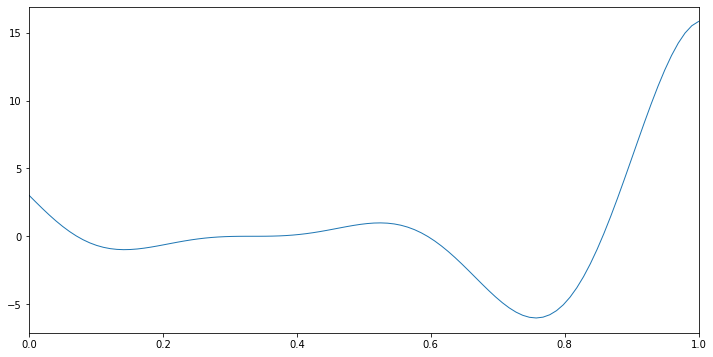

In [3]:
xx = np.linspace(0.0, 1.0, 100).reshape(100, 1)
plt.figure(figsize=(12, 6))
plt.plot(xx, forrester(xx), 'C0', linewidth=1)
plt.xlim(-0.0, 1.0)

In [4]:
def plot_gp(model, X, y, title):
    #Plotting code from GPflow authors

    ## generate test points for prediction
    xx = np.linspace(-0.1, 1.1, 100).reshape(100, 1)  # test points must be of shape (N, D)

    ## predict mean and variance of latent GP at test points
    mean, var = model.predict_f(xx)

    ## generate 10 samples from posterior
    samples = model.predict_f_samples(xx, 10)  # shape (10, 100, 1)

    ## plot 
    plt.figure(figsize=(12, 6))
    plt.plot(X, y, 'kx', mew=2)
    plt.plot(xx, mean, 'C0', lw=2)
    plt.fill_between(xx[:,0],
                     mean[:,0] - 1.96 * np.sqrt(var[:,0]),
                     mean[:,0] + 1.96 * np.sqrt(var[:,0]),
                     color='C0', alpha=0.2)

    plt.plot(xx, samples[:, :, 0].numpy().T, 'C0', linewidth=.5)
    plt.xlim(-0.1, 1.1)
    plt.title(title)

## 1.  Learning from ordinal data

In [5]:
# Sample data
X = np.array([[[0.2], [0.4]],
              [[0.4], [0.7]],
              [[0.76], [0.9]],
              [[0.9], [0.2]],
              [[0.7], [0.9]],
              [[0.2], [0.7]],
              [[0.7], [0.76]]])
y = forrester_get_y(X)

In [6]:
q_mu, q_sqrt, u, inputs, k = PBO.models.learning.train_model_fullcov(X, y, num_steps=5000)

Negative ELBO at step 0: 6.258733120307113
Negative ELBO at step 500: 4.976680911159001


KeyboardInterrupt: 

In [ ]:
q_mu

In [ ]:
print_summary(k)

Create sparse variational Gaussian process model using these parameters:

In [ ]:
# kernel = gpflow.kernels.RBF()
likelihood = gpflow.likelihoods.Gaussian()
model = PBO.models.learning.init_SVGP_fullcov(q_mu, q_sqrt, u, k, likelihood)

In [ ]:
print_summary(model)

Visualize the model so far:

In [ ]:
func_evals = q_mu.numpy()

In [ ]:
plot_gp(model, u, func_evals, "GP")

## 2. Predictive Entropy Search

In [13]:
num_runs = 10
num_evals = 20
num_samples = 100
num_choices = 2
input_dims = 1
num_maximizers = 20
num_init_points = 5
num_discrete_points = 10000 # Discretization of continuous input space

The following function captures what was done in the previous section, as we need to retrain the model after every evaluation.

In [14]:
def train_and_visualize(X, y, title):
    
    # Train model with data
    q_mu, q_sqrt, inputs, k = PBO.models.learning.train_model_fullcov(X, y, num_steps=15000)
    likelihood = gpflow.likelihoods.Gaussian()
    model = PBO.models.learning.init_SVGP_fullcov(q_mu, q_sqrt, inputs, k, likelihood)
    func_evals = q_mu.numpy()
    
    # Visualize model
    plot_gp(model, inputs, func_evals, title)
    
    return model, inputs, func_evals

This function is our main metric for the performance of the acquisition function: The closer the model's best guess to the target (in this case, the global minimum of the Forrester function), the better.

In [15]:
def best_guess(model):
    """
    Returns a GP model's best guess of the global maximum of f.
    """
    xx = np.linspace(0.0, 1.0, num_discrete_points).reshape(num_discrete_points, 1)
    res = model.predict_f(xx)[0].numpy()
    return xx[np.argmax(res)]

Store the results in these arrays:

In [16]:
num_data_at_end = int((num_init_points-1) * num_init_points / 2 + num_evals)
X_results = np.zeros([num_runs, num_data_at_end, num_choices, input_dims])
y_results = np.zeros([num_runs, num_data_at_end, 1])
best_guess_results = np.zeros([num_runs, num_evals, input_dims])

Create the initial values for each run:

In [17]:
np.random.seed(0)
init_points = np.random.uniform(size=[num_runs, num_init_points, input_dims])
num_combs = int((num_init_points-1) * num_init_points / 2)
init_vals = np.zeros([num_runs, num_combs, num_choices, input_dims])
for run in range(num_runs):
    cur_idx = 0
    for init_point in range(num_init_points-1):
        for next_point in range(init_point+1, num_init_points):
            init_vals[run, cur_idx, 0] = init_points[run, init_point]
            init_vals[run, cur_idx, 1] = init_points[run, next_point]
            cur_idx += 1

The following loops carry out the Bayesian optimization algorithm over a number of runs, with a fixed number of evaluations per run.

Beginning run 0
Negative ELBO at step 0: 340.9875250244252
Negative ELBO at step 500: 40.184430818515665
Negative ELBO at step 1000: 15.085685547081964
Negative ELBO at step 1500: 9.060927696572781
Negative ELBO at step 2000: 7.382636773479412
Negative ELBO at step 2500: 7.055366086356834
Negative ELBO at step 3000: 7.0220509109065645
Negative ELBO at step 3500: 7.015317536281074
Negative ELBO at step 4000: 7.009618558401377
Negative ELBO at step 4500: 7.003139308236202
Negative ELBO at step 5000: 6.9956658386336485
Negative ELBO at step 5500: 6.987115511180878
Negative ELBO at step 6000: 6.977350514514338
Negative ELBO at step 6500: 6.966115611105241
Negative ELBO at step 7000: 6.952996610919773
Negative ELBO at step 7500: 6.937432469173498
Negative ELBO at step 8000: 6.918810252434707
Negative ELBO at step 8500: 6.8966563094044195
Negative ELBO at step 9000: 6.87087278209874
Negative ELBO at step 9500: 6.841995711723445
Negative ELBO at step 10000: 6.811402737604286
Negative ELBO at 

Negative ELBO at step 500: 48.22285219350743
Negative ELBO at step 1000: 19.050918980540278
Negative ELBO at step 1500: 11.862641552485892
Negative ELBO at step 2000: 9.803295817538906
Negative ELBO at step 2500: 9.3816646114662
Negative ELBO at step 3000: 9.332231294386691
Negative ELBO at step 3500: 9.321283334495476
Negative ELBO at step 4000: 9.313416858831975
Negative ELBO at step 4500: 9.304672597965329
Negative ELBO at step 5000: 9.294329634864713
Negative ELBO at step 5500: 9.282170731696475
Negative ELBO at step 6000: 9.268010939774724
Negative ELBO at step 6500: 9.251645994399608
Negative ELBO at step 7000: 9.232866249471252
Negative ELBO at step 7500: 9.211534819534684
Negative ELBO at step 8000: 9.187759388071841
Negative ELBO at step 8500: 9.162131422656277
Negative ELBO at step 9000: 9.135913289765325
Negative ELBO at step 9500: 9.110988706121379
Negative ELBO at step 10000: 9.089461190237747
Negative ELBO at step 10500: 9.07298185944115
Negative ELBO at step 11000: 9.062

Negative ELBO at step 3500: 13.061933490504973
Negative ELBO at step 4000: 13.041549161619152
Negative ELBO at step 4500: 13.016271090772241
Negative ELBO at step 5000: 12.984567824797718
Negative ELBO at step 5500: 12.945115283530741
Negative ELBO at step 6000: 12.896586333524906
Negative ELBO at step 6500: 12.837832526894783
Negative ELBO at step 7000: 12.768260382308616
Negative ELBO at step 7500: 12.688404701194164
Negative ELBO at step 8000: 12.600593771720042
Negative ELBO at step 8500: 12.50936736020376
Negative ELBO at step 9000: 12.421110646975977
Negative ELBO at step 9500: 12.342541654770205
Negative ELBO at step 10000: 12.27859173709164
Negative ELBO at step 10500: 12.231217850210964
Negative ELBO at step 11000: 12.199586169054417
Negative ELBO at step 11500: 12.181157166120606
Negative ELBO at step 12000: 12.172352108089756
Negative ELBO at step 12500: 12.169211159934303
Negative ELBO at step 13000: 12.168371357822721
Negative ELBO at step 13500: 12.168245204051914
Negativ

Negative ELBO at step 7500: 15.670624843385557
Negative ELBO at step 8000: 15.62333271496405
Negative ELBO at step 8500: 15.567431734897154
Negative ELBO at step 9000: 15.500950535337472
Negative ELBO at step 9500: 15.422132747441042
Negative ELBO at step 10000: 15.330064496994346
Negative ELBO at step 10500: 15.22546246731783
Negative ELBO at step 11000: 15.111234414212202
Negative ELBO at step 11500: 14.992724843976616
Negative ELBO at step 12000: 14.87751890843427
Negative ELBO at step 12500: 14.77279467008607
Negative ELBO at step 13000: 14.684790540838247
Negative ELBO at step 13500: 14.618386172344557
Negative ELBO at step 14000: 14.572075159476721
Negative ELBO at step 14500: 14.543079596157408
Beginning evaluation 12
Evaluation 12: Sampling maximizers
[[0.68386839]
 [0.68476848]
 [0.68616862]
 [0.32233223]
 [0.33653365]
 [0.68016802]
 [0.32943294]
 [0.99989999]
 [0.69456946]
 [0.68716872]
 [0.30373037]
 [0.6979698 ]
 [0.2940294 ]
 [0.67436744]
 [0.6849685 ]
 [0.68176818]
 [0.34

Negative ELBO at step 12000: 18.9994379669376
Negative ELBO at step 12500: 18.93977012428278
Negative ELBO at step 13000: 18.90580447512214
Negative ELBO at step 13500: 18.88102362777881
Negative ELBO at step 14000: 18.856768211242454
Negative ELBO at step 14500: 18.830734581972298
Beginning evaluation 16
Evaluation 16: Sampling maximizers
[[0.66566657]
 [0.6719672 ]
 [0.66746675]
 [0.67136714]
 [0.67416742]
 [0.68166817]
 [0.18621862]
 [0.68626863]
 [0.65736574]
 [0.67476748]
 [0.66676668]
 [0.66746675]
 [0.17391739]
 [0.66836684]
 [0.67176718]
 [0.67046705]
 [0.67146715]
 [0.66736674]
 [0.67286729]
 [0.6689669 ]]
Evaluation 16: Calculating I
Evaluation 16: Next query is tf.Tensor(
[[0.4236548 ]
 [0.82573819]], shape=(2, 1), dtype=float64) with I value of 0.1265746658258103
Evaluation 16: Training model
Negative ELBO at step 0: 855496.4842715116
Negative ELBO at step 500: 28431.975226983486
Negative ELBO at step 1000: 9740.729451561443
Negative ELBO at step 1500: 4639.948151359395
Neg

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning run 1
Negative ELBO at step 0: 12.251705449285913
Negative ELBO at step 500: 7.589768764496433
Negative ELBO at step 1000: 6.89115015079885
Negative ELBO at step 1500: 6.762930307873161
Negative ELBO at step 2000: 6.725604829471466
Negative ELBO at step 2500: 6.720553815998203
Negative ELBO at step 3000: 6.720257645116319
Negative ELBO at step 3500: 6.7202168057605824
Negative ELBO at step 4000: 6.720193624897538
Negative ELBO at step 4500: 6.720181539610456
Negative ELBO at step 5000: 6.720176982516394
Negative ELBO at step 5500: 6.7201756845783915
Negative ELBO at step 6000: 6.720175458297009
Negative ELBO at step 6500: 6.7201754373232685
Negative ELBO at step 7000: 6.720175460351431
Negative ELBO at step 7500: 6.720175984722576
Negative ELBO at step 8000: 6.720175433589448
Negative ELBO at step 8500: 6.720175442631009
Negative ELBO at step 9000: 6.720175499374212
Negative ELBO at step 9500: 6.720175436688753
Negative ELBO at step 10000: 6.720175477814606
Negative ELBO at s

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 0
Evaluation 0: Sampling maximizers
[[9.28792879e-01]
 [7.41274127e-01]
 [5.73757376e-01]
 [6.86068607e-01]
 [6.93369337e-01]
 [2.56625663e-01]
 [7.06270627e-01]
 [7.19571957e-01]
 [7.23172317e-01]
 [1.85618562e-01]
 [1.43414341e-01]
 [6.64566457e-01]
 [5.62956296e-01]
 [5.97059706e-01]
 [6.72667267e-01]
 [7.24572457e-01]
 [6.04660466e-01]
 [6.38063806e-01]
 [4.00040004e-04]
 [6.22562256e-01]]
Evaluation 0: Calculating I
Evaluation 0: Next query is tf.Tensor(
[[0.96366276]
 [0.29257085]], shape=(2, 1), dtype=float64) with I value of 0.11026501746939359
Evaluation 0: Training model
Negative ELBO at step 0: 13.488860794008287
Negative ELBO at step 500: 8.276824212254844
Negative ELBO at step 1000: 7.410622056390025
Negative ELBO at step 1500: 7.233609108740993
Negative ELBO at step 2000: 7.182516363476491
Negative ELBO at step 2500: 7.173969230655606
Negative ELBO at step 3000: 7.172463301909994
Negative ELBO at step 3500: 7.171773215071858
Negative ELBO at step 4000

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 1
Evaluation 1: Sampling maximizers
[[3.74337434e-01]
 [1.30313031e-01]
 [5.82258226e-01]
 [5.80958096e-01]
 [3.05030503e-01]
 [9.86098610e-02]
 [4.76047605e-02]
 [1.03710371e-01]
 [1.00010001e-04]
 [6.05560556e-01]
 [1.80718072e-01]
 [7.77277728e-01]
 [6.84768477e-01]
 [2.78727873e-01]
 [5.61656166e-01]
 [7.22872287e-01]
 [1.73617362e-01]
 [6.51065107e-01]
 [5.81758176e-01]
 [5.83258326e-01]]
Evaluation 1: Calculating I
Evaluation 1: Next query is tf.Tensor(
[[0.64589411]
 [0.05029106]], shape=(2, 1), dtype=float64) with I value of 0.07577187707275489
Evaluation 1: Training model
Negative ELBO at step 0: 14.68001177887723
Negative ELBO at step 500: 8.929719146922572
Negative ELBO at step 1000: 7.943005289692916
Negative ELBO at step 1500: 7.765728003768988
Negative ELBO at step 2000: 7.7156964127015595
Negative ELBO at step 2500: 7.704624252489585
Negative ELBO at step 3000: 7.699445694407242
Negative ELBO at step 3500: 7.696104307499194
Negative ELBO at step 4000

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 2
Evaluation 2: Sampling maximizers
[[0.61676168]
 [0.80158016]
 [0.57225723]
 [0.73417342]
 [0.58555856]
 [0.38863886]
 [0.60516052]
 [0.66276628]
 [0.26662666]
 [0.28622862]
 [0.57685769]
 [0.71077108]
 [0.27792779]
 [0.32663266]
 [0.59905991]
 [0.56705671]
 [0.64126413]
 [0.25442544]
 [0.71177118]
 [0.72757276]]
Evaluation 2: Calculating I
Evaluation 2: Next query is tf.Tensor(
[[0.96366276]
 [0.34470218]], shape=(2, 1), dtype=float64) with I value of 0.12573234776215947
Evaluation 2: Training model
Negative ELBO at step 0: 19.402021444207
Negative ELBO at step 500: 10.05740593189285
Negative ELBO at step 1000: 8.728490536610156
Negative ELBO at step 1500: 8.473001768829679
Negative ELBO at step 2000: 8.39133885155115
Negative ELBO at step 2500: 8.303965709166592
Negative ELBO at step 3000: 8.207289729708073
Negative ELBO at step 3500: 8.119078450638899
Negative ELBO at step 4000: 8.057047813958814
Negative ELBO at step 4500: 8.024521226953048
Negative ELBO at s

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 3
Evaluation 3: Sampling maximizers
[[0.63086309]
 [0.38713871]
 [0.74837484]
 [0.68946895]
 [0.6979698 ]
 [0.6349635 ]
 [0.59685969]
 [0.59585959]
 [0.62556256]
 [0.59435944]
 [0.72037204]
 [0.29192919]
 [0.24182418]
 [0.28432843]
 [0.57725773]
 [0.2880288 ]
 [0.72577258]
 [0.63136314]
 [0.56085609]
 [0.70667067]]
Evaluation 3: Calculating I
Evaluation 3: Next query is tf.Tensor(
[[0.29257085]
 [0.75034319]], shape=(2, 1), dtype=float64) with I value of 0.07686430219932895
Evaluation 3: Training model
Negative ELBO at step 0: 20.600680542886128
Negative ELBO at step 500: 11.033448485387698
Negative ELBO at step 1000: 9.625070615086132
Negative ELBO at step 1500: 9.351951025952287
Negative ELBO at step 2000: 9.258779181738074
Negative ELBO at step 2500: 9.151623438693676
Negative ELBO at step 3000: 9.026229392532302
Negative ELBO at step 3500: 8.910860296297948
Negative ELBO at step 4000: 8.831734759897753
Negative ELBO at step 4500: 8.788598211483102
Negative ELBO

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 4
Evaluation 4: Sampling maximizers
[[7.04070407e-01]
 [6.12161216e-01]
 [3.01830183e-01]
 [6.11061106e-01]
 [3.63136314e-01]
 [6.44264426e-01]
 [6.90269027e-01]
 [3.86038604e-02]
 [2.87128713e-01]
 [6.41764176e-01]
 [3.14831483e-01]
 [6.36763676e-01]
 [6.77567757e-01]
 [3.66136614e-01]
 [6.99069907e-01]
 [6.34063406e-01]
 [3.90539054e-01]
 [3.40434043e-01]
 [6.23562356e-01]
 [2.00020002e-04]]
Evaluation 4: Calculating I
Evaluation 4: Next query is tf.Tensor(
[[0.75034319]
 [0.26024658]], shape=(2, 1), dtype=float64) with I value of 0.08537094596380448
Evaluation 4: Training model
Negative ELBO at step 0: 27.60312620130946
Negative ELBO at step 500: 12.062794656292922
Negative ELBO at step 1000: 10.531607134839811
Negative ELBO at step 1500: 10.150517863293917
Negative ELBO at step 2000: 10.049536789574079
Negative ELBO at step 2500: 9.976887036167623
Negative ELBO at step 3000: 9.890024820454963
Negative ELBO at step 3500: 9.784828707794901
Negative ELBO at step 4

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 5
Evaluation 5: Sampling maximizers
[[0.39763976]
 [0.64356436]
 [0.72557256]
 [0.619962  ]
 [0.64336434]
 [0.56915692]
 [0.3870387 ]
 [0.70647065]
 [0.44394439]
 [0.66436644]
 [0.71257126]
 [0.72177218]
 [0.71557156]
 [0.6079608 ]
 [0.63326333]
 [0.70967097]
 [0.61956196]
 [0.6889689 ]
 [0.64826483]
 [0.07580758]]
Evaluation 5: Calculating I
Evaluation 5: Next query is tf.Tensor(
[[0.26024658]
 [0.79525281]], shape=(2, 1), dtype=float64) with I value of 0.09510439760093763
Evaluation 5: Training model
Negative ELBO at step 0: 29.377077269492098
Negative ELBO at step 500: 12.80338506486917
Negative ELBO at step 1000: 11.205031499151744
Negative ELBO at step 1500: 10.804214501797317
Negative ELBO at step 2000: 10.689417168539805
Negative ELBO at step 2500: 10.60658855190944
Negative ELBO at step 3000: 10.512603374510213
Negative ELBO at step 3500: 10.404644234121173
Negative ELBO at step 4000: 10.287073173311931
Negative ELBO at step 4500: 10.171690624455408
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 6
Evaluation 6: Sampling maximizers
[[0.36013601]
 [0.59245925]
 [0.72737274]
 [0.6749675 ]
 [0.4350435 ]
 [0.66606661]
 [0.67346735]
 [0.65886589]
 [0.65486549]
 [0.71907191]
 [0.66366637]
 [0.65216522]
 [0.70577058]
 [0.72807281]
 [0.67746775]
 [0.32553255]
 [0.65256526]
 [0.61786179]
 [0.64806481]
 [0.6739674 ]]
Evaluation 6: Calculating I
Evaluation 6: Next query is tf.Tensor(
[[0.26024658]
 [0.79930564]], shape=(2, 1), dtype=float64) with I value of 0.10241663320931792
Evaluation 6: Training model
Negative ELBO at step 0: 513.6377468943318
Negative ELBO at step 500: 58.40990901217238
Negative ELBO at step 1000: 23.723590840066375
Negative ELBO at step 1500: 15.067104639281684
Negative ELBO at step 2000: 12.462337391932063
Negative ELBO at step 2500: 11.85050362943677
Negative ELBO at step 3000: 11.775023314987475
Negative ELBO at step 3500: 11.758253988880218
Negative ELBO at step 4000: 11.74039123699686
Negative ELBO at step 4500: 11.718431772178555
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 7
Evaluation 7: Sampling maximizers
[[0.69946995]
 [0.70047005]
 [0.75047505]
 [0.73027303]
 [0.75107511]
 [0.72587259]
 [0.74217422]
 [0.37733773]
 [0.71827183]
 [0.73107311]
 [0.77327733]
 [0.70557056]
 [0.70957096]
 [0.68246825]
 [0.73267327]
 [0.71907191]
 [0.7219722 ]
 [0.31643164]
 [0.75317532]
 [0.68626863]]
Evaluation 7: Calculating I
Evaluation 7: Next query is tf.Tensor(
[[0.79525281]
 [0.59275958]], shape=(2, 1), dtype=float64) with I value of 0.06796419435575876
Evaluation 7: Training model
Negative ELBO at step 0: 518.4054877726924
Negative ELBO at step 500: 59.50700720885844
Negative ELBO at step 1000: 24.483307617629176
Negative ELBO at step 1500: 15.73000453383262
Negative ELBO at step 2000: 13.10831169239589
Negative ELBO at step 2500: 12.499538929282116
Negative ELBO at step 3000: 12.428455363635122
Negative ELBO at step 3500: 12.416093343553305
Negative ELBO at step 4000: 12.403385788012912
Negative ELBO at step 4500: 12.387502496559396
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 8
Evaluation 8: Sampling maximizers
[[0.7239724 ]
 [0.72457246]
 [0.72667267]
 [0.73137314]
 [0.77637764]
 [0.72867287]
 [0.75487549]
 [0.74627463]
 [0.77247725]
 [0.76117612]
 [0.77827783]
 [0.73557356]
 [0.749975  ]
 [0.76077608]
 [0.74557456]
 [0.73037304]
 [0.75367537]
 [0.71537154]
 [0.77957796]
 [0.56375638]]
Evaluation 8: Calculating I
Evaluation 8: Next query is tf.Tensor(
[[0.79525281]
 [0.61076559]], shape=(2, 1), dtype=float64) with I value of 0.0711887812110527
Evaluation 8: Training model
Negative ELBO at step 0: 560.6770746667819
Negative ELBO at step 500: 63.22423584664341
Negative ELBO at step 1000: 25.723470899654014
Negative ELBO at step 1500: 16.461300650966898
Negative ELBO at step 2000: 13.708841523349587
Negative ELBO at step 2500: 13.061794654615705
Negative ELBO at step 3000: 12.979067782653598
Negative ELBO at step 3500: 12.963980261763876
Negative ELBO at step 4000: 12.953090047866715
Negative ELBO at step 4500: 12.94134276806788
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 9
Evaluation 9: Sampling maximizers
[[0.78827883]
 [0.73267327]
 [0.73817382]
 [0.76587659]
 [0.74657466]
 [0.77957796]
 [0.2970297 ]
 [0.74227423]
 [0.75857586]
 [0.74687469]
 [0.75527553]
 [0.75947595]
 [0.74807481]
 [0.76587659]
 [0.73267327]
 [0.77817782]
 [0.7769777 ]
 [0.78307831]
 [0.78747875]
 [0.76317632]]
Evaluation 9: Calculating I
Evaluation 9: Next query is tf.Tensor(
[[0.64589411]
 [0.8175088 ]], shape=(2, 1), dtype=float64) with I value of 0.07176088460798286
Evaluation 9: Training model
Negative ELBO at step 0: 11035.163918286677
Negative ELBO at step 500: 720.8427094472446
Negative ELBO at step 1000: 225.48410520906015
Negative ELBO at step 1500: 95.26631621061655
Negative ELBO at step 2000: 46.45466859215077
Negative ELBO at step 2500: 26.325362779240784
Negative ELBO at step 3000: 18.51069241936063
Negative ELBO at step 3500: 15.98594427500597
Negative ELBO at step 4000: 15.337594027614493
Negative ELBO at step 4500: 15.145987636973121
Negative E

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 10
Evaluation 10: Sampling maximizers
[[0.83188319]
 [0.11561156]
 [0.84308431]
 [0.80668067]
 [0.82908291]
 [0.81338134]
 [0.1960196 ]
 [0.82568257]
 [0.82378238]
 [0.40224022]
 [0.15921592]
 [0.60556056]
 [0.62926293]
 [0.81338134]
 [0.83278328]
 [0.13271327]
 [0.82778278]
 [0.82518252]
 [0.81248125]
 [0.09470947]]
Evaluation 10: Calculating I
Evaluation 10: Next query is tf.Tensor(
[[0.75034319]
 [0.85885691]], shape=(2, 1), dtype=float64) with I value of 0.08717308685095863
Evaluation 10: Training model
Negative ELBO at step 0: 42419.71178879892
Negative ELBO at step 500: 2143.145302617704
Negative ELBO at step 1000: 684.4001786159185
Negative ELBO at step 1500: 299.7046404830209
Negative ELBO at step 2000: 147.82198465158893
Negative ELBO at step 2500: 77.70310550509384
Negative ELBO at step 3000: 44.16449988868412
Negative ELBO at step 3500: 29.02381209921061
Negative ELBO at step 4000: 23.023228526701818
Negative ELBO at step 4500: 20.892595933212878
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 11
Evaluation 11: Sampling maximizers
[[0.82958296]
 [0.82528253]
 [0.81568157]
 [0.70347035]
 [0.82818282]
 [0.33163316]
 [0.36383638]
 [0.8159816 ]
 [0.83028303]
 [0.        ]
 [0.81758176]
 [0.1550155 ]
 [0.82478248]
 [0.22522252]
 [0.13811381]
 [0.83248325]
 [0.83268327]
 [0.83028303]
 [0.82888289]
 [0.81978198]]
Evaluation 11: Calculating I
Evaluation 11: Next query is tf.Tensor(
[[0.891773  ]
 [0.07923703]], shape=(2, 1), dtype=float64) with I value of 0.21199978645305453
Evaluation 11: Training model
Negative ELBO at step 0: 42422.788837891974
Negative ELBO at step 500: 2144.046436358048
Negative ELBO at step 1000: 685.1616925896282
Negative ELBO at step 1500: 300.43012353498824
Negative ELBO at step 2000: 148.5343144355873
Negative ELBO at step 2500: 78.41176440394992
Negative ELBO at step 3000: 44.87385383436117
Negative ELBO at step 3500: 29.735347653771512
Negative ELBO at step 4000: 23.73718624124013
Negative ELBO at step 4500: 21.60878872535944
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 12
Evaluation 12: Sampling maximizers
[[0.81258126]
 [0.82868287]
 [0.83028303]
 [0.82218222]
 [0.82618262]
 [0.2070207 ]
 [0.82048205]
 [0.82978298]
 [0.81928193]
 [0.82028203]
 [0.82628263]
 [0.8149815 ]
 [0.67516752]
 [0.        ]
 [0.8219822 ]
 [0.81218122]
 [0.14461446]
 [0.82628263]
 [0.82108211]
 [0.34273427]]
Evaluation 12: Calculating I
Evaluation 12: Next query is tf.Tensor(
[[0.85885691]
 [0.76836114]], shape=(2, 1), dtype=float64) with I value of 0.09957863073259324
Evaluation 12: Training model
Negative ELBO at step 0: 749353.2300500217
Negative ELBO at step 500: 29221.19150112636
Negative ELBO at step 1000: 9375.240169251401
Negative ELBO at step 1500: 4172.07466660465
Negative ELBO at step 2000: 2084.958953729092
Negative ELBO at step 2500: 1080.8863031702645
Negative ELBO at step 3000: 556.0763738939307
Negative ELBO at step 3500: 276.54379212152617
Negative ELBO at step 4000: 133.5613337372285
Negative ELBO at step 4500: 67.73004949658012
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 13
Evaluation 13: Sampling maximizers
[[0.81878188]
 [0.82228223]
 [0.61946195]
 [0.82038204]
 [0.82058206]
 [0.17481748]
 [0.82518252]
 [0.82858286]
 [0.81058106]
 [0.81848185]
 [0.81638164]
 [0.619962  ]
 [0.83008301]
 [0.6319632 ]
 [0.13891389]
 [0.82478248]
 [0.82138214]
 [0.81568157]
 [0.81108111]
 [0.76337634]]
Evaluation 13: Calculating I
Evaluation 13: Next query is tf.Tensor(
[[0.85885691]
 [0.74364272]], shape=(2, 1), dtype=float64) with I value of 0.09410338815478822
Evaluation 13: Training model
Negative ELBO at step 0: 5492251.15036735
Negative ELBO at step 500: 162671.90320412614
Negative ELBO at step 1000: 51548.396955941826
Negative ELBO at step 1500: 22991.173621660986
Negative ELBO at step 2000: 11625.798535167087
Negative ELBO at step 2500: 6190.578422794618
Negative ELBO at step 3000: 3366.163512431606
Negative ELBO at step 3500: 1863.921302560818
Negative ELBO at step 4000: 1082.0109466482693
Negative ELBO at step 4500: 695.7789001124563
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 14
Evaluation 14: Sampling maximizers
[[0.82468247]
 [0.13061306]
 [0.76067607]
 [0.61456146]
 [0.82828283]
 [0.49154915]
 [0.8019802 ]
 [0.76767677]
 [0.13531353]
 [0.81368137]
 [0.3470347 ]
 [0.80288029]
 [0.5119512 ]
 [0.81328133]
 [0.81248125]
 [0.82858286]
 [0.61446145]
 [0.06070607]
 [0.75977598]
 [0.81158116]]
Evaluation 14: Calculating I
Evaluation 14: Next query is tf.Tensor(
[[0.74364272]
 [0.83449843]], shape=(2, 1), dtype=float64) with I value of 0.09026092814568697
Evaluation 14: Training model
Negative ELBO at step 0: 87894119.40084939
Negative ELBO at step 500: 2193285.056846627
Negative ELBO at step 1000: 705334.14700945
Negative ELBO at step 1500: 324770.134982843
Negative ELBO at step 2000: 171337.91615854643
Negative ELBO at step 2500: 95779.47070045385
Negative ELBO at step 3000: 54471.557663807536
Negative ELBO at step 3500: 30678.612979876416
Negative ELBO at step 4000: 16785.985376018918
Negative ELBO at step 4500: 8859.322630009337
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 15
Evaluation 15: Sampling maximizers
[[0.40924092]
 [0.        ]
 [0.47974797]
 [0.20752075]
 [0.09670967]
 [0.1540154 ]
 [0.40164016]
 [0.15311531]
 [0.6309631 ]
 [0.64176418]
 [0.74977498]
 [0.20312031]
 [0.67676768]
 [0.68306831]
 [0.3990399 ]
 [0.76557656]
 [0.        ]
 [0.18921892]
 [0.68866887]
 [0.75917592]]
Evaluation 15: Calculating I
Evaluation 15: Next query is tf.Tensor(
[[0.07923703]
 [0.2420439 ]], shape=(2, 1), dtype=float64) with I value of 0.16163443224300225
Evaluation 15: Training model
Negative ELBO at step 0: 87894557.675804
Negative ELBO at step 500: 2193301.740698997
Negative ELBO at step 1000: 705339.4685186959
Negative ELBO at step 1500: 324772.9647414389
Negative ELBO at step 2000: 171339.8118235253
Negative ELBO at step 2500: 95780.9375964185
Negative ELBO at step 3000: 54472.82694554865
Negative ELBO at step 3500: 30679.790661884148
Negative ELBO at step 4000: 16787.122900849394
Negative ELBO at step 4500: 8860.461808379961
Negative EL

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 16
Evaluation 16: Sampling maximizers
[[0.65206521]
 [0.17251725]
 [0.64786479]
 [0.1070107 ]
 [0.68286829]
 [0.20522052]
 [0.13631363]
 [0.53875388]
 [0.67986799]
 [0.76827683]
 [0.06690669]
 [0.6629663 ]
 [0.52015202]
 [0.75007501]
 [0.7569757 ]
 [0.65106511]
 [0.16471647]
 [0.61276128]
 [0.36643664]
 [0.67606761]]
Evaluation 16: Calculating I
Evaluation 16: Next query is tf.Tensor(
[[0.59275958]
 [0.08510591]], shape=(2, 1), dtype=float64) with I value of 0.16779053874783212
Evaluation 16: Training model
Negative ELBO at step 0: 87894954.51080045
Negative ELBO at step 500: 2193338.5460124174
Negative ELBO at step 1000: 705346.516208855
Negative ELBO at step 1500: 324774.3112462034
Negative ELBO at step 2000: 171340.6516793636
Negative ELBO at step 2500: 95781.87709461155
Negative ELBO at step 3000: 54473.82524570179
Negative ELBO at step 3500: 30680.783542682995
Negative ELBO at step 4000: 16788.092038383522
Negative ELBO at step 4500: 8861.385172043027
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 17
Evaluation 17: Sampling maximizers
[[0.75267527]
 [0.66376638]
 [0.35323532]
 [0.76017602]
 [0.75337534]
 [0.        ]
 [0.15751575]
 [0.52415242]
 [0.16221622]
 [0.52025203]
 [0.68286829]
 [0.76167617]
 [0.16911691]
 [0.67566757]
 [0.        ]
 [0.48524852]
 [0.66026603]
 [0.69206921]
 [0.11621162]
 [0.67626763]]
Evaluation 17: Calculating I
Evaluation 17: Next query is tf.Tensor(
[[0.34470218]
 [0.53505456]], shape=(2, 1), dtype=float64) with I value of 0.08816321763581003
Evaluation 17: Training model
Negative ELBO at step 0: 91955904.3835458
Negative ELBO at step 500: 2277049.019412303
Negative ELBO at step 1000: 734775.6171204491
Negative ELBO at step 1500: 338969.11035475036
Negative ELBO at step 2000: 179050.95281045654
Negative ELBO at step 2500: 100177.72445618804
Negative ELBO at step 3000: 57006.645058309055
Negative ELBO at step 3500: 32117.05942116114
Negative ELBO at step 4000: 17572.836465260792
Negative ELBO at step 4500: 9268.977234443148
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 18
Evaluation 18: Sampling maximizers
[[0.65926593]
 [0.67926793]
 [0.75527553]
 [0.7539754 ]
 [0.74687469]
 [0.75907591]
 [0.76667667]
 [0.35413541]
 [0.16941694]
 [0.71787179]
 [0.68076808]
 [0.79967997]
 [0.67446745]
 [0.66786679]
 [0.        ]
 [0.33943394]
 [0.76337634]
 [0.41984198]
 [0.68206821]
 [0.34943494]]
Evaluation 18: Calculating I
Evaluation 18: Next query is tf.Tensor(
[[0.75034319]
 [0.15775159]], shape=(2, 1), dtype=float64) with I value of 0.07343282245599327
Evaluation 18: Training model
Negative ELBO at step 0: 91957369.38755126
Negative ELBO at step 500: 2277099.126948101
Negative ELBO at step 1000: 734791.8442741933
Negative ELBO at step 1500: 338975.85106485325
Negative ELBO at step 2000: 179054.17761849044
Negative ELBO at step 2500: 100179.57892014679
Negative ELBO at step 3000: 57007.92639508004
Negative ELBO at step 3500: 32118.04610902737
Negative ELBO at step 4000: 17573.68842603484
Negative ELBO at step 4500: 9269.790021891244
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 19
Evaluation 19: Sampling maximizers
[[0.10181018]
 [0.7559756 ]
 [0.24312431]
 [0.12421242]
 [0.75477548]
 [0.63936394]
 [0.75427543]
 [0.81318132]
 [0.75877588]
 [0.66206621]
 [0.669967  ]
 [0.82328233]
 [0.48154815]
 [0.67236724]
 [0.67916792]
 [0.75807581]
 [0.53655366]
 [0.67906791]
 [0.69026903]
 [0.6629663 ]]
Evaluation 19: Calculating I
Evaluation 19: Next query is tf.Tensor(
[[0.83449843]
 [0.61605405]], shape=(2, 1), dtype=float64) with I value of 0.07345516793477003
Evaluation 19: Training model
Negative ELBO at step 0: 128033814.4620405
Negative ELBO at step 500: 2956652.4805537355
Negative ELBO at step 1000: 964707.7752753296
Negative ELBO at step 1500: 451147.25001347554
Negative ELBO at step 2000: 242353.57386383056
Negative ELBO at step 2500: 138585.09882720246
Negative ELBO at step 3000: 81215.15074523058
Negative ELBO at step 3500: 47657.415382055166
Negative ELBO at step 4000: 27597.605429726947
Negative ELBO at step 4500: 15702.587291248261
Neg

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning run 2
Negative ELBO at step 0: 12.700568440868688
Negative ELBO at step 500: 7.7647972688271985
Negative ELBO at step 1000: 7.100133871975025
Negative ELBO at step 1500: 7.056319482785753
Negative ELBO at step 2000: 7.036348776389166
Negative ELBO at step 2500: 7.016038496210232
Negative ELBO at step 3000: 6.996824138933466
Negative ELBO at step 3500: 6.98009705946626
Negative ELBO at step 4000: 6.966653374291237
Negative ELBO at step 4500: 6.956532729893405
Negative ELBO at step 5000: 6.949247963236347
Negative ELBO at step 5500: 6.94413075408099
Negative ELBO at step 6000: 6.940565415732647
Negative ELBO at step 6500: 6.938074709871965
Negative ELBO at step 7000: 6.936319471814973
Negative ELBO at step 7500: 6.935067888613181
Negative ELBO at step 8000: 6.934164802842858
Negative ELBO at step 8500: 6.933504899809964
Negative ELBO at step 9000: 6.9330176742548755
Negative ELBO at step 9500: 6.932653686170594
Negative ELBO at step 10000: 6.932380234803457
Negative ELBO at ste

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 0
Evaluation 0: Sampling maximizers
[[0.31813181]
 [0.25672567]
 [0.62676268]
 [0.13771377]
 [0.        ]
 [0.26582658]
 [0.37013701]
 [0.48654865]
 [0.87238724]
 [0.23922392]
 [0.21462146]
 [0.23022302]
 [0.74427443]
 [0.00870087]
 [0.47454745]
 [0.87678768]
 [0.75387539]
 [0.1240124 ]
 [0.18491849]
 [0.49064906]]
Evaluation 0: Calculating I
Evaluation 0: Next query is tf.Tensor(
[[0.07103606]
 [0.21567557]], shape=(2, 1), dtype=float64) with I value of 0.040508049519060785
Evaluation 0: Training model
Negative ELBO at step 0: 13.892817626133638
Negative ELBO at step 500: 8.737978254171487
Negative ELBO at step 1000: 8.010489481811488
Negative ELBO at step 1500: 7.93794596442763
Negative ELBO at step 2000: 7.887989374427014
Negative ELBO at step 2500: 7.8380661166295695
Negative ELBO at step 3000: 7.792410135791238
Negative ELBO at step 3500: 7.75393707421947
Negative ELBO at step 4000: 7.7234584341989585
Negative ELBO at step 4500: 7.700184039842906
Negative ELBO

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 1
Evaluation 1: Sampling maximizers
[[0.60726073]
 [0.99849985]
 [0.95459546]
 [0.99769977]
 [0.39213921]
 [0.69376938]
 [0.99909991]
 [0.35433543]
 [0.43494349]
 [0.75677568]
 [0.99989999]
 [0.43854385]
 [0.62186219]
 [0.11241124]
 [0.72807281]
 [0.03270327]
 [0.2860286 ]
 [0.69936994]
 [0.64386439]
 [0.62346235]]
Evaluation 1: Calculating I
Evaluation 1: Next query is tf.Tensor(
[[0.56804456]
 [0.97916101]], shape=(2, 1), dtype=float64) with I value of 0.034947908155474015
Evaluation 1: Training model
Negative ELBO at step 0: 15.355565118546332
Negative ELBO at step 500: 9.609411686670873
Negative ELBO at step 1000: 8.749079687818304
Negative ELBO at step 1500: 8.649484475655713
Negative ELBO at step 2000: 8.600233648371827
Negative ELBO at step 2500: 8.556210581647102
Negative ELBO at step 3000: 8.513603806676958
Negative ELBO at step 3500: 8.474203181196653
Negative ELBO at step 4000: 8.440235716513467
Negative ELBO at step 4500: 8.412587037839614
Negative ELBO

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 2
Evaluation 2: Sampling maximizers
[[0.15991599]
 [0.14231423]
 [0.75317532]
 [0.63366337]
 [0.62836284]
 [0.45454545]
 [0.47514751]
 [0.30633063]
 [0.75507551]
 [0.44754475]
 [0.12291229]
 [0.27282728]
 [0.02010201]
 [0.7049705 ]
 [0.02490249]
 [0.73947395]
 [0.47724772]
 [0.00460046]
 [0.14361436]
 [0.66286629]]
Evaluation 2: Calculating I
Evaluation 2: Next query is tf.Tensor(
[[0.52889492]
 [0.87138102]], shape=(2, 1), dtype=float64) with I value of 0.03985699694455754
Evaluation 2: Training model
Negative ELBO at step 0: 17.26135885801375
Negative ELBO at step 500: 10.607825209210628
Negative ELBO at step 1000: 9.592719905021092
Negative ELBO at step 1500: 9.445455236460356
Negative ELBO at step 2000: 9.377094684914516
Negative ELBO at step 2500: 9.319588233470798
Negative ELBO at step 3000: 9.266651064878552
Negative ELBO at step 3500: 9.21744310178077
Negative ELBO at step 4000: 9.173942727972248
Negative ELBO at step 4500: 9.137707189971326
Negative ELBO a

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 3
Evaluation 3: Sampling maximizers
[[1.76917692e-01]
 [6.00060006e-04]
 [1.67516752e-01]
 [1.11711171e-01]
 [3.53435344e-01]
 [6.43264326e-01]
 [4.17641764e-01]
 [6.33263326e-01]
 [6.46064606e-01]
 [2.20022002e-03]
 [3.78337834e-01]
 [6.95169517e-01]
 [3.78137814e-01]
 [7.34073407e-01]
 [6.48064806e-01]
 [6.72867287e-01]
 [1.72717272e-01]
 [3.40234023e-01]
 [8.31883188e-01]
 [6.66266627e-01]]
Evaluation 3: Calculating I
Evaluation 3: Next query is tf.Tensor(
[[0.97916101]
 [0.74693603]], shape=(2, 1), dtype=float64) with I value of 0.0346212301129772
Evaluation 3: Training model
Negative ELBO at step 0: 19.169120747386177
Negative ELBO at step 500: 11.34803688549018
Negative ELBO at step 1000: 10.131546006748557
Negative ELBO at step 1500: 9.922338134308646
Negative ELBO at step 2000: 9.849370882369639
Negative ELBO at step 2500: 9.808195996302846
Negative ELBO at step 3000: 9.781896329432598
Negative ELBO at step 3500: 9.761479668366041
Negative ELBO at step 4000

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 4
Evaluation 4: Sampling maximizers
[[7.00070007e-04]
 [4.21442144e-01]
 [1.03010301e-02]
 [1.00000000e+00]
 [6.69866987e-01]
 [3.45834583e-01]
 [4.23342334e-01]
 [2.61726173e-01]
 [7.63676368e-01]
 [3.29632963e-01]
 [7.46574657e-01]
 [2.75127513e-01]
 [6.84668467e-01]
 [4.05140514e-01]
 [4.29442944e-01]
 [3.18431843e-01]
 [6.86268627e-01]
 [4.56745675e-01]
 [6.63866387e-01]
 [6.46264626e-01]]
Evaluation 4: Calculating I
Evaluation 4: Next query is tf.Tensor(
[[0.74693603]
 [0.40093997]], shape=(2, 1), dtype=float64) with I value of 0.04018042351170932
Evaluation 4: Training model
Negative ELBO at step 0: 20.364390649845333
Negative ELBO at step 500: 12.048444954559574
Negative ELBO at step 1000: 10.70417835323955
Negative ELBO at step 1500: 10.467099754746425
Negative ELBO at step 2000: 10.394745860161844
Negative ELBO at step 2500: 10.363587541514349
Negative ELBO at step 3000: 10.349122174082328
Negative ELBO at step 3500: 10.339632628460187
Negative ELBO at ste

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 5
Evaluation 5: Sampling maximizers
[[3.41034103e-02]
 [6.60866087e-01]
 [7.40874087e-01]
 [7.15671567e-01]
 [7.25972597e-01]
 [6.78567857e-01]
 [1.54615462e-01]
 [2.69026903e-02]
 [0.00000000e+00]
 [7.11371137e-01]
 [3.00030003e-03]
 [2.67026703e-01]
 [7.43374337e-01]
 [1.00010001e-04]
 [1.71517152e-01]
 [2.73327333e-01]
 [3.08630863e-01]
 [1.53915392e-01]
 [6.73767377e-01]
 [6.50965097e-01]]
Evaluation 5: Calculating I
Evaluation 5: Next query is tf.Tensor(
[[0.97916101]
 [0.27664356]], shape=(2, 1), dtype=float64) with I value of 0.05097843652260889
Evaluation 5: Training model
Negative ELBO at step 0: 21.719531480903193
Negative ELBO at step 500: 12.760280493150868
Negative ELBO at step 1000: 11.28574255197646
Negative ELBO at step 1500: 10.99555207782733
Negative ELBO at step 2000: 10.906132020036189
Negative ELBO at step 2500: 10.87329996560324
Negative ELBO at step 3000: 10.862918737179925
Negative ELBO at step 3500: 10.858662220564604
Negative ELBO at step 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 6
Evaluation 6: Sampling maximizers
[[0.00000000e+00]
 [2.60726073e-01]
 [2.50225023e-01]
 [0.00000000e+00]
 [7.25872587e-01]
 [8.44384438e-01]
 [1.40014001e-01]
 [2.38923892e-01]
 [1.61616162e-01]
 [1.27612761e-01]
 [3.47934793e-01]
 [3.32933293e-01]
 [1.00010001e-04]
 [3.37433743e-01]
 [2.00620062e-01]
 [6.96869687e-01]
 [7.02270227e-01]
 [2.50925093e-01]
 [6.49164916e-01]
 [3.26932693e-01]]
Evaluation 6: Calculating I
Evaluation 6: Next query is tf.Tensor(
[[0.40093997]
 [0.25975365]], shape=(2, 1), dtype=float64) with I value of 0.05466165936986621
Evaluation 6: Training model
Negative ELBO at step 0: 42.446037120335724
Negative ELBO at step 500: 15.218571668336836
Negative ELBO at step 1000: 12.861812564668385
Negative ELBO at step 1500: 12.333539596900069
Negative ELBO at step 2000: 12.144771863307229
Negative ELBO at step 2500: 12.001044826251652
Negative ELBO at step 3000: 11.8584568826195
Negative ELBO at step 3500: 11.726662922960859
Negative ELBO at step

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 7
Evaluation 7: Sampling maximizers
[[7.32873287e-01]
 [7.28372837e-01]
 [6.82968297e-01]
 [1.39413941e-01]
 [7.04370437e-01]
 [6.57165717e-01]
 [2.79927993e-01]
 [6.36563656e-01]
 [2.49024902e-01]
 [7.50675068e-01]
 [6.87668767e-01]
 [2.00020002e-04]
 [8.24982498e-01]
 [7.38073807e-01]
 [6.97369737e-01]
 [7.45974597e-01]
 [2.52725273e-01]
 [2.52925293e-01]
 [6.93669367e-01]
 [7.41674167e-01]]
Evaluation 7: Calculating I
Evaluation 7: Next query is tf.Tensor(
[[0.27664356]
 [0.66070096]], shape=(2, 1), dtype=float64) with I value of 0.05538162836080838
Evaluation 7: Training model
Negative ELBO at step 0: 43.86085398487651
Negative ELBO at step 500: 16.290624817415047
Negative ELBO at step 1000: 13.90459889517139
Negative ELBO at step 1500: 13.345024576548237
Negative ELBO at step 2000: 13.130444016450864
Negative ELBO at step 2500: 12.957190284113894
Negative ELBO at step 3000: 12.779197673145685
Negative ELBO at step 3500: 12.608779119795894
Negative ELBO at step

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 8
Evaluation 8: Sampling maximizers
[[0.25312531]
 [0.71307131]
 [0.6979698 ]
 [0.71737174]
 [0.70057006]
 [0.69366937]
 [0.36443644]
 [0.11121112]
 [0.98649865]
 [0.71567157]
 [0.66556656]
 [0.77257726]
 [0.77017702]
 [0.23572357]
 [0.70647065]
 [0.67286729]
 [0.71717172]
 [0.25652565]
 [0.        ]
 [0.24192419]]
Evaluation 8: Calculating I
Evaluation 8: Next query is tf.Tensor(
[[0.87138102]
 [0.4025151 ]], shape=(2, 1), dtype=float64) with I value of 0.14007354292244006
Evaluation 8: Training model
Negative ELBO at step 0: 1119.6550717334244
Negative ELBO at step 500: 148.76241853097684
Negative ELBO at step 1000: 46.20782532451557
Negative ELBO at step 1500: 22.075250828165018
Negative ELBO at step 2000: 15.737049391418607
Negative ELBO at step 2500: 14.686221895876349
Negative ELBO at step 3000: 14.625434149368324
Negative ELBO at step 3500: 14.60735441122749
Negative ELBO at step 4000: 14.585050430323511
Negative ELBO at step 4500: 14.556709391936682
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 9
Evaluation 9: Sampling maximizers
[[0.00000000e+00]
 [7.05470547e-01]
 [6.62166217e-01]
 [7.02570257e-01]
 [7.49574957e-01]
 [2.64326433e-01]
 [7.18771877e-01]
 [2.49524952e-01]
 [2.85528553e-01]
 [2.06220622e-01]
 [7.17871787e-01]
 [3.00030003e-04]
 [6.95869587e-01]
 [2.47324732e-01]
 [7.22872287e-01]
 [7.14171417e-01]
 [1.96719672e-01]
 [7.01070107e-01]
 [7.37673767e-01]
 [6.95269527e-01]]
Evaluation 9: Calculating I
Evaluation 9: Next query is tf.Tensor(
[[0.27664356]
 [0.69786398]], shape=(2, 1), dtype=float64) with I value of 0.052298485581530385
Evaluation 9: Training model
Negative ELBO at step 0: 1126.639164210721
Negative ELBO at step 500: 149.89693093257617
Negative ELBO at step 1000: 47.03644357656385
Negative ELBO at step 1500: 22.850192408663318
Negative ELBO at step 2000: 16.51167415167952
Negative ELBO at step 2500: 15.46708451561629
Negative ELBO at step 3000: 15.404730729520164
Negative ELBO at step 3500: 15.382966598780673
Negative ELBO at step 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 10
Evaluation 10: Sampling maximizers
[[0.69006901]
 [0.13561356]
 [0.7049705 ]
 [0.70987099]
 [0.6929693 ]
 [0.07390739]
 [0.72277228]
 [0.6959696 ]
 [0.6929693 ]
 [0.70057006]
 [0.70887089]
 [0.6909691 ]
 [0.69666967]
 [0.70287029]
 [0.28872887]
 [0.41824182]
 [0.        ]
 [0.64676468]
 [0.7939794 ]
 [0.72867287]]
Evaluation 10: Calculating I
Evaluation 10: Next query is tf.Tensor(
[[0.56804456]
 [0.54164229]], shape=(2, 1), dtype=float64) with I value of 0.16162375655167882
Evaluation 10: Training model
Negative ELBO at step 0: 1300.4308156977318
Negative ELBO at step 500: 165.70479712344954
Negative ELBO at step 1000: 51.58255647560887
Negative ELBO at step 1500: 24.33729294392931
Negative ELBO at step 2000: 17.248306094581473
Negative ELBO at step 2500: 16.09330648099759
Negative ELBO at step 3000: 16.021891813680394
Negative ELBO at step 3500: 16.002882281173648
Negative ELBO at step 4000: 15.981280110117636
Negative ELBO at step 4500: 15.95420936540241
Nega

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 11
Evaluation 11: Sampling maximizers
[[0.25612561]
 [0.72177218]
 [0.73257326]
 [0.70767077]
 [0.68306831]
 [0.69676968]
 [0.70877088]
 [0.73737374]
 [0.03960396]
 [0.66516652]
 [0.67456746]
 [0.62986299]
 [0.82848285]
 [0.7249725 ]
 [0.71447145]
 [0.68676868]
 [0.28632863]
 [0.80328033]
 [0.26132613]
 [0.7049705 ]]
Evaluation 11: Calculating I
Evaluation 11: Next query is tf.Tensor(
[[0.87138102]
 [0.67918233]], shape=(2, 1), dtype=float64) with I value of 0.16299492631616536
Evaluation 11: Training model
Negative ELBO at step 0: 1698.683505650821
Negative ELBO at step 500: 190.93972604147825
Negative ELBO at step 1000: 59.045185309327586
Negative ELBO at step 1500: 27.19538542199002
Negative ELBO at step 2000: 18.608806671031402
Negative ELBO at step 2500: 16.834711417248307
Negative ELBO at step 3000: 16.501689313772225
Negative ELBO at step 3500: 16.413373840768624
Negative ELBO at step 4000: 16.37633899414645
Negative ELBO at step 4500: 16.343577226168325
Neg

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 12
Evaluation 12: Sampling maximizers
[[0.70387039]
 [0.70617062]
 [0.6929693 ]
 [0.69236924]
 [0.68766877]
 [0.68966897]
 [0.67756776]
 [0.69346935]
 [0.709971  ]
 [0.70187019]
 [0.69556956]
 [0.70907091]
 [0.69526953]
 [0.72967297]
 [0.70677068]
 [0.        ]
 [0.85088509]
 [0.71577158]
 [0.69146915]
 [0.72587259]]
Evaluation 12: Calculating I
Evaluation 12: Next query is tf.Tensor(
[[0.74693603]
 [0.84335482]], shape=(2, 1), dtype=float64) with I value of 0.20700753688177057
Evaluation 12: Training model
Negative ELBO at step 0: 1802.5890062233855
Negative ELBO at step 500: 196.2696539238027
Negative ELBO at step 1000: 60.814163214166456
Negative ELBO at step 1500: 28.060426738862994
Negative ELBO at step 2000: 19.228574071595553
Negative ELBO at step 2500: 17.331115428886655
Negative ELBO at step 3000: 16.903848999249156
Negative ELBO at step 3500: 16.77579232960936
Negative ELBO at step 4000: 16.729845889739558
Negative ELBO at step 4500: 16.695695705567807
Ne

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 13
Evaluation 13: Sampling maximizers
[[7.04070407e-01]
 [7.09270927e-01]
 [6.93569357e-01]
 [7.04670467e-01]
 [7.07870787e-01]
 [7.17071707e-01]
 [6.99669967e-01]
 [6.95969597e-01]
 [7.18271827e-01]
 [7.07870787e-01]
 [6.75567557e-01]
 [6.94169417e-01]
 [7.05770577e-01]
 [7.14171417e-01]
 [7.01570157e-01]
 [6.98169817e-01]
 [7.49674967e-01]
 [7.17571757e-01]
 [6.92269227e-01]
 [3.00030003e-04]]
Evaluation 13: Calculating I
Evaluation 13: Next query is tf.Tensor(
[[0.69786398]
 [0.00166362]], shape=(2, 1), dtype=float64) with I value of 0.0514962643149227
Evaluation 13: Training model
Negative ELBO at step 0: 1803.87369818945
Negative ELBO at step 500: 197.08874499763277
Negative ELBO at step 1000: 61.476511549218074
Negative ELBO at step 1500: 28.641799732081424
Negative ELBO at step 2000: 19.775557728957587
Negative ELBO at step 2500: 17.864768314313004
Negative ELBO at step 3000: 17.430818364884264
Negative ELBO at step 3500: 17.298418613269916
Negative ELBO at 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 14
Evaluation 14: Sampling maximizers
[[0.70937094]
 [0.70767077]
 [0.70217022]
 [0.70477048]
 [0.68856886]
 [0.6939694 ]
 [0.67606761]
 [0.69186919]
 [0.72677268]
 [0.71537154]
 [0.7129713 ]
 [0.71167117]
 [0.71387139]
 [0.68446845]
 [0.72507251]
 [0.71617162]
 [0.69266927]
 [0.23742374]
 [0.73537354]
 [0.68946895]]
Evaluation 14: Calculating I
Evaluation 14: Next query is tf.Tensor(
[[0.07103606]
 [0.45911252]], shape=(2, 1), dtype=float64) with I value of 0.13350515075009667
Evaluation 14: Training model
Negative ELBO at step 0: 3819.481742867687
Negative ELBO at step 500: 335.4986560106115
Negative ELBO at step 1000: 109.2653685643156
Negative ELBO at step 1500: 48.388944994610654
Negative ELBO at step 2000: 27.38959173899933
Negative ELBO at step 2500: 20.347034174735896
Negative ELBO at step 3000: 18.467778372988807
Negative ELBO at step 3500: 18.0639648349425
Negative ELBO at step 4000: 17.953895748834185
Negative ELBO at step 4500: 17.900485710133815
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 15
Evaluation 15: Sampling maximizers
[[0.70557056]
 [0.68946895]
 [0.69766977]
 [0.69846985]
 [0.70907091]
 [0.71287129]
 [0.72537254]
 [0.7169717 ]
 [0.69366937]
 [0.72177218]
 [0.70527053]
 [0.69766977]
 [0.70457046]
 [0.6929693 ]
 [0.70477048]
 [0.69166917]
 [0.71547155]
 [0.72017202]
 [0.70647065]
 [0.71037104]]
Evaluation 15: Calculating I
Evaluation 15: Next query is tf.Tensor(
[[0.74693603]
 [0.27610073]], shape=(2, 1), dtype=float64) with I value of 0.04803331812696055
Evaluation 15: Training model
Negative ELBO at step 0: 496996.6778834342
Negative ELBO at step 500: 37973.46157397117
Negative ELBO at step 1000: 11895.31169390395
Negative ELBO at step 1500: 4768.94279865667
Negative ELBO at step 2000: 2008.38113159215
Negative ELBO at step 2500: 798.8956979758485
Negative ELBO at step 3000: 278.55931416543143
Negative ELBO at step 3500: 85.49106620893076
Negative ELBO at step 4000: 31.256473648979593
Negative ELBO at step 4500: 21.505554182316033
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 16
Evaluation 16: Sampling maximizers
[[0.73547355]
 [0.72687269]
 [0.75927593]
 [0.12431243]
 [0.69846985]
 [0.75677568]
 [0.21652165]
 [0.6859686 ]
 [0.7389739 ]
 [0.69836984]
 [0.0440044 ]
 [0.75737574]
 [0.12061206]
 [0.09580958]
 [0.67586759]
 [0.03390339]
 [0.68846885]
 [0.69416942]
 [0.70627063]
 [0.75577558]]
Evaluation 16: Calculating I
Evaluation 16: Next query is tf.Tensor(
[[0.56804456]
 [0.73368063]], shape=(2, 1), dtype=float64) with I value of 0.17803996027712715
Evaluation 16: Training model
Negative ELBO at step 0: 503160.82117272075
Negative ELBO at step 500: 38258.27124094379
Negative ELBO at step 1000: 11977.618373248479
Negative ELBO at step 1500: 4797.627805188109
Negative ELBO at step 2000: 2019.0048630241583
Negative ELBO at step 2500: 803.9682182520354
Negative ELBO at step 3000: 282.72150845667016
Negative ELBO at step 3500: 89.51855096300967
Negative ELBO at step 4000: 34.541454572568334
Negative ELBO at step 4500: 23.729389597997244
Nega

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 17
Evaluation 17: Sampling maximizers
[[0.42744274]
 [0.69206921]
 [0.68576858]
 [0.73647365]
 [0.70357036]
 [0.70257026]
 [0.70607061]
 [0.72987299]
 [0.69526953]
 [0.73637364]
 [0.67646765]
 [0.73187319]
 [0.76877688]
 [0.        ]
 [0.72867287]
 [0.7609761 ]
 [0.69856986]
 [0.72037204]
 [0.22212221]
 [0.72167217]]
Evaluation 17: Calculating I
Evaluation 17: Next query is tf.Tensor(
[[0.92559664]
 [0.16307401]], shape=(2, 1), dtype=float64) with I value of 0.15471458298475196
Evaluation 17: Training model
Negative ELBO at step 0: 681248.9261947079
Negative ELBO at step 500: 47682.47555322066
Negative ELBO at step 1000: 15411.78862719674
Negative ELBO at step 1500: 6395.998275824415
Negative ELBO at step 2000: 2812.8802428210565
Negative ELBO at step 2500: 1188.880203857466
Negative ELBO at step 3000: 449.58199253455814
Negative ELBO at step 3500: 148.26231574966826
Negative ELBO at step 4000: 50.07836881806526
Negative ELBO at step 4500: 27.126741288971658
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 18
Evaluation 18: Sampling maximizers
[[0.72787279]
 [0.72907291]
 [0.69466947]
 [0.68816882]
 [0.13351335]
 [0.69126913]
 [0.69456946]
 [0.75487549]
 [0.69146915]
 [0.77707771]
 [0.72927293]
 [0.79007901]
 [0.1090109 ]
 [0.75877588]
 [0.74557456]
 [0.69056906]
 [0.70317032]
 [0.68836884]
 [0.70577058]
 [0.73467347]]
Evaluation 18: Calculating I
Evaluation 18: Next query is tf.Tensor(
[[0.21567557]
 [0.67407954]], shape=(2, 1), dtype=float64) with I value of 0.17599220620734668
Evaluation 18: Training model
Negative ELBO at step 0: 2864526.1176025397
Negative ELBO at step 500: 125311.89115143355
Negative ELBO at step 1000: 41874.715456460246
Negative ELBO at step 1500: 19036.070853857123
Negative ELBO at step 2000: 9902.89018303056
Negative ELBO at step 2500: 5585.975154231236
Negative ELBO at step 3000: 3338.6592366355485
Negative ELBO at step 3500: 2066.501500240793
Negative ELBO at step 4000: 1286.9774257284998
Negative ELBO at step 4500: 784.0612178096302
Negat

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 19
Evaluation 19: Sampling maximizers
[[0.68636864]
 [0.71337134]
 [0.02020202]
 [0.68906891]
 [0.67676768]
 [0.72447245]
 [0.69826983]
 [0.70377038]
 [0.69086909]
 [0.71467147]
 [0.74427443]
 [0.71547155]
 [0.10121012]
 [0.68406841]
 [0.78017802]
 [0.71677168]
 [0.70377038]
 [0.7369737 ]
 [0.69606961]
 [0.72277228]]
Evaluation 19: Calculating I
Evaluation 19: Next query is tf.Tensor(
[[0.45911252]
 [0.5639572 ]], shape=(2, 1), dtype=float64) with I value of 0.1708300584738114
Evaluation 19: Training model
Negative ELBO at step 0: 5901751.796360276
Negative ELBO at step 500: 201052.73229797458
Negative ELBO at step 1000: 68033.61719607057
Negative ELBO at step 1500: 31988.795381336553
Negative ELBO at step 2000: 17472.422521009743
Negative ELBO at step 2500: 10474.408032715317
Negative ELBO at step 3000: 6694.677826477933
Negative ELBO at step 3500: 4450.653427654687
Negative ELBO at step 4000: 3015.2121055990624
Negative ELBO at step 4500: 2054.7120901162966
Negat

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning run 3
Negative ELBO at step 0: 14.085552119019546
Negative ELBO at step 500: 8.0306082441539
Negative ELBO at step 1000: 7.1559310358940085
Negative ELBO at step 1500: 7.055748865467163
Negative ELBO at step 2000: 7.034975559338421
Negative ELBO at step 2500: 7.017658977936993
Negative ELBO at step 3000: 7.002023529062544
Negative ELBO at step 3500: 6.987810450071379
Negative ELBO at step 4000: 6.975111533228834
Negative ELBO at step 4500: 6.964253818458843
Negative ELBO at step 5000: 6.95547384897651
Negative ELBO at step 5500: 6.948736727719342
Negative ELBO at step 6000: 6.943773631384037
Negative ELBO at step 6500: 6.940213821028559
Negative ELBO at step 7000: 6.937696323136122
Negative ELBO at step 7500: 6.9359239518650115
Negative ELBO at step 8000: 6.934673572856157
Negative ELBO at step 8500: 6.933786496349857
Negative ELBO at step 9000: 6.933152478519464
Negative ELBO at step 9500: 6.932695566266072
Negative ELBO at step 10000: 6.9323640565823705
Negative ELBO at ste

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 0
Evaluation 0: Sampling maximizers
[[0.3390339 ]
 [0.63816382]
 [0.37823782]
 [0.92659266]
 [0.47474747]
 [0.31083108]
 [0.3010301 ]
 [0.14231423]
 [0.57235724]
 [0.15771577]
 [0.41154115]
 [0.98409841]
 [0.14191419]
 [0.51905191]
 [0.20682068]
 [0.44944494]
 [0.95349535]
 [0.73917392]
 [0.99949995]
 [0.60236024]]
Evaluation 0: Calculating I
Evaluation 0: Next query is tf.Tensor(
[[0.0871293 ]
 [0.96719012]], shape=(2, 1), dtype=float64) with I value of 0.04144725725811175
Evaluation 0: Training model
Negative ELBO at step 0: 15.395806524281092
Negative ELBO at step 500: 8.862753165812334
Negative ELBO at step 1000: 7.965877347043909
Negative ELBO at step 1500: 7.860770421944129
Negative ELBO at step 2000: 7.835056063238987
Negative ELBO at step 2500: 7.810734741210202
Negative ELBO at step 3000: 7.7855078113996905
Negative ELBO at step 3500: 7.759974449592188
Negative ELBO at step 4000: 7.7352159657655
Negative ELBO at step 4500: 7.71260066736502
Negative ELBO at

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 1
Evaluation 1: Sampling maximizers
[[0.47144714]
 [0.55065507]
 [0.13791379]
 [0.55365537]
 [0.34073407]
 [0.4970497 ]
 [0.52035204]
 [0.71527153]
 [0.23382338]
 [0.13211321]
 [0.79927993]
 [0.18371837]
 [0.53265327]
 [0.48754875]
 [0.68816882]
 [0.92329233]
 [0.71787179]
 [0.48334833]
 [0.05860586]
 [0.54325433]]
Evaluation 1: Calculating I
Evaluation 1: Next query is tf.Tensor(
[[0.0871293 ]
 [0.02398485]], shape=(2, 1), dtype=float64) with I value of 0.040662501500145665
Evaluation 1: Training model
Negative ELBO at step 0: 297.21998649333455
Negative ELBO at step 500: 38.676579528719735
Negative ELBO at step 1000: 15.7684292878055
Negative ELBO at step 1500: 10.337818686361526
Negative ELBO at step 2000: 8.894688118241529
Negative ELBO at step 2500: 8.64267517998049
Negative ELBO at step 3000: 8.615577257228043
Negative ELBO at step 3500: 8.600458115172719
Negative ELBO at step 4000: 8.583535877990949
Negative ELBO at step 4500: 8.564930800110513
Negative ELBO

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 2
Evaluation 2: Sampling maximizers
[[0.69426943]
 [0.55165517]
 [0.53755376]
 [0.27852785]
 [0.45234523]
 [0.18441844]
 [0.41514151]
 [0.24072407]
 [0.16471647]
 [0.74477448]
 [0.66516652]
 [0.47154715]
 [0.4010401 ]
 [0.43034303]
 [0.61086109]
 [0.66006601]
 [0.41294129]
 [0.50265027]
 [0.25492549]
 [0.56565657]]
Evaluation 2: Calculating I
Evaluation 2: Next query is tf.Tensor(
[[0.02398485]
 [0.18776813]], shape=(2, 1), dtype=float64) with I value of 0.04031606251255008
Evaluation 2: Training model
Negative ELBO at step 0: 301.1066396618878
Negative ELBO at step 500: 39.747160263725924
Negative ELBO at step 1000: 16.536163290615853
Negative ELBO at step 1500: 11.000111561608056
Negative ELBO at step 2000: 9.523931869502864
Negative ELBO at step 2500: 9.265696862311703
Negative ELBO at step 3000: 9.237236114840941
Negative ELBO at step 3500: 9.22092429713125
Negative ELBO at step 4000: 9.202489141588565
Negative ELBO at step 4500: 9.181928451459767
Negative ELBO

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 3
Evaluation 3: Sampling maximizers
[[0.49374937]
 [0.80018002]
 [0.11951195]
 [0.37883788]
 [0.67086709]
 [0.73277328]
 [0.45084508]
 [0.40274027]
 [0.51845185]
 [0.49294929]
 [0.78917892]
 [0.73757376]
 [0.51205121]
 [0.11721172]
 [0.9089909 ]
 [0.3050305 ]
 [0.19331933]
 [0.54255426]
 [0.38113811]
 [0.61226123]]
Evaluation 3: Calculating I
Evaluation 3: Next query is tf.Tensor(
[[0.0202184 ]
 [0.72272875]], shape=(2, 1), dtype=float64) with I value of 0.04810612430533401
Evaluation 3: Training model
Negative ELBO at step 0: 303.29588706395026
Negative ELBO at step 500: 40.55668978351062
Negative ELBO at step 1000: 17.176247916934805
Negative ELBO at step 1500: 11.577190406049194
Negative ELBO at step 2000: 10.075939844851085
Negative ELBO at step 2500: 9.809551081247479
Negative ELBO at step 3000: 9.77723890869828
Negative ELBO at step 3500: 9.75771493385069
Negative ELBO at step 4000: 9.735573330168405
Negative ELBO at step 4500: 9.710472677867175
Negative ELBO

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 4
Evaluation 4: Sampling maximizers
[[0.75547555]
 [0.29012901]
 [0.68546855]
 [0.75287529]
 [0.35083508]
 [0.69936994]
 [0.69386939]
 [0.74937494]
 [0.6389639 ]
 [0.54315432]
 [0.13171317]
 [0.09280928]
 [0.6839684 ]
 [0.46544654]
 [0.3170317 ]
 [0.61016102]
 [0.79707971]
 [0.4470447 ]
 [0.63406341]
 [0.24412441]]
Evaluation 4: Calculating I
Evaluation 4: Next query is tf.Tensor(
[[0.72272875]
 [0.6300225 ]], shape=(2, 1), dtype=float64) with I value of 0.05336666294147559
Evaluation 4: Training model
Negative ELBO at step 0: 304.56326989238374
Negative ELBO at step 500: 41.34843993327844
Negative ELBO at step 1000: 17.89792240278968
Negative ELBO at step 1500: 12.283775981811187
Negative ELBO at step 2000: 10.777870785886797
Negative ELBO at step 2500: 10.509808989743124
Negative ELBO at step 3000: 10.475780271434878
Negative ELBO at step 3500: 10.453885833755518
Negative ELBO at step 4000: 10.428710386831735
Negative ELBO at step 4500: 10.399862976424032
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 5
Evaluation 5: Sampling maximizers
[[0.21692169]
 [0.69156916]
 [0.14221422]
 [0.38133813]
 [0.72167217]
 [0.67286729]
 [0.36993699]
 [0.31363136]
 [0.72937294]
 [0.45344534]
 [0.43394339]
 [0.71877188]
 [0.69976998]
 [0.69236924]
 [0.65626563]
 [0.15041504]
 [0.75027503]
 [0.75307531]
 [0.749975  ]
 [0.14491449]]
Evaluation 5: Calculating I
Evaluation 5: Next query is tf.Tensor(
[[0.72272875]
 [0.45891101]], shape=(2, 1), dtype=float64) with I value of 0.06184761499866537
Evaluation 5: Training model
Negative ELBO at step 0: 305.7544256324579
Negative ELBO at step 500: 42.08303488744483
Negative ELBO at step 1000: 18.5185455355966
Negative ELBO at step 1500: 12.865158202014422
Negative ELBO at step 2000: 11.347835294432683
Negative ELBO at step 2500: 11.077211695660191
Negative ELBO at step 3000: 11.042269175350192
Negative ELBO at step 3500: 11.019439720749567
Negative ELBO at step 4000: 10.993052281178144
Negative ELBO at step 4500: 10.962651497375862
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 6
Evaluation 6: Sampling maximizers
[[0.64926493]
 [0.7629763 ]
 [0.73817382]
 [0.74857486]
 [0.78717872]
 [0.69156916]
 [0.74677468]
 [0.74457446]
 [0.70827083]
 [0.72767277]
 [0.73177318]
 [0.71367137]
 [0.2320232 ]
 [0.70747075]
 [0.34943494]
 [0.70877088]
 [0.70627063]
 [0.25322532]
 [0.72727273]
 [0.73777378]]
Evaluation 6: Calculating I
Evaluation 6: Next query is tf.Tensor(
[[0.77815675]
 [0.28041788]], shape=(2, 1), dtype=float64) with I value of 0.06336461184216656
Evaluation 6: Training model
Negative ELBO at step 0: 307.04956174174754
Negative ELBO at step 500: 42.80693458286703
Negative ELBO at step 1000: 19.059706482908755
Negative ELBO at step 1500: 13.316829826530913
Negative ELBO at step 2000: 11.753497224509426
Negative ELBO at step 2500: 11.465024013697288
Negative ELBO at step 3000: 11.425457213260396
Negative ELBO at step 3500: 11.402024444032708
Negative ELBO at step 4000: 11.375739636957043
Negative ELBO at step 4500: 11.345491562544208
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 7
Evaluation 7: Sampling maximizers
[[0.70887089]
 [0.66466647]
 [0.70827083]
 [0.67866787]
 [0.70827083]
 [0.75387539]
 [0.71817182]
 [0.30523052]
 [0.72627263]
 [0.73727373]
 [0.68216822]
 [0.72047205]
 [0.15481548]
 [0.71467147]
 [0.04810481]
 [0.53855386]
 [0.19011901]
 [0.70437044]
 [0.75337534]
 [0.70777078]]
Evaluation 7: Calculating I
Evaluation 7: Next query is tf.Tensor(
[[0.6300225 ]
 [0.77102369]], shape=(2, 1), dtype=float64) with I value of 0.08907666103105848
Evaluation 7: Training model
Negative ELBO at step 0: 684.6634094603241
Negative ELBO at step 500: 70.07701596017745
Negative ELBO at step 1000: 26.935007698010814
Negative ELBO at step 1500: 16.20898710941276
Negative ELBO at step 2000: 12.909830900717532
Negative ELBO at step 2500: 11.986429681964275
Negative ELBO at step 3000: 11.758718371360604
Negative ELBO at step 3500: 11.703163991874192
Negative ELBO at step 4000: 11.676933659675878
Negative ELBO at step 4500: 11.653381283881112
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 8
Evaluation 8: Sampling maximizers
[[0.23962396]
 [0.73337334]
 [0.73907391]
 [0.72137214]
 [0.73107311]
 [0.73317332]
 [0.73517352]
 [0.73637364]
 [0.74377438]
 [0.73017302]
 [0.72937294]
 [0.75957596]
 [0.73327333]
 [0.14781478]
 [0.7429743 ]
 [0.73757376]
 [0.72617262]
 [0.72427243]
 [0.72967297]
 [0.24212421]]
Evaluation 8: Calculating I
Evaluation 8: Next query is tf.Tensor(
[[0.6300225 ]
 [0.81675222]], shape=(2, 1), dtype=float64) with I value of 0.08653124042769354
Evaluation 8: Training model
Negative ELBO at step 0: 3627.5218310891787
Negative ELBO at step 500: 200.68020058522913
Negative ELBO at step 1000: 65.04658360925723
Negative ELBO at step 1500: 32.02133953888654
Negative ELBO at step 2000: 20.873587433757127
Negative ELBO at step 2500: 16.535497565631054
Negative ELBO at step 3000: 14.617767336960249
Negative ELBO at step 3500: 13.678390245434663
Negative ELBO at step 4000: 13.117416503905037
Negative ELBO at step 4500: 12.712556599245179
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 9
Evaluation 9: Sampling maximizers
[[0.73767377]
 [0.74037404]
 [0.74577458]
 [0.74267427]
 [0.73357336]
 [0.80638064]
 [0.73417342]
 [0.74207421]
 [0.73547355]
 [0.7459746 ]
 [0.74127413]
 [0.739974  ]
 [0.74737474]
 [0.7489749 ]
 [0.73467347]
 [0.74247425]
 [0.42214221]
 [0.75187519]
 [0.3370337 ]
 [0.74247425]]
Evaluation 9: Calculating I
Evaluation 9: Next query is tf.Tensor(
[[0.28041788]
 [0.00201192]], shape=(2, 1), dtype=float64) with I value of 0.20288650164785865
Evaluation 9: Training model
Negative ELBO at step 0: 7960.453376029571
Negative ELBO at step 500: 506.33389926953373
Negative ELBO at step 1000: 140.766055480239
Negative ELBO at step 1500: 55.35568217837253
Negative ELBO at step 2000: 28.403390529410608
Negative ELBO at step 2500: 19.197878432942666
Negative ELBO at step 3000: 15.981181566059199
Negative ELBO at step 3500: 14.731150359982585
Negative ELBO at step 4000: 14.095412581660518
Negative ELBO at step 4500: 13.66051914413142
Negative E

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 10
Evaluation 10: Sampling maximizers
[[0.75027503]
 [0.74747475]
 [0.74727473]
 [0.76337634]
 [0.75217522]
 [0.74327433]
 [0.75367537]
 [0.23392339]
 [0.74767477]
 [0.73877388]
 [0.7409741 ]
 [0.74407441]
 [0.74637464]
 [0.74207421]
 [0.42224222]
 [0.75267527]
 [0.74777478]
 [0.4150415 ]
 [0.12391239]
 [0.75167517]]
Evaluation 10: Calculating I
Evaluation 10: Next query is tf.Tensor(
[[0.72272875]
 [0.22257752]], shape=(2, 1), dtype=float64) with I value of 0.14535201061133965
Evaluation 10: Training model
Negative ELBO at step 0: 8042.002875471463
Negative ELBO at step 500: 511.7959045610479
Negative ELBO at step 1000: 142.84233902706504
Negative ELBO at step 1500: 56.355274399711675
Negative ELBO at step 2000: 29.041152720895067
Negative ELBO at step 2500: 19.716349960198308
Negative ELBO at step 3000: 16.46541077142888
Negative ELBO at step 3500: 15.206116570006934
Negative ELBO at step 4000: 14.566128103822884
Negative ELBO at step 4500: 14.129577227677622
Neg

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 11
Evaluation 11: Sampling maximizers
[[0.74377438]
 [0.73917392]
 [0.130013  ]
 [0.75067507]
 [0.39493949]
 [0.75247525]
 [0.73927393]
 [0.74687469]
 [0.74377438]
 [0.74817482]
 [0.74787479]
 [0.74747475]
 [0.73827383]
 [0.74857486]
 [0.74737474]
 [0.75047505]
 [0.74857486]
 [0.74987499]
 [0.74367437]
 [0.7449745 ]]
Evaluation 11: Calculating I
Evaluation 11: Next query is tf.Tensor(
[[0.72272875]
 [0.81265516]], shape=(2, 1), dtype=float64) with I value of 0.05229515299049758
Evaluation 11: Training model
Negative ELBO at step 0: 732538.7617384513
Negative ELBO at step 500: 32205.610314759124
Negative ELBO at step 1000: 10788.82226450201
Negative ELBO at step 1500: 5122.505112469958
Negative ELBO at step 2000: 2803.5461076241177
Negative ELBO at step 2500: 1643.3990609237464
Negative ELBO at step 3000: 993.9119957222309
Negative ELBO at step 3500: 605.3291091152591
Negative ELBO at step 4000: 364.314877703806
Negative ELBO at step 4500: 213.25873756936238
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 12
Evaluation 12: Sampling maximizers
[[0.74607461]
 [0.74967497]
 [0.74987499]
 [0.75027503]
 [0.7509751 ]
 [0.74337434]
 [0.75107511]
 [0.75267527]
 [0.74827483]
 [0.74277428]
 [0.74577458]
 [0.11081108]
 [0.74567457]
 [0.74777478]
 [0.24712471]
 [0.14081408]
 [0.41544154]
 [0.74747475]
 [0.74807481]
 [0.74527453]]
Evaluation 12: Calculating I
Evaluation 12: Next query is tf.Tensor(
[[0.22257752]
 [0.36798608]], shape=(2, 1), dtype=float64) with I value of 0.14930071073862664
Evaluation 12: Training model
Negative ELBO at step 0: 732541.2382530832
Negative ELBO at step 500: 32206.621495815754
Negative ELBO at step 1000: 10789.77528912903
Negative ELBO at step 1500: 5123.452790812669
Negative ELBO at step 2000: 2804.4986753227167
Negative ELBO at step 2500: 1644.3548044616755
Negative ELBO at step 3000: 994.8671118611272
Negative ELBO at step 3500: 606.2822297084278
Negative ELBO at step 4000: 365.26607546381985
Negative ELBO at step 4500: 214.20842689990735
Negat

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 13
Evaluation 13: Sampling maximizers
[[0.74637464]
 [0.74677468]
 [0.74987499]
 [0.74827483]
 [0.74807481]
 [0.75287529]
 [0.130013  ]
 [0.46874687]
 [0.74977498]
 [0.13361336]
 [0.74837484]
 [0.74887489]
 [0.75287529]
 [0.74487449]
 [0.74917492]
 [0.1210121 ]
 [0.7469747 ]
 [0.74837484]
 [0.74917492]
 [0.75487549]]
Evaluation 13: Calculating I
Evaluation 13: Next query is tf.Tensor(
[[0.81675222]
 [0.14154897]], shape=(2, 1), dtype=float64) with I value of 0.16261658156344092
Evaluation 13: Training model
Negative ELBO at step 0: 734173.16643695
Negative ELBO at step 500: 32282.848908413915
Negative ELBO at step 1000: 10818.853453336684
Negative ELBO at step 1500: 5136.41106011151
Negative ELBO at step 2000: 2810.5282419337636
Negative ELBO at step 2500: 1647.3243483014999
Negative ELBO at step 3000: 996.5346594215838
Negative ELBO at step 3500: 607.41269455283
Negative ELBO at step 4000: 366.16113432928665
Negative ELBO at step 4500: 214.99109916481459
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 14
Evaluation 14: Sampling maximizers
[[0.74647465]
 [0.74767477]
 [0.75017502]
 [0.74577458]
 [0.74647465]
 [0.75487549]
 [0.74837484]
 [0.74667467]
 [0.74737474]
 [0.74827483]
 [0.74667467]
 [0.65866587]
 [0.74927493]
 [0.74837484]
 [0.74807481]
 [0.74487449]
 [0.75037504]
 [0.74267427]
 [0.74567457]
 [0.7489749 ]]
Evaluation 14: Calculating I
Evaluation 14: Next query is tf.Tensor(
[[0.36798608]
 [0.89439734]], shape=(2, 1), dtype=float64) with I value of 0.08510697202867681
Evaluation 14: Training model
Negative ELBO at step 0: 2203235.365380099
Negative ELBO at step 500: 81664.59736792844
Negative ELBO at step 1000: 27767.447533408373
Negative ELBO at step 1500: 13491.05582177237
Negative ELBO at step 2000: 7580.3280624458475
Negative ELBO at step 2500: 4579.025961127969
Negative ELBO at step 3000: 2869.501902995919
Negative ELBO at step 3500: 1825.1519496173787
Negative ELBO at step 4000: 1159.4437185099816
Negative ELBO at step 4500: 725.438522894341
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 15
Evaluation 15: Sampling maximizers
[[0.74867487]
 [0.74887489]
 [0.75137514]
 [0.74777478]
 [0.74757476]
 [0.74427443]
 [0.74617462]
 [0.75147515]
 [0.74927493]
 [0.75077508]
 [0.74817482]
 [0.74257426]
 [0.74537454]
 [0.74987499]
 [0.75017502]
 [0.74617462]
 [0.74877488]
 [0.75107511]
 [0.75007501]
 [0.7409741 ]]
Evaluation 15: Calculating I
Evaluation 15: Next query is tf.Tensor(
[[0.77102369]
 [0.7276448 ]], shape=(2, 1), dtype=float64) with I value of 0.06500616263603012
Evaluation 15: Training model
Negative ELBO at step 0: 6983526.108208806
Negative ELBO at step 500: 216670.01675765563
Negative ELBO at step 1000: 73709.54207657174
Negative ELBO at step 1500: 36009.73740699
Negative ELBO at step 2000: 20393.627752118427
Negative ELBO at step 2500: 12452.16957070938
Negative ELBO at step 3000: 7920.799255659865
Negative ELBO at step 3500: 5147.173713376307
Negative ELBO at step 4000: 3374.500928525755
Negative ELBO at step 4500: 2213.573084607583
Negative EL

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 16
Evaluation 16: Sampling maximizers
[[0.739974  ]
 [0.74377438]
 [0.75077508]
 [0.74647465]
 [0.75047505]
 [0.75027503]
 [0.74317432]
 [0.74917492]
 [0.74477448]
 [0.749975  ]
 [0.74037404]
 [0.53235324]
 [0.75557556]
 [0.7479748 ]
 [0.74837484]
 [0.74427443]
 [0.74487449]
 [0.73987399]
 [0.24982498]
 [0.74807481]]
Evaluation 16: Calculating I
Evaluation 16: Next query is tf.Tensor(
[[0.96719012]
 [0.0054867 ]], shape=(2, 1), dtype=float64) with I value of 0.16918242274249082
Evaluation 16: Training model
Negative ELBO at step 0: 7433527.815371623
Negative ELBO at step 500: 235924.87854238853
Negative ELBO at step 1000: 79725.51633123241
Negative ELBO at step 1500: 38691.30275730926
Negative ELBO at step 2000: 21739.086068125795
Negative ELBO at step 2500: 13192.899541264322
Negative ELBO at step 3000: 8379.141839685011
Negative ELBO at step 3500: 5467.805617105617
Negative ELBO at step 4000: 3619.4983519000925
Negative ELBO at step 4500: 2408.457669401937
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 17
Evaluation 17: Sampling maximizers
[[0.73657366]
 [0.74817482]
 [0.74147415]
 [0.7449745 ]
 [0.75407541]
 [0.74527453]
 [0.75047505]
 [0.74337434]
 [0.74437444]
 [0.74877488]
 [0.74817482]
 [0.74187419]
 [0.74307431]
 [0.75107511]
 [0.74727473]
 [0.74867487]
 [0.75577558]
 [0.74977498]
 [0.74587459]
 [0.74477448]]
Evaluation 17: Calculating I
Evaluation 17: Next query is tf.Tensor(
[[0.77815675]
 [0.71917002]], shape=(2, 1), dtype=float64) with I value of 0.06385262617579343
Evaluation 17: Training model
Negative ELBO at step 0: 37017599.940659
Negative ELBO at step 500: 867370.8452268634
Negative ELBO at step 1000: 289843.90813259996
Negative ELBO at step 1500: 144478.2138186696
Negative ELBO at step 2000: 85581.28889580947
Negative ELBO at step 2500: 55627.1083225364
Negative ELBO at step 3000: 38103.27355279899
Negative ELBO at step 3500: 26842.60707731825
Negative ELBO at step 4000: 19148.164960966173
Negative ELBO at step 4500: 13692.553705941238
Negative E

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 18
Evaluation 18: Sampling maximizers
[[0.1140114 ]
 [0.50725073]
 [0.7579758 ]
 [0.75217522]
 [0.53935394]
 [0.75887589]
 [0.11521152]
 [0.37183718]
 [0.75447545]
 [0.75437544]
 [0.75617562]
 [0.31723172]
 [0.74087409]
 [0.47434743]
 [0.14971497]
 [0.75517552]
 [0.76537654]
 [0.33513351]
 [0.23942394]
 [0.20832083]]
Evaluation 18: Calculating I
Evaluation 18: Next query is tf.Tensor(
[[0.77815675]
 [0.32927882]], shape=(2, 1), dtype=float64) with I value of 0.07368566895424276
Evaluation 18: Training model
Negative ELBO at step 0: 37021726.39604453
Negative ELBO at step 500: 867483.965348799
Negative ELBO at step 1000: 289883.7813168112
Negative ELBO at step 1500: 144499.3175420052
Negative ELBO at step 2000: 85593.11676300409
Negative ELBO at step 2500: 55633.78215979087
Negative ELBO at step 3000: 38107.39117184855
Negative ELBO at step 3500: 26845.58829470779
Negative ELBO at step 4000: 19150.630302598944
Negative ELBO at step 4500: 13694.732564439166
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 19
Evaluation 19: Sampling maximizers
[[0.76647665]
 [0.11251125]
 [0.51255126]
 [0.73847385]
 [0.41234123]
 [0.76037604]
 [0.44554455]
 [0.76387639]
 [0.12311231]
 [0.75007501]
 [0.75437544]
 [0.56435644]
 [0.76287629]
 [0.12281228]
 [0.74507451]
 [0.75717572]
 [0.74077408]
 [0.11761176]
 [0.11441144]
 [0.76177618]]
Evaluation 19: Calculating I
Evaluation 19: Next query is tf.Tensor(
[[0.7276448]
 [0.5391446]], shape=(2, 1), dtype=float64) with I value of 0.07846102952334959
Evaluation 19: Training model
Negative ELBO at step 0: 37710994.93053529
Negative ELBO at step 500: 881753.7805932249
Negative ELBO at step 1000: 295038.38577618304
Negative ELBO at step 1500: 147118.38465162116
Negative ELBO at step 2000: 87146.51828366057
Negative ELBO at step 2500: 56633.84311710014
Negative ELBO at step 3000: 38778.203121626655
Negative ELBO at step 3500: 27302.22745547184
Negative ELBO at step 4000: 19460.45379546121
Negative ELBO at step 4500: 13901.419996054681
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning run 4
Negative ELBO at step 0: 17.571137997135306
Negative ELBO at step 500: 8.211466331486317
Negative ELBO at step 1000: 6.968545604916829
Negative ELBO at step 1500: 6.716865823348887
Negative ELBO at step 2000: 6.675283676653341
Negative ELBO at step 2500: 6.65998386429047
Negative ELBO at step 3000: 6.647169880219425
Negative ELBO at step 3500: 6.635466390087103
Negative ELBO at step 4000: 6.625637621536534
Negative ELBO at step 4500: 6.618638138650617
Negative ELBO at step 5000: 6.614961808219165
Negative ELBO at step 5500: 6.613769016277875
Negative ELBO at step 6000: 6.613556581079555
Negative ELBO at step 6500: 6.613533844125918
Negative ELBO at step 7000: 6.61353174527196
Negative ELBO at step 7500: 6.613531105721002
Negative ELBO at step 8000: 6.613531071163842
Negative ELBO at step 8500: 6.613531082366889
Negative ELBO at step 9000: 6.613531069642443
Negative ELBO at step 9500: 6.613531093120698
Negative ELBO at step 10000: 6.613531157590525
Negative ELBO at step 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 0
Evaluation 0: Sampling maximizers
[[0.2820282 ]
 [0.71447145]
 [0.52375238]
 [0.06650665]
 [0.33183318]
 [0.75687569]
 [0.7579758 ]
 [0.04240424]
 [0.29572957]
 [0.34023402]
 [0.15981598]
 [0.76627663]
 [0.28552855]
 [0.67446745]
 [0.74707471]
 [0.26212621]
 [0.72457246]
 [0.26862686]
 [0.60406041]
 [0.30573057]]
Evaluation 0: Calculating I
Evaluation 0: Next query is tf.Tensor(
[[0.78052918]
 [0.84529984]], shape=(2, 1), dtype=float64) with I value of 0.17303020647232342
Evaluation 0: Training model
Negative ELBO at step 0: 27.611779743449283
Negative ELBO at step 500: 9.394396581348138
Negative ELBO at step 1000: 7.695946086595965
Negative ELBO at step 1500: 7.284956563225809
Negative ELBO at step 2000: 7.186174151751612
Negative ELBO at step 2500: 7.167322442925087
Negative ELBO at step 3000: 7.164064044362337
Negative ELBO at step 3500: 7.162849643398777
Negative ELBO at step 4000: 7.161783453427102
Negative ELBO at step 4500: 7.160792498883998
Negative ELBO 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 1
Evaluation 1: Sampling maximizers
[[0.17741774]
 [0.66256626]
 [0.77517752]
 [0.02590259]
 [0.74657466]
 [0.7439744 ]
 [0.91629163]
 [0.76837684]
 [0.7439744 ]
 [0.76467647]
 [0.54755476]
 [0.77007701]
 [0.76287629]
 [0.1740174 ]
 [0.75117512]
 [0.56475648]
 [0.73787379]
 [0.72807281]
 [0.57685769]
 [0.77347735]]
Evaluation 1: Calculating I
Evaluation 1: Next query is tf.Tensor(
[[0.78052918]
 [0.68749721]], shape=(2, 1), dtype=float64) with I value of 0.07786956942599084
Evaluation 1: Training model
Negative ELBO at step 0: 30.314034294343887
Negative ELBO at step 500: 10.211146708918227
Negative ELBO at step 1000: 8.246239252629515
Negative ELBO at step 1500: 7.721324240226204
Negative ELBO at step 2000: 7.577452605371743
Negative ELBO at step 2500: 7.545214298232743
Negative ELBO at step 3000: 7.539919106842452
Negative ELBO at step 3500: 7.539091173750337
Negative ELBO at step 4000: 7.538688105308859
Negative ELBO at step 4500: 7.538352744608739
Negative ELBO

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 2
Evaluation 2: Sampling maximizers
[[0.28182818]
 [0.77147715]
 [0.75717572]
 [0.77467747]
 [0.75167517]
 [0.93849385]
 [0.6439644 ]
 [0.23892389]
 [0.75357536]
 [0.75837584]
 [0.76647665]
 [0.60176018]
 [0.76477648]
 [0.77357736]
 [0.75577558]
 [0.77227723]
 [0.35833583]
 [0.59885989]
 [0.14921492]
 [0.74817482]]
Evaluation 2: Calculating I
Evaluation 2: Next query is tf.Tensor(
[[0.79915856]
 [0.72400277]], shape=(2, 1), dtype=float64) with I value of 0.06721925342496524
Evaluation 2: Training model
Negative ELBO at step 0: 56.31809847719603
Negative ELBO at step 500: 12.302936452077676
Negative ELBO at step 1000: 9.711025813455851
Negative ELBO at step 1500: 8.993179770654445
Negative ELBO at step 2000: 8.784406332813433
Negative ELBO at step 2500: 8.73046612849408
Negative ELBO at step 3000: 8.715290404863975
Negative ELBO at step 3500: 8.706382059300715
Negative ELBO at step 4000: 8.697222913692446
Negative ELBO at step 4500: 8.687353416257949
Negative ELBO a

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 3
Evaluation 3: Sampling maximizers
[[0.55635564]
 [0.74017402]
 [0.72337234]
 [0.76767677]
 [0.73147315]
 [0.7269727 ]
 [0.76627663]
 [0.05570557]
 [0.76157616]
 [0.72547255]
 [0.49914991]
 [0.53405341]
 [0.29362936]
 [0.06750675]
 [0.73557356]
 [0.75587559]
 [0.33483348]
 [0.73447345]
 [0.74287429]
 [0.74427443]]
Evaluation 3: Calculating I
Evaluation 3: Next query is tf.Tensor(
[[0.79915856]
 [0.55678875]], shape=(2, 1), dtype=float64) with I value of 0.13374018583485156
Evaluation 3: Training model
Negative ELBO at step 0: 57.56255423019931
Negative ELBO at step 500: 13.070675898803158
Negative ELBO at step 1000: 10.302004014392658
Negative ELBO at step 1500: 9.4807929873297
Negative ELBO at step 2000: 9.22025757462074
Negative ELBO at step 2500: 9.147051708344415
Negative ELBO at step 3000: 9.126241752483987
Negative ELBO at step 3500: 9.115016018857315
Negative ELBO at step 4000: 9.103684230472314
Negative ELBO at step 4500: 9.091208924676959
Negative ELBO at

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 4
Evaluation 4: Sampling maximizers
[[0.73627363]
 [0.09330933]
 [0.71167117]
 [0.74347435]
 [0.72627263]
 [0.02910291]
 [0.73567357]
 [0.18271827]
 [0.71717172]
 [0.31273127]
 [0.        ]
 [0.74067407]
 [0.72837284]
 [0.73207321]
 [0.72967297]
 [0.72437244]
 [0.71367137]
 [0.72907291]
 [0.72367237]
 [0.74807481]]
Evaluation 4: Calculating I
Evaluation 4: Next query is tf.Tensor(
[[0.79915856]
 [0.11664084]], shape=(2, 1), dtype=float64) with I value of 0.13111050404448324
Evaluation 4: Training model
Negative ELBO at step 0: 986.4379702265222
Negative ELBO at step 500: 128.57372750902988
Negative ELBO at step 1000: 37.98267527240419
Negative ELBO at step 1500: 16.579399932014326
Negative ELBO at step 2000: 10.814122215219886
Negative ELBO at step 2500: 9.792041366775287
Negative ELBO at step 3000: 9.717253129031112
Negative ELBO at step 3500: 9.706911265975737
Negative ELBO at step 4000: 9.701243447979198
Negative ELBO at step 4500: 9.695175055984407
Negative ELB

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 5
Evaluation 5: Sampling maximizers
[[0.719972  ]
 [0.72187219]
 [0.73747375]
 [0.71677168]
 [0.72027203]
 [0.72447245]
 [0.70737074]
 [0.73757376]
 [0.73047305]
 [0.70937094]
 [0.75277528]
 [0.72277228]
 [0.7419742 ]
 [0.72527253]
 [0.71347135]
 [0.74737474]
 [0.719972  ]
 [0.7119712 ]
 [0.75757576]
 [0.71747175]]
Evaluation 5: Calculating I
Evaluation 5: Next query is tf.Tensor(
[[0.97861834]
 [0.42862384]], shape=(2, 1), dtype=float64) with I value of 0.22526158963017215
Evaluation 5: Training model
Negative ELBO at step 0: 989.0452353005123
Negative ELBO at step 500: 129.45196420459536
Negative ELBO at step 1000: 38.72947298350387
Negative ELBO at step 1500: 17.26091735078984
Negative ELBO at step 2000: 11.472973975537226
Negative ELBO at step 2500: 10.449588000058228
Negative ELBO at step 3000: 10.37626531658138
Negative ELBO at step 3500: 10.366141747512227
Negative ELBO at step 4000: 10.359923873435942
Negative ELBO at step 4500: 10.353015760393774
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 6
Evaluation 6: Sampling maximizers
[[0.28482848]
 [0.74337434]
 [0.74187419]
 [0.75217522]
 [0.72087209]
 [0.73377338]
 [0.74837484]
 [0.72747275]
 [0.73827383]
 [0.73017302]
 [0.72807281]
 [0.70907091]
 [0.74187419]
 [0.73027303]
 [0.72887289]
 [0.72567257]
 [0.72827283]
 [0.73047305]
 [0.70777078]
 [0.7039704 ]]
Evaluation 6: Calculating I
Evaluation 6: Next query is tf.Tensor(
[[0.46147936]
 [0.61059803]], shape=(2, 1), dtype=float64) with I value of 0.17241830408448564
Evaluation 6: Training model
Negative ELBO at step 0: 993.7313562158017
Negative ELBO at step 500: 130.59292619413486
Negative ELBO at step 1000: 39.58108177127136
Negative ELBO at step 1500: 18.06426866116111
Negative ELBO at step 2000: 12.280331323144015
Negative ELBO at step 2500: 11.266780322161909
Negative ELBO at step 3000: 11.196087207853829
Negative ELBO at step 3500: 11.186610042047324
Negative ELBO at step 4000: 11.180613491626783
Negative ELBO at step 4500: 11.173873187124867
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 7
Evaluation 7: Sampling maximizers
[[0.72317232]
 [0.70647065]
 [0.70607061]
 [0.7159716 ]
 [0.70887089]
 [0.72827283]
 [0.72047205]
 [0.72067207]
 [0.70767077]
 [0.73277328]
 [0.71977198]
 [0.70637064]
 [0.69356936]
 [0.72607261]
 [0.70547055]
 [0.71227123]
 [0.70647065]
 [0.70747075]
 [0.7269727 ]
 [0.71337134]]
Evaluation 7: Calculating I
Evaluation 7: Next query is tf.Tensor(
[[0.79915856]
 [0.64631675]], shape=(2, 1), dtype=float64) with I value of 0.05780912435941968
Evaluation 7: Training model
Negative ELBO at step 0: 1034.006443807027
Negative ELBO at step 500: 133.7311874569506
Negative ELBO at step 1000: 40.451894290111426
Negative ELBO at step 1500: 18.463266393199277
Negative ELBO at step 2000: 12.64212573035904
Negative ELBO at step 2500: 11.65131426757855
Negative ELBO at step 3000: 11.569265877750823
Negative ELBO at step 3500: 11.552820886448014
Negative ELBO at step 4000: 11.54487667254082
Negative ELBO at step 4500: 11.537718356619532
Negative E

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 8
Evaluation 8: Sampling maximizers
[[0.73687369]
 [0.72027203]
 [0.73607361]
 [0.7329733 ]
 [0.71847185]
 [0.74657466]
 [0.73907391]
 [0.72417242]
 [0.72927293]
 [0.71837184]
 [0.72517252]
 [0.71677168]
 [0.73647365]
 [0.72627263]
 [0.72557256]
 [0.71947195]
 [0.72707271]
 [0.72917292]
 [0.70967097]
 [0.71977198]]
Evaluation 8: Calculating I
Evaluation 8: Next query is tf.Tensor(
[[0.84529984]
 [0.63214097]], shape=(2, 1), dtype=float64) with I value of 0.06636816587223195
Evaluation 8: Training model
Negative ELBO at step 0: 2738.456140338642
Negative ELBO at step 500: 225.20318750935118
Negative ELBO at step 1000: 68.5560706245549
Negative ELBO at step 1500: 30.86751494585341
Negative ELBO at step 2000: 19.543758970529208
Negative ELBO at step 2500: 15.715173462956558
Negative ELBO at step 3000: 13.941282383044115
Negative ELBO at step 3500: 13.059883337983713
Negative ELBO at step 4000: 12.686521578778567
Negative ELBO at step 4500: 12.563405299521332
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 9
Evaluation 9: Sampling maximizers
[[0.76537654]
 [0.74157416]
 [0.7549755 ]
 [0.72657266]
 [0.76227623]
 [0.93579358]
 [0.72067207]
 [0.30513051]
 [0.77657766]
 [0.7629763 ]
 [0.42844284]
 [0.26552655]
 [0.74717472]
 [0.75907591]
 [0.77077708]
 [0.75227523]
 [0.74427443]
 [0.75507551]
 [0.7729773 ]
 [0.7549755 ]]
Evaluation 9: Calculating I
Evaluation 9: Next query is tf.Tensor(
[[0.61059803]
 [0.23682702]], shape=(2, 1), dtype=float64) with I value of 0.1345348079994517
Evaluation 9: Training model
Negative ELBO at step 0: 2757.6787638910378
Negative ELBO at step 500: 227.3420729211631
Negative ELBO at step 1000: 69.88593011247855
Negative ELBO at step 1500: 31.808411456065016
Negative ELBO at step 2000: 20.306656601899405
Negative ELBO at step 2500: 16.416235506559754
Negative ELBO at step 3000: 14.620958920480186
Negative ELBO at step 3500: 13.73038205306593
Negative ELBO at step 4000: 13.355325106076172
Negative ELBO at step 4500: 13.234076425538486
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 10
Evaluation 10: Sampling maximizers
[[0.75787579]
 [0.75667567]
 [0.73857386]
 [0.26882688]
 [0.76377638]
 [0.75007501]
 [0.75377538]
 [0.75777578]
 [0.7609761 ]
 [0.76487649]
 [0.75017502]
 [0.76457646]
 [0.75837584]
 [0.36333633]
 [0.74337434]
 [0.72967297]
 [0.769977  ]
 [0.75507551]
 [0.74927493]
 [0.73717372]]
Evaluation 10: Calculating I
Evaluation 10: Next query is tf.Tensor(
[[0.68749721]
 [0.83941093]], shape=(2, 1), dtype=float64) with I value of 0.08131129144370411
Evaluation 10: Training model
Negative ELBO at step 0: 4328.986638398294
Negative ELBO at step 500: 320.8031514012717
Negative ELBO at step 1000: 101.75799865565574
Negative ELBO at step 1500: 45.6662494874063
Negative ELBO at step 2000: 26.77724108143623
Negative ELBO at step 2500: 19.52556342066219
Negative ELBO at step 3000: 16.29795468233486
Negative ELBO at step 3500: 14.88154996403722
Negative ELBO at step 4000: 14.316926198190288
Negative ELBO at step 4500: 14.125024287994286
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 11
Evaluation 11: Sampling maximizers
[[0.72627263]
 [0.73757376]
 [0.74787479]
 [0.75217522]
 [0.75947595]
 [0.75887589]
 [0.7619762 ]
 [0.74347435]
 [0.74667467]
 [0.7189719 ]
 [0.76167617]
 [0.73727373]
 [0.74127413]
 [0.92319232]
 [0.76427643]
 [0.73857386]
 [0.75907591]
 [0.75787579]
 [0.73177318]
 [0.61846185]]
Evaluation 11: Calculating I
Evaluation 11: Next query is tf.Tensor(
[[0.68749721]
 [0.81998257]], shape=(2, 1), dtype=float64) with I value of 0.1489231137538416
Evaluation 11: Training model
Negative ELBO at step 0: 51295.03114431889
Negative ELBO at step 500: 2276.8343018846676
Negative ELBO at step 1000: 753.6174765090676
Negative ELBO at step 1500: 343.60777984116066
Negative ELBO at step 2000: 181.70819366491793
Negative ELBO at step 2500: 105.72763512593053
Negative ELBO at step 3000: 66.48652027156587
Negative ELBO at step 3500: 45.41110157549846
Negative ELBO at step 4000: 33.970967710657334
Negative ELBO at step 4500: 27.788723488161835
Negat

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 12
Evaluation 12: Sampling maximizers
[[0.73477348]
 [0.31543154]
 [0.73467347]
 [0.77967797]
 [0.72757276]
 [0.75767577]
 [0.72807281]
 [0.7729773 ]
 [0.74447445]
 [0.00670067]
 [0.76547655]
 [0.7239724 ]
 [0.7129713 ]
 [0.63856386]
 [0.73407341]
 [0.74067407]
 [0.73617362]
 [0.77117712]
 [0.77557756]
 [0.74337434]]
Evaluation 12: Calculating I
Evaluation 12: Next query is tf.Tensor(
[[0.72400277]
 [0.78859841]], shape=(2, 1), dtype=float64) with I value of 0.08988499408701175
Evaluation 12: Training model
Negative ELBO at step 0: 3809078.5430299575
Negative ELBO at step 500: 107545.7841289775
Negative ELBO at step 1000: 38788.37463049912
Negative ELBO at step 1500: 20062.90032770788
Negative ELBO at step 2000: 11944.110624992547
Negative ELBO at step 2500: 7622.153670805978
Negative ELBO at step 3000: 5046.614047390392
Negative ELBO at step 3500: 3403.452063179263
Negative ELBO at step 4000: 2309.4337088015563
Negative ELBO at step 4500: 1562.2019046464109
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 13
Evaluation 13: Sampling maximizers
[[0.72557256]
 [0.71927193]
 [0.71957196]
 [0.37273727]
 [0.73017302]
 [0.76447645]
 [0.74257426]
 [0.73537354]
 [0.7689769 ]
 [0.72527253]
 [0.73107311]
 [0.78607861]
 [0.72807281]
 [0.72447245]
 [0.73007301]
 [0.72267227]
 [0.73477348]
 [0.73437344]
 [0.76317632]
 [0.05980598]]
Evaluation 13: Calculating I
Evaluation 13: Next query is tf.Tensor(
[[0.79915856]
 [0.71818437]], shape=(2, 1), dtype=float64) with I value of 0.10913159979196424
Evaluation 13: Training model
Negative ELBO at step 0: 19442716.468520444
Negative ELBO at step 500: 460383.4861293824
Negative ELBO at step 1000: 163114.4943161166
Negative ELBO at step 1500: 83427.69116176534
Negative ELBO at step 2000: 49411.3014644344
Negative ELBO at step 2500: 31538.60015512514
Negative ELBO at step 3000: 20993.260354376835
Negative ELBO at step 3500: 14308.890642094339
Negative ELBO at step 4000: 9870.87598258859
Negative ELBO at step 4500: 6835.117076709047
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 14
Evaluation 14: Sampling maximizers
[[0.73737374]
 [0.        ]
 [0.71567157]
 [0.71517152]
 [0.3660366 ]
 [0.01010101]
 [0.72107211]
 [0.73247325]
 [0.72037204]
 [0.72277228]
 [0.72257226]
 [0.18391839]
 [0.71607161]
 [0.56415642]
 [0.74667467]
 [0.76247625]
 [0.7209721 ]
 [0.75537554]
 [0.72587259]
 [0.70057006]]
Evaluation 14: Calculating I
Evaluation 14: Next query is tf.Tensor(
[[0.68749721]
 [0.74887554]], shape=(2, 1), dtype=float64) with I value of 0.08260910552488782
Evaluation 14: Training model
Negative ELBO at step 0: 341105658.37900126
Negative ELBO at step 500: 6826371.95203227
Negative ELBO at step 1000: 2365217.133688183
Negative ELBO at step 1500: 1191586.974598224
Negative ELBO at step 2000: 698804.2972155232
Negative ELBO at step 2500: 443411.52229104727
Negative ELBO at step 3000: 294332.29876938346
Negative ELBO at step 3500: 200587.5521506448
Negative ELBO at step 4000: 138694.54647233358
Negative ELBO at step 4500: 96504.73520905875
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 15
Evaluation 15: Sampling maximizers
[[0.17961796]
 [0.2020202 ]
 [0.35763576]
 [0.7949795 ]
 [0.78087809]
 [0.02540254]
 [0.21552155]
 [0.00840084]
 [0.66346635]
 [0.62116212]
 [0.70647065]
 [0.73467347]
 [0.62806281]
 [0.91489149]
 [0.57635764]
 [0.25232523]
 [0.58605861]
 [0.02430243]
 [0.56025603]
 [0.6209621 ]]
Evaluation 15: Calculating I
Evaluation 15: Next query is tf.Tensor(
[[0.55678875]
 [0.0146173 ]], shape=(2, 1), dtype=float64) with I value of 0.10365037508935568
Evaluation 15: Training model
Negative ELBO at step 0: 341105723.2497532
Negative ELBO at step 500: 6826402.081313387
Negative ELBO at step 1000: 2365231.1217847187
Negative ELBO at step 1500: 1191593.7443754557
Negative ELBO at step 2000: 698808.3320132084
Negative ELBO at step 2500: 443414.36075364746
Negative ELBO at step 3000: 294334.5699817417
Negative ELBO at step 3500: 200589.33496964406
Negative ELBO at step 4000: 138696.0461539179
Negative ELBO at step 4500: 96506.08711089683
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 16
Evaluation 16: Sampling maximizers
[[0.71847185]
 [0.34223422]
 [0.81078108]
 [0.31753175]
 [0.90709071]
 [0.64066407]
 [0.50265027]
 [0.62136214]
 [0.51875188]
 [0.63986399]
 [0.53465347]
 [0.62736274]
 [0.28112811]
 [0.63966397]
 [0.63476348]
 [0.63316332]
 [0.31413141]
 [0.29282928]
 [0.81148115]
 [0.36633663]]
Evaluation 16: Calculating I
Evaluation 16: Next query is tf.Tensor(
[[0.46147936]
 [0.3890073 ]], shape=(2, 1), dtype=float64) with I value of 0.2116540865780534
Evaluation 16: Training model
Negative ELBO at step 0: 342615279.0306773
Negative ELBO at step 500: 6853945.502227165
Negative ELBO at step 1000: 2375592.187786492
Negative ELBO at step 1500: 1196946.8457972119
Negative ELBO at step 2000: 701960.8565347121
Negative ELBO at step 2500: 445397.94219178887
Negative ELBO at step 3000: 295626.74440577714
Negative ELBO at step 3500: 201444.720262455
Negative ELBO at step 4000: 139263.89161369778
Negative ELBO at step 4500: 96880.08461431715
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 17
Evaluation 17: Sampling maximizers
[[0.61676168]
 [0.51765177]
 [0.32753275]
 [0.62926293]
 [0.04860486]
 [0.53575358]
 [0.56825683]
 [0.50155016]
 [0.340034  ]
 [0.04480448]
 [0.68466847]
 [0.3320332 ]
 [0.57245725]
 [0.0550055 ]
 [0.19771977]
 [0.07630763]
 [0.19151915]
 [0.91369137]
 [0.3540354 ]
 [0.62916292]]
Evaluation 17: Calculating I
Evaluation 17: Next query is tf.Tensor(
[[0.42862384]
 [0.29171163]], shape=(2, 1), dtype=float64) with I value of 0.19421403390872433
Evaluation 17: Training model
Negative ELBO at step 0: 342685524.99504435
Negative ELBO at step 500: 6855446.217084291
Negative ELBO at step 1000: 2376131.8640497043
Negative ELBO at step 1500: 1197218.9153723002
Negative ELBO at step 2000: 702116.9797342649
Negative ELBO at step 2500: 445493.28488277533
Negative ELBO at step 3000: 295686.79499348265
Negative ELBO at step 3500: 201482.92467280902
Negative ELBO at step 4000: 139288.05057420925
Negative ELBO at step 4500: 96895.02085612662
Neg

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 18
Evaluation 18: Sampling maximizers
[[0.23312331]
 [0.3310331 ]
 [0.25882588]
 [0.05650565]
 [0.2630263 ]
 [0.54345435]
 [0.32833283]
 [0.34983498]
 [0.6019602 ]
 [0.19711971]
 [0.28092809]
 [0.3070307 ]
 [0.62936294]
 [0.51515152]
 [0.63426343]
 [0.61046105]
 [0.22342234]
 [0.5169517 ]
 [0.27522752]
 [0.31553155]]
Evaluation 18: Calculating I
Evaluation 18: Next query is tf.Tensor(
[[0.63214097]
 [0.26495395]], shape=(2, 1), dtype=float64) with I value of 0.10401434585791874
Evaluation 18: Training model
Negative ELBO at step 0: 342786794.1538906
Negative ELBO at step 500: 6857544.978981372
Negative ELBO at step 1000: 2376909.924586193
Negative ELBO at step 1500: 1197613.3272546227
Negative ELBO at step 2000: 702342.6501299479
Negative ELBO at step 2500: 445631.5236386431
Negative ELBO at step 3000: 295774.0467743899
Negative ELBO at step 3500: 201538.4761525586
Negative ELBO at step 4000: 139323.09988907096
Negative ELBO at step 4500: 96916.66328225093
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 19
Evaluation 19: Sampling maximizers
[[0.62056206]
 [0.30293029]
 [0.64286429]
 [0.71487149]
 [0.76717672]
 [0.72477248]
 [0.34243424]
 [0.60026003]
 [0.18751875]
 [0.51755176]
 [0.34253425]
 [0.00620062]
 [0.63586359]
 [0.82678268]
 [0.6329633 ]
 [0.51785179]
 [0.62656266]
 [0.79747975]
 [0.62126213]
 [0.63676368]]
Evaluation 19: Calculating I
Evaluation 19: Next query is tf.Tensor(
[[0.61059803]
 [0.19460689]], shape=(2, 1), dtype=float64) with I value of 0.09173489307569421
Evaluation 19: Training model
Negative ELBO at step 0: 342824599.8465876
Negative ELBO at step 500: 6858376.214388144
Negative ELBO at step 1000: 2377213.689690051
Negative ELBO at step 1500: 1197761.3575179735
Negative ELBO at step 2000: 702425.9977717778
Negative ELBO at step 2500: 445681.7918487222
Negative ELBO at step 3000: 295805.6475205752
Negative ELBO at step 3500: 201558.78631446103
Negative ELBO at step 4000: 139336.0731756242
Negative ELBO at step 4500: 96924.83449047802
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning run 5
Negative ELBO at step 0: 11.922307829783984
Negative ELBO at step 500: 7.546774987739885
Negative ELBO at step 1000: 7.066609178697548
Negative ELBO at step 1500: 7.040632999301007
Negative ELBO at step 2000: 7.019632040625752
Negative ELBO at step 2500: 6.9993367558680575
Negative ELBO at step 3000: 6.981625574048163
Negative ELBO at step 3500: 6.967480508450866
Negative ELBO at step 4000: 6.956932495645419
Negative ELBO at step 4500: 6.949412264238392
Negative ELBO at step 5000: 6.944172919236617
Negative ELBO at step 5500: 6.940547077891167
Negative ELBO at step 6000: 6.93802856043294
Negative ELBO at step 6500: 6.936261993144728
Negative ELBO at step 7000: 6.935008520806819
Negative ELBO at step 7500: 6.934107811870713
Negative ELBO at step 8000: 6.933452853620853
Negative ELBO at step 8500: 6.932971285662858
Negative ELBO at step 9000: 6.9326149087794535
Negative ELBO at step 9500: 6.932346358946693
Negative ELBO at step 10000: 6.932144178502279
Negative ELBO at st

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 0
Evaluation 0: Sampling maximizers
[[0.86948695]
 [0.87248725]
 [0.89568957]
 [0.99979998]
 [0.74567457]
 [0.06560656]
 [0.29612961]
 [0.8849885 ]
 [0.18421842]
 [0.25532553]
 [0.34283428]
 [0.03470347]
 [0.08990899]
 [0.22552255]
 [0.81468147]
 [0.30253025]
 [1.        ]
 [0.67556756]
 [0.57165717]
 [0.68126813]]
Evaluation 0: Calculating I
Evaluation 0: Next query is tf.Tensor(
[[0.94466892]
 [0.30208805]], shape=(2, 1), dtype=float64) with I value of 0.03981887777751566
Evaluation 0: Training model
Negative ELBO at step 0: 13.11661041076298
Negative ELBO at step 500: 8.243734013774342
Negative ELBO at step 1000: 7.646241940018286
Negative ELBO at step 1500: 7.617657516533459
Negative ELBO at step 2000: 7.60435044131589
Negative ELBO at step 2500: 7.592668302053062
Negative ELBO at step 3000: 7.583504763338531
Negative ELBO at step 3500: 7.577136920236156
Negative ELBO at step 4000: 7.573220484324105
Negative ELBO at step 4500: 7.571102780168389
Negative ELBO at

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 1
Evaluation 1: Sampling maximizers
[[0.06010601]
 [0.56645665]
 [0.84718472]
 [0.71687169]
 [0.61156116]
 [0.88778878]
 [0.76237624]
 [0.35773577]
 [0.        ]
 [0.88188819]
 [0.43964396]
 [0.07160716]
 [0.10881088]
 [0.71747175]
 [0.35873587]
 [0.48994899]
 [0.67276728]
 [0.58875888]
 [0.97319732]
 [0.38453845]]
Evaluation 1: Calculating I
Evaluation 1: Next query is tf.Tensor(
[[0.52184832]
 [0.40099342]], shape=(2, 1), dtype=float64) with I value of 0.04740514927215354
Evaluation 1: Training model
Negative ELBO at step 0: 27.010813557763417
Negative ELBO at step 500: 10.535436822336333
Negative ELBO at step 1000: 8.840951927781347
Negative ELBO at step 1500: 8.524761264583548
Negative ELBO at step 2000: 8.45629213638821
Negative ELBO at step 2500: 8.423696228993357
Negative ELBO at step 3000: 8.390987000248927
Negative ELBO at step 3500: 8.356602066853693
Negative ELBO at step 4000: 8.322994286877975
Negative ELBO at step 4500: 8.292963445869523
Negative ELBO 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 2
Evaluation 2: Sampling maximizers
[[7.32473247e-01]
 [3.45934593e-01]
 [2.07220722e-01]
 [1.55715572e-01]
 [1.77517752e-01]
 [6.77967797e-01]
 [8.15081508e-02]
 [1.84518452e-01]
 [6.93369337e-01]
 [5.67456746e-01]
 [6.71067107e-02]
 [1.00010001e-04]
 [2.28722872e-01]
 [1.09610961e-01]
 [7.23472347e-01]
 [8.04080408e-01]
 [6.60066007e-02]
 [8.81088109e-02]
 [8.99189919e-01]
 [6.05160516e-01]]
Evaluation 2: Calculating I
Evaluation 2: Next query is tf.Tensor(
[[0.41466194]
 [0.56922552]], shape=(2, 1), dtype=float64) with I value of 0.04966441219184062
Evaluation 2: Training model
Negative ELBO at step 0: 29.17476576899161
Negative ELBO at step 500: 11.31522910945208
Negative ELBO at step 1000: 9.527400374980854
Negative ELBO at step 1500: 9.211335228931802
Negative ELBO at step 2000: 9.142645552452397
Negative ELBO at step 2500: 9.108631456640556
Negative ELBO at step 3000: 9.074642812115833
Negative ELBO at step 3500: 9.038962332032341
Negative ELBO at step 4000:

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 3
Evaluation 3: Sampling maximizers
[[0.98179818]
 [0.00220022]
 [0.71467147]
 [0.18121812]
 [0.10041004]
 [0.69116912]
 [0.679968  ]
 [0.89308931]
 [0.19271927]
 [0.35263526]
 [0.18181818]
 [0.02240224]
 [0.21152115]
 [0.19221922]
 [0.01030103]
 [0.38753875]
 [0.60386039]
 [0.10311031]
 [0.11451145]
 [0.01190119]]
Evaluation 3: Calculating I
Evaluation 3: Next query is tf.Tensor(
[[0.41466194]
 [0.88938704]], shape=(2, 1), dtype=float64) with I value of 0.04567312885723278
Evaluation 3: Training model
Negative ELBO at step 0: 30.606174792703708
Negative ELBO at step 500: 12.001667775541321
Negative ELBO at step 1000: 10.090077329743153
Negative ELBO at step 1500: 9.751140833589908
Negative ELBO at step 2000: 9.676987454455537
Negative ELBO at step 2500: 9.643765594582078
Negative ELBO at step 3000: 9.613282356334295
Negative ELBO at step 3500: 9.583049431040177
Negative ELBO at step 4000: 9.555219582793065
Negative ELBO at step 4500: 9.53197621940479
Negative ELBO

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 4
Evaluation 4: Sampling maximizers
[[6.83868387e-01]
 [1.00010001e-02]
 [2.65426543e-01]
 [5.70657066e-01]
 [2.49024902e-02]
 [6.78867887e-01]
 [6.99169917e-01]
 [1.98119812e-01]
 [2.00020002e-04]
 [2.60026003e-03]
 [7.02870287e-01]
 [2.00020002e-04]
 [2.98329833e-01]
 [7.73477348e-01]
 [5.73057306e-02]
 [7.44874487e-01]
 [3.36033603e-01]
 [7.50275028e-01]
 [2.59025903e-02]
 [7.49974997e-01]]
Evaluation 4: Calculating I
Evaluation 4: Next query is tf.Tensor(
[[0.40099342]
 [0.02900935]], shape=(2, 1), dtype=float64) with I value of 0.05432492992870507
Evaluation 4: Training model
Negative ELBO at step 0: 31.79991419383402
Negative ELBO at step 500: 12.751085189804712
Negative ELBO at step 1000: 10.717872418176414
Negative ELBO at step 1500: 10.357118428785817
Negative ELBO at step 2000: 10.283224535909905
Negative ELBO at step 2500: 10.25156496795625
Negative ELBO at step 3000: 10.222713836718006
Negative ELBO at step 3500: 10.194667321376023
Negative ELBO at step

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 5
Evaluation 5: Sampling maximizers
[[0.70377038]
 [0.10871087]
 [0.99989999]
 [0.34773477]
 [0.22292229]
 [0.68926893]
 [0.10691069]
 [0.00290029]
 [0.39913991]
 [0.16021602]
 [0.75987599]
 [0.74177418]
 [0.76107611]
 [0.71267127]
 [0.35313531]
 [0.80508051]
 [0.15781578]
 [0.        ]
 [0.19161916]
 [0.10671067]]
Evaluation 5: Calculating I
Evaluation 5: Next query is tf.Tensor(
[[0.41466194]
 [0.73499033]], shape=(2, 1), dtype=float64) with I value of 0.054500589149470015
Evaluation 5: Training model
Negative ELBO at step 0: 33.020404321581935
Negative ELBO at step 500: 13.823557300570904
Negative ELBO at step 1000: 11.779886671311262
Negative ELBO at step 1500: 11.392534800939117
Negative ELBO at step 2000: 11.290278931733667
Negative ELBO at step 2500: 11.23066171333084
Negative ELBO at step 3000: 11.173688414779125
Negative ELBO at step 3500: 11.119630523483728
Negative ELBO at step 4000: 11.073357105636832
Negative ELBO at step 4500: 11.038116886882486
Negat

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 6
Evaluation 6: Sampling maximizers
[[0.25442544]
 [0.70887089]
 [0.34223422]
 [0.3410341 ]
 [0.090009  ]
 [0.37963796]
 [0.38473847]
 [1.        ]
 [0.33523352]
 [0.03940394]
 [0.80718072]
 [0.19041904]
 [0.99989999]
 [0.75267527]
 [0.2520252 ]
 [0.33943394]
 [0.72867287]
 [0.68616862]
 [0.60736074]
 [0.69506951]]
Evaluation 6: Calculating I
Evaluation 6: Next query is tf.Tensor(
[[0.30208805]
 [0.73103561]], shape=(2, 1), dtype=float64) with I value of 0.15820344045560067
Evaluation 6: Training model
Negative ELBO at step 0: 214.4144707633126
Negative ELBO at step 500: 34.877717068675466
Negative ELBO at step 1000: 17.05003571221634
Negative ELBO at step 1500: 13.210052279755235
Negative ELBO at step 2000: 12.424750187276715
Negative ELBO at step 2500: 12.334167013473351
Negative ELBO at step 3000: 12.310420312772784
Negative ELBO at step 3500: 12.28589976334995
Negative ELBO at step 4000: 12.257346107176659
Negative ELBO at step 4500: 12.224377702519998
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 7
Evaluation 7: Sampling maximizers
[[0.18791879]
 [0.090009  ]
 [0.03070307]
 [0.09840984]
 [0.67576758]
 [0.70947095]
 [0.0850085 ]
 [0.18671867]
 [0.18051805]
 [1.        ]
 [0.15771577]
 [0.19151915]
 [0.34893489]
 [0.69746975]
 [0.68986899]
 [0.00860086]
 [0.18071807]
 [0.36813681]
 [0.3340334 ]
 [0.3810381 ]]
Evaluation 7: Calculating I
Evaluation 7: Next query is tf.Tensor(
[[0.41466194]
 [0.0404449 ]], shape=(2, 1), dtype=float64) with I value of 0.10867898537821005
Evaluation 7: Training model
Negative ELBO at step 0: 233.50033198767915
Negative ELBO at step 500: 36.991515647034994
Negative ELBO at step 1000: 17.801179222025006
Negative ELBO at step 1500: 13.786274978012935
Negative ELBO at step 2000: 12.954066809614849
Negative ELBO at step 2500: 12.835859995572386
Negative ELBO at step 3000: 12.795991234251971
Negative ELBO at step 3500: 12.764883563790788
Negative ELBO at step 4000: 12.736580761299635
Negative ELBO at step 4500: 12.708019419852443
Negat

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 8
Evaluation 8: Sampling maximizers
[[0.17441744]
 [0.21462146]
 [0.69946995]
 [0.26112611]
 [0.39093909]
 [0.6919692 ]
 [0.67816782]
 [0.06640664]
 [0.22682268]
 [0.16751675]
 [0.60966097]
 [0.66946695]
 [0.83038304]
 [0.84428443]
 [0.4040404 ]
 [0.06450645]
 [0.8269827 ]
 [0.19561956]
 [0.20142014]
 [0.13411341]]
Evaluation 8: Calculating I
Evaluation 8: Next query is tf.Tensor(
[[0.52184832]
 [0.83528916]], shape=(2, 1), dtype=float64) with I value of 0.1957558085032903
Evaluation 8: Training model
Negative ELBO at step 0: 255.00920041350466
Negative ELBO at step 500: 39.412759356623596
Negative ELBO at step 1000: 19.037240596656815
Negative ELBO at step 1500: 14.621092052834943
Negative ELBO at step 2000: 13.677571099974257
Negative ELBO at step 2500: 13.543227033126337
Negative ELBO at step 3000: 13.500549626732203
Negative ELBO at step 3500: 13.46704083230074
Negative ELBO at step 4000: 13.435701972300325
Negative ELBO at step 4500: 13.403237167696641
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 9
Evaluation 9: Sampling maximizers
[[0.38813881]
 [0.67076708]
 [0.10481048]
 [0.68276828]
 [0.66266627]
 [0.68626863]
 [0.68966897]
 [0.33293329]
 [0.67586759]
 [0.22452245]
 [0.99989999]
 [0.37763776]
 [0.17241724]
 [0.24162416]
 [0.71207121]
 [0.17941794]
 [0.19921992]
 [0.68416842]
 [0.61866187]
 [0.99769977]]
Evaluation 9: Calculating I
Evaluation 9: Next query is tf.Tensor(
[[0.94466892]
 [0.65053973]], shape=(2, 1), dtype=float64) with I value of 0.16932581354804446
Evaluation 9: Training model
Negative ELBO at step 0: 453.3484252189909
Negative ELBO at step 500: 52.086829862571406
Negative ELBO at step 1000: 23.419247130358908
Negative ELBO at step 1500: 16.48040385530088
Negative ELBO at step 2000: 14.427150513535812
Negative ELBO at step 2500: 13.881974561986777
Negative ELBO at step 3000: 13.75178036266594
Negative ELBO at step 3500: 13.710698873299815
Negative ELBO at step 4000: 13.686681464962692
Negative ELBO at step 4500: 13.664277248954058
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 10
Evaluation 10: Sampling maximizers
[[0.70037004]
 [0.66906691]
 [0.18111811]
 [0.69076908]
 [0.70737074]
 [0.23762376]
 [0.66686669]
 [0.66926693]
 [0.68216822]
 [0.65306531]
 [0.67416742]
 [0.709971  ]
 [1.        ]
 [0.05760576]
 [0.68766877]
 [0.69526953]
 [0.36653665]
 [0.25462546]
 [0.69636964]
 [0.6819682 ]]
Evaluation 10: Calculating I
Evaluation 10: Next query is tf.Tensor(
[[0.73499033]
 [0.17827474]], shape=(2, 1), dtype=float64) with I value of 0.05532757957021256
Evaluation 10: Training model
Negative ELBO at step 0: 456.5660389271047
Negative ELBO at step 500: 52.995046179356684
Negative ELBO at step 1000: 24.09121554221743
Negative ELBO at step 1500: 17.070525882818846
Negative ELBO at step 2000: 15.000908435554244
Negative ELBO at step 2500: 14.457175841250343
Negative ELBO at step 3000: 14.331611286940118
Negative ELBO at step 3500: 14.296225655866898
Negative ELBO at step 4000: 14.278824908225333
Negative ELBO at step 4500: 14.263820921567273
Ne

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 11
Evaluation 11: Sampling maximizers
[[0.68106811]
 [0.18981898]
 [0.69236924]
 [0.68536854]
 [0.23252325]
 [0.70167017]
 [0.36063606]
 [0.6989699 ]
 [0.20672067]
 [0.35073507]
 [0.68456846]
 [0.70157016]
 [0.20022002]
 [0.68816882]
 [0.70587059]
 [0.69776978]
 [0.70207021]
 [0.6959696 ]
 [0.69486949]
 [0.69486949]]
Evaluation 11: Calculating I
Evaluation 11: Next query is tf.Tensor(
[[0.73103561]
 [0.62976939]], shape=(2, 1), dtype=float64) with I value of 0.06773461359232649
Evaluation 11: Training model
Negative ELBO at step 0: 5360.752089621683
Negative ELBO at step 500: 283.3005965343076
Negative ELBO at step 1000: 95.4804678308592
Negative ELBO at step 1500: 45.20674091228122
Negative ELBO at step 2000: 26.19221135362036
Negative ELBO at step 2500: 18.844505199825655
Negative ELBO at step 3000: 16.39091973119134
Negative ELBO at step 3500: 15.72513218662506
Negative ELBO at step 4000: 15.515827040280975
Negative ELBO at step 4500: 15.37487769669113
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 12
Evaluation 12: Sampling maximizers
[[0.69876988]
 [0.71317132]
 [0.7069707 ]
 [0.68236824]
 [0.69186919]
 [0.68816882]
 [0.7009701 ]
 [0.70307031]
 [0.69646965]
 [0.70147015]
 [0.6869687 ]
 [0.68836884]
 [0.69336934]
 [0.68706871]
 [0.69026903]
 [0.69936994]
 [0.67376738]
 [0.68606861]
 [0.68876888]
 [0.69826983]]
Evaluation 12: Calculating I
Evaluation 12: Next query is tf.Tensor(
[[0.62976939]
 [0.45426863]], shape=(2, 1), dtype=float64) with I value of 0.05468729828669263
Evaluation 12: Training model
Negative ELBO at step 0: 5873.80361234294
Negative ELBO at step 500: 302.56103734226707
Negative ELBO at step 1000: 102.57254811124501
Negative ELBO at step 1500: 48.69649654362923
Negative ELBO at step 2000: 28.14528574578723
Negative ELBO at step 2500: 20.02595452329765
Negative ELBO at step 3000: 17.200361387033134
Negative ELBO at step 3500: 16.38684166208197
Negative ELBO at step 4000: 16.13031154597233
Negative ELBO at step 4500: 15.966958931348671
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 13
Evaluation 13: Sampling maximizers
[[0.69586959]
 [0.68716872]
 [0.68626863]
 [0.70227023]
 [0.70587059]
 [0.69716972]
 [0.68756876]
 [0.68956896]
 [0.68236824]
 [0.06810681]
 [0.70477048]
 [0.68886889]
 [0.68926893]
 [0.70077008]
 [0.69736974]
 [0.68746875]
 [0.69366937]
 [0.59155916]
 [0.69306931]
 [0.659966  ]]
Evaluation 13: Calculating I
Evaluation 13: Next query is tf.Tensor(
[[0.40099342]
 [0.83401951]], shape=(2, 1), dtype=float64) with I value of 0.17092017891542005
Evaluation 13: Training model
Negative ELBO at step 0: 13329.78085220834
Negative ELBO at step 500: 899.4081429557464
Negative ELBO at step 1000: 282.3637242983245
Negative ELBO at step 1500: 112.00951079557355
Negative ELBO at step 2000: 49.7543683800075
Negative ELBO at step 2500: 26.507991969183376
Negative ELBO at step 3000: 19.226890498123765
Negative ELBO at step 3500: 17.539284046603953
Negative ELBO at step 4000: 17.150785192975363
Negative ELBO at step 4500: 16.98485030234378
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 14
Evaluation 14: Sampling maximizers
[[0.68206821]
 [0.69626963]
 [0.69936994]
 [0.68286829]
 [0.68666867]
 [0.23582358]
 [0.68556856]
 [0.69676968]
 [0.68786879]
 [0.6909691 ]
 [0.70277028]
 [0.68016802]
 [0.70007001]
 [0.68256826]
 [0.67816782]
 [0.69016902]
 [0.68466847]
 [0.68946895]
 [0.36163616]
 [0.68456846]]
Evaluation 14: Calculating I
Evaluation 14: Next query is tf.Tensor(
[[0.65053973]
 [0.72095773]], shape=(2, 1), dtype=float64) with I value of 0.06508495238100308
Evaluation 14: Training model
Negative ELBO at step 0: 118913.73814422774
Negative ELBO at step 500: 4717.594584015371
Negative ELBO at step 1000: 1693.2572874785378
Negative ELBO at step 1500: 818.3302803398606
Negative ELBO at step 2000: 435.6251214813941
Negative ELBO at step 2500: 243.063194865626
Negative ELBO at step 3000: 142.47347721736912
Negative ELBO at step 3500: 89.06130343741356
Negative ELBO at step 4000: 59.50010269747944
Negative ELBO at step 4500: 42.20815294166173
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 15
Evaluation 15: Sampling maximizers
[[0.69636964]
 [0.6889689 ]
 [0.68616862]
 [0.69326933]
 [0.69026903]
 [0.69516952]
 [0.79227923]
 [0.69566957]
 [0.70057006]
 [0.79557956]
 [0.70127013]
 [0.68856886]
 [0.69106911]
 [0.68956896]
 [0.70217022]
 [0.69076908]
 [0.70127013]
 [0.69216922]
 [0.69756976]
 [0.7019702 ]]
Evaluation 15: Calculating I
Evaluation 15: Next query is tf.Tensor(
[[0.72095773]
 [0.66801486]], shape=(2, 1), dtype=float64) with I value of 0.08133119942250715
Evaluation 15: Training model
Negative ELBO at step 0: 1035281.9550484116
Negative ELBO at step 500: 26165.370065663097
Negative ELBO at step 1000: 9010.345471421992
Negative ELBO at step 1500: 4565.963129100901
Negative ELBO at step 2000: 2716.0920366246855
Negative ELBO at step 2500: 1736.4487182829198
Negative ELBO at step 3000: 1139.912787437546
Negative ELBO at step 3500: 751.2508262115364
Negative ELBO at step 4000: 492.2307925558262
Negative ELBO at step 4500: 319.9268154038042
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 16
Evaluation 16: Sampling maximizers
[[0.68576858]
 [0.68426843]
 [0.70107011]
 [0.69756976]
 [0.68686869]
 [0.69566957]
 [0.70337034]
 [0.69126913]
 [0.68556856]
 [0.69336934]
 [0.69776978]
 [0.6879688 ]
 [0.69346935]
 [0.70127013]
 [0.69536954]
 [0.69926993]
 [0.70327033]
 [0.70117012]
 [0.6979698 ]
 [0.7049705 ]]
Evaluation 16: Calculating I
Evaluation 16: Next query is tf.Tensor(
[[0.73499033]
 [0.64734448]], shape=(2, 1), dtype=float64) with I value of 0.07728427068912788
Evaluation 16: Training model
Negative ELBO at step 0: 1444780453.9062414
Negative ELBO at step 500: 39519810.265470944
Negative ELBO at step 1000: 14130455.891686862
Negative ELBO at step 1500: 7232029.330395014
Negative ELBO at step 2000: 4288812.155949727
Negative ELBO at step 2500: 2747015.054601637
Negative ELBO at step 3000: 1839037.2872562055
Negative ELBO at step 3500: 1263129.444974494
Negative ELBO at step 4000: 879259.0288166074
Negative ELBO at step 4500: 614583.0690712148
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 17
Evaluation 17: Sampling maximizers
[[0.99809981]
 [0.81288129]
 [0.37553755]
 [0.5779578 ]
 [0.69526953]
 [0.25212521]
 [0.67356736]
 [0.19011901]
 [0.3990399 ]
 [0.46114611]
 [0.70737074]
 [0.16431643]
 [0.80038004]
 [0.40314031]
 [0.81918192]
 [0.26942694]
 [0.66646665]
 [0.21852185]
 [0.35643564]
 [0.69386939]]
Evaluation 17: Calculating I
Evaluation 17: Next query is tf.Tensor(
[[0.66801486]
 [0.29601997]], shape=(2, 1), dtype=float64) with I value of 0.2060744935885809
Evaluation 17: Training model
Negative ELBO at step 0: 1454246693.447285
Negative ELBO at step 500: 39746140.41116603
Negative ELBO at step 1000: 14218960.879106883
Negative ELBO at step 1500: 7278635.647022515
Negative ELBO at step 2000: 4316622.644745451
Negative ELBO at step 2500: 2764711.1902669417
Negative ELBO at step 3000: 1850710.0157295552
Negative ELBO at step 3500: 1270952.0273021695
Negative ELBO at step 4000: 884516.3387427406
Negative ELBO at step 4500: 618078.9112081252
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 18
Evaluation 18: Sampling maximizers
[[0.70217022]
 [0.79947995]
 [0.80038004]
 [0.66566657]
 [0.69506951]
 [0.18481848]
 [1.        ]
 [0.70377038]
 [0.70447045]
 [0.69566957]
 [0.36083608]
 [0.35463546]
 [0.79757976]
 [0.70677068]
 [0.69746975]
 [0.58065807]
 [0.17461746]
 [0.18661866]
 [0.05480548]
 [0.21472147]]
Evaluation 18: Calculating I
Evaluation 18: Next query is tf.Tensor(
[[0.52184832]
 [0.58030254]], shape=(2, 1), dtype=float64) with I value of 0.13109453114888528
Evaluation 18: Training model
Negative ELBO at step 0: 8853855055.82313
Negative ELBO at step 500: 203295093.62205938
Negative ELBO at step 1000: 72500787.19210118
Negative ELBO at step 1500: 37284931.863938846
Negative ELBO at step 2000: 22294494.112147037
Negative ELBO at step 2500: 14439905.024956303
Negative ELBO at step 3000: 9805522.53804568
Negative ELBO at step 3500: 6856996.520234732
Negative ELBO at step 4000: 4882876.015714586
Negative ELBO at step 4500: 3513322.168816431
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 19
Evaluation 19: Sampling maximizers
[[0.80578058]
 [0.59115912]
 [0.81788179]
 [0.78867887]
 [0.51185119]
 [0.81568157]
 [0.51985199]
 [0.71107111]
 [0.35673567]
 [0.81648165]
 [0.36593659]
 [0.60926093]
 [0.81058106]
 [0.1810181 ]
 [0.36883688]
 [0.61806181]
 [0.79527953]
 [0.80208021]
 [0.81868187]
 [0.51735174]]
Evaluation 19: Calculating I
Evaluation 19: Next query is tf.Tensor(
[[0.73499033]
 [0.80180562]], shape=(2, 1), dtype=float64) with I value of 0.23594305972544258
Evaluation 19: Training model
Negative ELBO at step 0: 16137852424.176405
Negative ELBO at step 500: 338756824.85506386
Negative ELBO at step 1000: 120989919.34829505
Negative ELBO at step 1500: 62436770.756126225
Negative ELBO at step 2000: 37496108.71711321
Negative ELBO at step 2500: 24408526.12623452
Negative ELBO at step 3000: 16672186.3585141
Negative ELBO at step 3500: 11738440.670939688
Negative ELBO at step 4000: 8426341.229501288
Negative ELBO at step 4500: 6121243.59922273
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning run 6
Negative ELBO at step 0: 11.918625956708507
Negative ELBO at step 500: 7.542824956341921
Negative ELBO at step 1000: 7.065678901846257
Negative ELBO at step 1500: 7.0395342849794655
Negative ELBO at step 2000: 7.018825128478094
Negative ELBO at step 2500: 6.998798160331947
Negative ELBO at step 3000: 6.981279831997817
Negative ELBO at step 3500: 6.967259627747461
Negative ELBO at step 4000: 6.9567872725076105
Negative ELBO at step 4500: 6.949312455739775
Negative ELBO at step 5000: 6.944101572026364
Negative ELBO at step 5500: 6.940494467599751
Negative ELBO at step 6000: 6.937989255664576
Negative ELBO at step 6500: 6.936231775517425
Negative ELBO at step 7000: 6.934985225646389
Negative ELBO at step 7500: 6.934090332394512
Negative ELBO at step 8000: 6.933439232944824
Negative ELBO at step 8500: 6.932960448838161
Negative ELBO at step 9000: 6.932605252522206
Negative ELBO at step 9500: 6.932339425302456
Negative ELBO at step 10000: 6.932138884496647
Negative ELBO at s

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 0
Evaluation 0: Sampling maximizers
[[0.98269827]
 [0.52605261]
 [0.8689869 ]
 [0.18611861]
 [0.8139814 ]
 [0.49764976]
 [0.35513551]
 [0.31043104]
 [0.68186819]
 [0.19681968]
 [0.99169917]
 [0.99869987]
 [0.72117212]
 [0.51305131]
 [0.97279728]
 [0.84338434]
 [0.69036904]
 [0.13131313]
 [0.32673267]
 [0.72027203]]
Evaluation 0: Calculating I
Evaluation 0: Next query is tf.Tensor(
[[0.56843395]
 [0.25669877]], shape=(2, 1), dtype=float64) with I value of 0.04313288072498742
Evaluation 0: Training model
Negative ELBO at step 0: 51.03089250541653
Negative ELBO at step 500: 12.459876063197438
Negative ELBO at step 1000: 8.52358194219326
Negative ELBO at step 1500: 7.8670075675123385
Negative ELBO at step 2000: 7.784122205764381
Negative ELBO at step 2500: 7.771862023957392
Negative ELBO at step 3000: 7.76284825141832
Negative ELBO at step 3500: 7.751911750593836
Negative ELBO at step 4000: 7.738505634682066
Negative ELBO at step 4500: 7.722373393636985
Negative ELBO a

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 1
Evaluation 1: Sampling maximizers
[[0.76057606]
 [0.35543554]
 [0.74277428]
 [0.84758476]
 [0.36843684]
 [0.87828783]
 [0.83178318]
 [0.97319732]
 [0.90149015]
 [0.62776278]
 [0.89118912]
 [0.82078208]
 [0.38343834]
 [0.41074107]
 [0.51545155]
 [0.24622462]
 [0.88918892]
 [0.99959996]
 [0.92719272]
 [0.82788279]]
Evaluation 1: Calculating I
Evaluation 1: Next query is tf.Tensor(
[[0.77423369]
 [0.94912801]], shape=(2, 1), dtype=float64) with I value of 0.048375531093515826
Evaluation 1: Training model
Negative ELBO at step 0: 52.22204387387602
Negative ELBO at step 500: 13.16219419301188
Negative ELBO at step 1000: 9.069749661111121
Negative ELBO at step 1500: 8.343094032672662
Negative ELBO at step 2000: 8.235059281569665
Negative ELBO at step 2500: 8.219328299076881
Negative ELBO at step 3000: 8.213198654315505
Negative ELBO at step 3500: 8.206886504387725
Negative ELBO at step 4000: 8.199326257985255
Negative ELBO at step 4500: 8.19037127216701
Negative ELBO a

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 2
Evaluation 2: Sampling maximizers
[[0.83168317]
 [0.90789079]
 [0.82078208]
 [0.09380938]
 [0.65806581]
 [0.37623762]
 [0.62226223]
 [0.78307831]
 [0.80688069]
 [0.37293729]
 [0.7529753 ]
 [0.80688069]
 [0.79537954]
 [0.81418142]
 [0.75147515]
 [0.18711871]
 [0.12461246]
 [0.64336434]
 [0.76237624]
 [0.37443744]]
Evaluation 2: Calculating I
Evaluation 2: Next query is tf.Tensor(
[[0.25669877]
 [0.94628508]], shape=(2, 1), dtype=float64) with I value of 0.14600833131879284
Evaluation 2: Training model
Negative ELBO at step 0: 357.6669990341911
Negative ELBO at step 500: 50.05747112260323
Negative ELBO at step 1000: 17.7200104015035
Negative ELBO at step 1500: 10.720292733257303
Negative ELBO at step 2000: 9.148759898251175
Negative ELBO at step 2500: 8.946570250785069
Negative ELBO at step 3000: 8.92265746532065
Negative ELBO at step 3500: 8.903433244389614
Negative ELBO at step 4000: 8.881717460231467
Negative ELBO at step 4500: 8.857220690692163
Negative ELBO at

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 3
Evaluation 3: Sampling maximizers
[[0.74437444]
 [0.12581258]
 [0.7519752 ]
 [0.76307631]
 [0.5089509 ]
 [0.39823982]
 [0.68506851]
 [0.20272027]
 [0.49014901]
 [0.41734173]
 [0.39583958]
 [0.73317332]
 [0.77547755]
 [0.84188419]
 [0.10871087]
 [0.17161716]
 [0.62966297]
 [0.20922092]
 [0.20012001]
 [0.92289229]]
Evaluation 3: Calculating I
Evaluation 3: Next query is tf.Tensor(
[[0.77423369]
 [0.64511943]], shape=(2, 1), dtype=float64) with I value of 0.0568867934183182
Evaluation 3: Training model
Negative ELBO at step 0: 358.91494468295724
Negative ELBO at step 500: 50.74394575548021
Negative ELBO at step 1000: 18.240923386945678
Negative ELBO at step 1500: 11.163233478609074
Negative ELBO at step 2000: 9.55202634919831
Negative ELBO at step 2500: 9.334825157722204
Negative ELBO at step 3000: 9.307213777615537
Negative ELBO at step 3500: 9.287848174758599
Negative ELBO at step 4000: 9.266720147031997
Negative ELBO at step 4500: 9.243005876015076
Negative ELBO 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 4
Evaluation 4: Sampling maximizers
[[0.18331833]
 [0.79957996]
 [0.22732273]
 [0.23812381]
 [0.16141614]
 [0.80268027]
 [0.76327633]
 [0.809981  ]
 [0.72767277]
 [0.21442144]
 [0.82518252]
 [0.90739074]
 [0.21242124]
 [0.81038104]
 [0.23412341]
 [0.79267927]
 [0.80158016]
 [0.21912191]
 [0.21282128]
 [0.24142414]]
Evaluation 4: Calculating I
Evaluation 4: Next query is tf.Tensor(
[[0.25669877]
 [0.83255295]], shape=(2, 1), dtype=float64) with I value of 0.07781192727365771
Evaluation 4: Training model
Negative ELBO at step 0: 371.0115757057165
Negative ELBO at step 500: 53.054186207695054
Negative ELBO at step 1000: 19.614324838713927
Negative ELBO at step 1500: 12.27833662416171
Negative ELBO at step 2000: 10.624638134281142
Negative ELBO at step 2500: 10.407829207217508
Negative ELBO at step 3000: 10.377745581627629
Negative ELBO at step 3500: 10.354642345291111
Negative ELBO at step 4000: 10.328734169598151
Negative ELBO at step 4500: 10.298834742364704
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 5
Evaluation 5: Sampling maximizers
[[0.23442344]
 [0.81548155]
 [0.839984  ]
 [0.84048405]
 [0.70587059]
 [0.80378038]
 [0.80658066]
 [0.7949795 ]
 [0.20432043]
 [0.75507551]
 [0.80608061]
 [0.79857986]
 [0.73517352]
 [0.82488249]
 [0.75027503]
 [0.78437844]
 [0.22472247]
 [0.82918292]
 [0.79807981]
 [0.8049805 ]]
Evaluation 5: Calculating I
Evaluation 5: Next query is tf.Tensor(
[[0.64511943]
 [0.87400281]], shape=(2, 1), dtype=float64) with I value of 0.09538768676844464
Evaluation 5: Training model
Negative ELBO at step 0: 576.959709936787
Negative ELBO at step 500: 68.85545509680344
Negative ELBO at step 1000: 25.808452860317114
Negative ELBO at step 1500: 15.302635174570955
Negative ELBO at step 2000: 12.29893313115394
Negative ELBO at step 2500: 11.623412633712501
Negative ELBO at step 3000: 11.509616353308171
Negative ELBO at step 3500: 11.469286733104209
Negative ELBO at step 4000: 11.440370025479716
Negative ELBO at step 4500: 11.411722539241147
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 6
Evaluation 6: Sampling maximizers
[[0.83028303]
 [0.19951995]
 [0.80358036]
 [0.69716972]
 [0.22292229]
 [0.7909791 ]
 [0.7189719 ]
 [0.79867987]
 [0.21822182]
 [0.24262426]
 [0.81078108]
 [0.36043604]
 [0.87028703]
 [0.79737974]
 [0.85258526]
 [0.42384238]
 [0.1710171 ]
 [0.10391039]
 [0.41464146]
 [0.37553755]]
Evaluation 6: Calculating I
Evaluation 6: Next query is tf.Tensor(
[[0.87400281]
 [0.13288597]], shape=(2, 1), dtype=float64) with I value of 0.060489952603070184
Evaluation 6: Training model
Negative ELBO at step 0: 578.5471567291182
Negative ELBO at step 500: 69.76794798928125
Negative ELBO at step 1000: 26.681041963703773
Negative ELBO at step 1500: 16.167529622310386
Negative ELBO at step 2000: 13.157356894738207
Negative ELBO at step 2500: 12.476076122503216
Negative ELBO at step 3000: 12.358814759736752
Negative ELBO at step 3500: 12.316476266060308
Negative ELBO at step 4000: 12.285676663939888
Negative ELBO at step 4500: 12.254409646359177
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 7
Evaluation 7: Sampling maximizers
[[0.40164016]
 [0.83628363]
 [0.69176918]
 [0.35363536]
 [0.40694069]
 [0.10711071]
 [0.49754975]
 [0.20822082]
 [0.50545055]
 [0.11571157]
 [0.14621462]
 [0.79157916]
 [0.36193619]
 [0.72627263]
 [0.99989999]
 [0.69016902]
 [0.21152115]
 [0.72567257]
 [0.48524852]
 [0.39673967]]
Evaluation 7: Calculating I
Evaluation 7: Next query is tf.Tensor(
[[0.25669877]
 [0.36240552]], shape=(2, 1), dtype=float64) with I value of 0.05103651696673007
Evaluation 7: Training model
Negative ELBO at step 0: 582.8061643666497
Negative ELBO at step 500: 70.76256732734046
Negative ELBO at step 1000: 27.38735940165916
Negative ELBO at step 1500: 16.776463253505753
Negative ELBO at step 2000: 13.744180766604138
Negative ELBO at step 2500: 13.055805576747531
Negative ELBO at step 3000: 12.934998162913992
Negative ELBO at step 3500: 12.89160160688002
Negative ELBO at step 4000: 12.860689969906996
Negative ELBO at step 4500: 12.829492972396626
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 8
Evaluation 8: Sampling maximizers
[[0.19861986]
 [0.41424142]
 [0.77127713]
 [0.16911691]
 [0.74677468]
 [0.33013301]
 [1.        ]
 [0.24212421]
 [0.16691669]
 [0.08280828]
 [0.41024102]
 [0.21172117]
 [0.80368037]
 [0.78247825]
 [0.4050405 ]
 [0.91069107]
 [0.51055106]
 [0.80258026]
 [0.20622062]
 [0.10631063]]
Evaluation 8: Calculating I
Evaluation 8: Next query is tf.Tensor(
[[0.77423369]
 [0.19175441]], shape=(2, 1), dtype=float64) with I value of 0.05042382077672485
Evaluation 8: Training model
Negative ELBO at step 0: 613.9860643673594
Negative ELBO at step 500: 73.48409798407053
Negative ELBO at step 1000: 28.581359137150162
Negative ELBO at step 1500: 17.38824990222872
Negative ELBO at step 2000: 14.174484965570988
Negative ELBO at step 2500: 13.447605488772613
Negative ELBO at step 3000: 13.313850995071967
Negative ELBO at step 3500: 13.26746617037637
Negative ELBO at step 4000: 13.237537954580315
Negative ELBO at step 4500: 13.208733296107036
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 9
Evaluation 9: Sampling maximizers
[[0.79767977]
 [0.78967897]
 [0.67266727]
 [0.68106811]
 [1.        ]
 [0.82268227]
 [0.80438044]
 [0.23082308]
 [0.81748175]
 [0.86178618]
 [0.23962396]
 [0.74937494]
 [0.80008001]
 [0.81268127]
 [0.22632263]
 [0.69076908]
 [0.41954195]
 [0.75877588]
 [0.79317932]
 [0.68166817]]
Evaluation 9: Calculating I
Evaluation 9: Next query is tf.Tensor(
[[0.87400281]
 [0.21509755]], shape=(2, 1), dtype=float64) with I value of 0.17854105341903592
Evaluation 9: Training model
Negative ELBO at step 0: 936.0449147925895
Negative ELBO at step 500: 91.71658683819838
Negative ELBO at step 1000: 34.400105031464875
Negative ELBO at step 1500: 20.216141231201853
Negative ELBO at step 2000: 15.885825058913538
Negative ELBO at step 2500: 14.63689521621605
Negative ELBO at step 3000: 14.21987399089677
Negative ELBO at step 3500: 14.029677721409122
Negative ELBO at step 4000: 13.93612986003863
Negative ELBO at step 4500: 13.884190399596505
Negative E

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 10
Evaluation 10: Sampling maximizers
[[0.71147115]
 [0.49334933]
 [0.8249825 ]
 [0.73857386]
 [0.20442044]
 [0.19041904]
 [0.8449845 ]
 [0.08820882]
 [0.79857986]
 [0.78147815]
 [0.50655066]
 [0.22132213]
 [0.73077308]
 [0.78887889]
 [0.86318632]
 [0.81278128]
 [0.75317532]
 [0.21242124]
 [0.18451845]
 [0.79417942]]
Evaluation 10: Calculating I
Evaluation 10: Next query is tf.Tensor(
[[0.21509755]
 [0.71694185]], shape=(2, 1), dtype=float64) with I value of 0.062186733378540776
Evaluation 10: Training model
Negative ELBO at step 0: 944.770722988378
Negative ELBO at step 500: 93.19271309444254
Negative ELBO at step 1000: 35.46874237925579
Negative ELBO at step 1500: 21.15402170528114
Negative ELBO at step 2000: 16.783156420653174
Negative ELBO at step 2500: 15.521174180929233
Negative ELBO at step 3000: 15.098125341115768
Negative ELBO at step 3500: 14.904805363608716
Negative ELBO at step 4000: 14.809693298805858
Negative ELBO at step 4500: 14.755826766751937
Nega

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 11
Evaluation 11: Sampling maximizers
[[0.80228023]
 [0.81118112]
 [0.75717572]
 [0.79767977]
 [0.74637464]
 [0.72977298]
 [0.70787079]
 [0.68316832]
 [0.78447845]
 [0.81678168]
 [0.79357936]
 [0.80488049]
 [0.53485349]
 [0.81838184]
 [0.759976  ]
 [0.4030403 ]
 [0.71687169]
 [0.79247925]
 [0.20822082]
 [0.74027403]]
Evaluation 11: Calculating I
Evaluation 11: Next query is tf.Tensor(
[[0.19175441]
 [0.64486714]], shape=(2, 1), dtype=float64) with I value of 0.054893787641632476
Evaluation 11: Training model
Negative ELBO at step 0: 89751.3625050182
Negative ELBO at step 500: 8766.78409954237
Negative ELBO at step 1000: 2525.6608379448603
Negative ELBO at step 1500: 839.451714709568
Negative ELBO at step 2000: 260.46449649359363
Negative ELBO at step 2500: 70.52871309229415
Negative ELBO at step 3000: 23.16692355545086
Negative ELBO at step 3500: 16.16346989944703
Negative ELBO at step 4000: 15.77165421757998
Negative ELBO at step 4500: 15.703486685896252
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 12
Evaluation 12: Sampling maximizers
[[0.75717572]
 [0.73247325]
 [0.7949795 ]
 [0.81308131]
 [0.7609761 ]
 [0.81278128]
 [0.74167417]
 [0.71467147]
 [0.7249725 ]
 [0.80088009]
 [0.73517352]
 [0.33023302]
 [0.78647865]
 [0.73207321]
 [0.71717172]
 [0.7709771 ]
 [0.14711471]
 [0.74527453]
 [0.80308031]
 [0.77607761]]
Evaluation 12: Calculating I
Evaluation 12: Next query is tf.Tensor(
[[0.13288597]
 [0.59130881]], shape=(2, 1), dtype=float64) with I value of 0.18072969553102422
Evaluation 12: Training model
Negative ELBO at step 0: 301924.2664990136
Negative ELBO at step 500: 22563.172265354016
Negative ELBO at step 1000: 7166.86655036109
Negative ELBO at step 1500: 2864.969542861017
Negative ELBO at step 2000: 1182.0723228332197
Negative ELBO at step 2500: 453.37547527606534
Negative ELBO at step 3000: 151.51458216146767
Negative ELBO at step 3500: 47.406511730801355
Negative ELBO at step 4000: 21.50967681440592
Negative ELBO at step 4500: 17.617812338018435
Negat

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 13
Evaluation 13: Sampling maximizers
[[0.74547455]
 [0.08180818]
 [0.23932393]
 [0.82958296]
 [0.77457746]
 [0.22252225]
 [0.79337934]
 [0.74027403]
 [0.80328033]
 [0.75967597]
 [1.        ]
 [0.75717572]
 [0.76247625]
 [0.48534853]
 [0.22022202]
 [0.74437444]
 [0.77247725]
 [0.79907991]
 [0.79427943]
 [0.76247625]]
Evaluation 13: Calculating I
Evaluation 13: Next query is tf.Tensor(
[[0.83255295]
 [0.71268701]], shape=(2, 1), dtype=float64) with I value of 0.09559493849705618
Evaluation 13: Training model
Negative ELBO at step 0: 945382.5348392776
Negative ELBO at step 500: 53577.7518592287
Negative ELBO at step 1000: 17985.321128114592
Negative ELBO at step 1500: 8029.434917690624
Negative ELBO at step 2000: 3907.9934238420274
Negative ELBO at step 2500: 1909.9312966629595
Negative ELBO at step 3000: 888.7802789828789
Negative ELBO at step 3500: 382.203556111118
Negative ELBO at step 4000: 158.06624670748863
Negative ELBO at step 4500: 76.43321027521377
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 14
Evaluation 14: Sampling maximizers
[[0.70957096]
 [0.71167117]
 [0.22212221]
 [0.79987999]
 [0.71027103]
 [0.81228123]
 [0.81658166]
 [0.24692469]
 [0.70487049]
 [0.21832183]
 [0.8119812 ]
 [0.70357036]
 [0.7059706 ]
 [0.24422442]
 [0.76177618]
 [0.7069707 ]
 [0.23162316]
 [0.70667067]
 [0.70157016]
 [0.78847885]]
Evaluation 14: Calculating I
Evaluation 14: Next query is tf.Tensor(
[[0.71268701]
 [0.82335793]], shape=(2, 1), dtype=float64) with I value of 0.08918761102365827
Evaluation 14: Training model
Negative ELBO at step 0: 1154128.115576493
Negative ELBO at step 500: 61661.36148849742
Negative ELBO at step 1000: 21075.65325365101
Negative ELBO at step 1500: 9575.914965738742
Negative ELBO at step 2000: 4752.356144144384
Negative ELBO at step 2500: 2380.412492989905
Negative ELBO at step 3000: 1144.495631109404
Negative ELBO at step 3500: 511.9783719163736
Negative ELBO at step 4000: 217.63573750776084
Negative ELBO at step 4500: 102.0625736675479
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 15
Evaluation 15: Sampling maximizers
[[0.70237024]
 [0.62656266]
 [0.71467147]
 [0.70747075]
 [0.70917092]
 [0.23682368]
 [0.76287629]
 [0.70347035]
 [0.76177618]
 [0.78927893]
 [0.70827083]
 [0.25052505]
 [0.70387039]
 [0.7049705 ]
 [0.23482348]
 [0.35743574]
 [0.70577058]
 [0.23922392]
 [0.79827983]
 [0.77907791]]
Evaluation 15: Calculating I
Evaluation 15: Next query is tf.Tensor(
[[0.25669877]
 [0.32998726]], shape=(2, 1), dtype=float64) with I value of 0.16143792672330282
Evaluation 15: Training model
Negative ELBO at step 0: 1155474.8195621406
Negative ELBO at step 500: 61723.539913064094
Negative ELBO at step 1000: 21095.73544294601
Negative ELBO at step 1500: 9584.417034708347
Negative ELBO at step 2000: 4756.346514584971
Negative ELBO at step 2500: 2382.3936888051408
Negative ELBO at step 3000: 1145.5741968650136
Negative ELBO at step 3500: 512.6957702410286
Negative ELBO at step 4000: 218.24593905621379
Negative ELBO at step 4500: 102.65029116863384
Nega

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 16
Evaluation 16: Sampling maximizers
[[0.77277728]
 [0.50575058]
 [0.79017902]
 [0.70747075]
 [0.71457146]
 [0.7049705 ]
 [0.76077608]
 [0.23632363]
 [0.71547155]
 [0.70817082]
 [0.76617662]
 [0.79998   ]
 [0.78687869]
 [0.79907991]
 [0.79777978]
 [0.79727973]
 [0.80428043]
 [0.78567857]
 [0.70777078]
 [0.39793979]]
Evaluation 16: Calculating I
Evaluation 16: Next query is tf.Tensor(
[[0.71694185]
 [0.77961248]], shape=(2, 1), dtype=float64) with I value of 0.19965791776843653
Evaluation 16: Training model
Negative ELBO at step 0: 1966143.7464205562
Negative ELBO at step 500: 89866.55902114125
Negative ELBO at step 1000: 31464.043864374988
Negative ELBO at step 1500: 14871.265482767963
Negative ELBO at step 2000: 7795.9523227531035
Negative ELBO at step 2500: 4220.45979425103
Negative ELBO at step 3000: 2272.789734084653
Negative ELBO at step 3500: 1195.974498858067
Negative ELBO at step 4000: 621.3534592812775
Negative ELBO at step 4500: 335.80354687967684
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 17
Evaluation 17: Sampling maximizers
[[0.78287829]
 [0.79687969]
 [0.20642064]
 [0.70667067]
 [0.79607961]
 [0.79067907]
 [0.79377938]
 [0.71587159]
 [0.76827683]
 [0.79877988]
 [0.78647865]
 [0.79187919]
 [0.79347935]
 [0.78277828]
 [0.70917092]
 [0.78977898]
 [0.79437944]
 [0.78957896]
 [0.71637164]
 [0.77887789]]
Evaluation 17: Calculating I
Evaluation 17: Next query is tf.Tensor(
[[0.71268701]
 [0.80247219]], shape=(2, 1), dtype=float64) with I value of 0.10675082304820169
Evaluation 17: Training model
Negative ELBO at step 0: 4442329.120046053
Negative ELBO at step 500: 155094.7379969327
Negative ELBO at step 1000: 55702.39744000833
Negative ELBO at step 1500: 27430.68097812611
Negative ELBO at step 2000: 15236.437484840799
Negative ELBO at step 2500: 8926.237151243964
Negative ELBO at step 3000: 5337.69330530179
Negative ELBO at step 3500: 3197.950120898436
Negative ELBO at step 4000: 1901.6566815747835
Negative ELBO at step 4500: 1122.5153295094826
Negative

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 18
Evaluation 18: Sampling maximizers
[[0.71167117]
 [0.79317932]
 [0.80108011]
 [0.79877988]
 [0.78857886]
 [0.78247825]
 [0.1580158 ]
 [0.70757076]
 [0.70637064]
 [0.71047105]
 [0.71267127]
 [0.7129713 ]
 [0.78437844]
 [0.52445245]
 [0.7119712 ]
 [0.7809781 ]
 [0.79537954]
 [0.70617062]
 [0.70887089]
 [0.23652365]]
Evaluation 18: Calculating I
Evaluation 18: Next query is tf.Tensor(
[[0.83255295]
 [0.68302839]], shape=(2, 1), dtype=float64) with I value of 0.06506899989581963
Evaluation 18: Training model
Negative ELBO at step 0: 49059428.658691704
Negative ELBO at step 500: 1437461.9023991034
Negative ELBO at step 1000: 506120.3692137864
Negative ELBO at step 1500: 252311.4598956793
Negative ELBO at step 2000: 144656.32978382616
Negative ELBO at step 2500: 88981.28689358853
Negative ELBO at step 3000: 56860.098004561245
Negative ELBO at step 3500: 37084.195549728094
Negative ELBO at step 4000: 24433.388553816436
Negative ELBO at step 4500: 16173.37347875216
Nega

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 19
Evaluation 19: Sampling maximizers
[[0.70677068]
 [0.70707071]
 [0.23722372]
 [0.50605061]
 [0.13851385]
 [0.77007701]
 [0.79787979]
 [0.13241324]
 [0.70987099]
 [0.63546355]
 [0.25172517]
 [0.51425143]
 [0.50385039]
 [0.7139714 ]
 [0.78847885]
 [0.7789779 ]
 [0.24472447]
 [0.99989999]
 [0.78217822]
 [0.78147815]]
Evaluation 19: Calculating I
Evaluation 19: Next query is tf.Tensor(
[[0.59130881]
 [0.96558437]], shape=(2, 1), dtype=float64) with I value of 0.15324309395005203
Evaluation 19: Training model
Negative ELBO at step 0: 53018679.81232496
Negative ELBO at step 500: 1520863.5194061168
Negative ELBO at step 1000: 536867.4060373482
Negative ELBO at step 1500: 267810.5740556299
Negative ELBO at step 2000: 153525.46337875305
Negative ELBO at step 2500: 94399.69367282269
Negative ELBO at step 3000: 60301.01896142106
Negative ELBO at step 3500: 39329.630561170095
Negative ELBO at step 4000: 25935.634615775907
Negative ELBO at step 4500: 17207.465386743694
Negat

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning run 7
Negative ELBO at step 0: 1998553.2792042345
Negative ELBO at step 500: 159680.315017077
Negative ELBO at step 1000: 49499.35147886639
Negative ELBO at step 1500: 20375.879023384263
Negative ELBO at step 2000: 8928.94008563393
Negative ELBO at step 2500: 3729.7619762457757
Negative ELBO at step 3000: 1366.2386478703056
Negative ELBO at step 3500: 412.3952417805131
Negative ELBO at step 4000: 108.44249616604527
Negative ELBO at step 4500: 40.76543309438375
Negative ELBO at step 5000: 31.60009915226992
Negative ELBO at step 5500: 30.457085459306825
Negative ELBO at step 6000: 29.50927405370875
Negative ELBO at step 6500: 28.39987194995648
Negative ELBO at step 7000: 27.1327805056199
Negative ELBO at step 7500: 25.71704396140112
Negative ELBO at step 8000: 24.202407673997698
Negative ELBO at step 8500: 22.64548782722231
Negative ELBO at step 9000: 21.118387714392057
Negative ELBO at step 9500: 19.687921189355418
Negative ELBO at step 10000: 18.389776641150043
Negative ELBO 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 0
Evaluation 0: Sampling maximizers
[[0.45054505]
 [0.11621162]
 [0.20192019]
 [0.73017302]
 [0.4030403 ]
 [0.74987499]
 [0.88428843]
 [0.88248825]
 [0.78227823]
 [0.28582858]
 [0.79507951]
 [0.20792079]
 [0.67656766]
 [0.68326833]
 [0.86438644]
 [0.26032603]
 [0.67966797]
 [0.84618462]
 [0.69856986]
 [0.99179918]]
Evaluation 0: Calculating I
Evaluation 0: Next query is tf.Tensor(
[[0.6818203]
 [0.4000096]], shape=(2, 1), dtype=float64) with I value of 0.08521400563243274
Evaluation 0: Training model
Negative ELBO at step 0: 1998558.6502102797
Negative ELBO at step 500: 159681.56174184615
Negative ELBO at step 1000: 49500.17758453327
Negative ELBO at step 1500: 20376.642024455767
Negative ELBO at step 2000: 8929.72835971659
Negative ELBO at step 2500: 3730.5962508394805
Negative ELBO at step 3000: 1367.1081119286694
Negative ELBO at step 3500: 413.2760038225651
Negative ELBO at step 4000: 109.31090921754152
Negative ELBO at step 4500: 41.60449116380013
Negative ELB

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 1
Evaluation 1: Sampling maximizers
[[0.87208721]
 [0.0850085 ]
 [0.70507051]
 [0.06510651]
 [0.490049  ]
 [0.73607361]
 [0.69276928]
 [0.97569757]
 [0.15421542]
 [1.        ]
 [0.30543054]
 [0.23682368]
 [0.0670067 ]
 [0.70807081]
 [0.68456846]
 [0.23582358]
 [0.54855486]
 [0.55185519]
 [0.7159716 ]
 [0.14231423]]
Evaluation 1: Calculating I
Evaluation 1: Next query is tf.Tensor(
[[0.616934  ]
 [0.88543252]], shape=(2, 1), dtype=float64) with I value of 0.16433622450549026
Evaluation 1: Training model
Negative ELBO at step 0: 1998559.7592626167
Negative ELBO at step 500: 159682.48855944254
Negative ELBO at step 1000: 49500.983237737
Negative ELBO at step 1500: 20377.39609984312
Negative ELBO at step 2000: 8930.460319691207
Negative ELBO at step 2500: 3731.321548760393
Negative ELBO at step 3000: 1367.833442072725
Negative ELBO at step 3500: 414.00322983976986
Negative ELBO at step 4000: 110.03840504882751
Negative ELBO at step 4500: 42.32944034673044
Negative ELBO

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 2
Evaluation 2: Sampling maximizers
[[0.68026803]
 [0.69886989]
 [0.5279528 ]
 [0.19871987]
 [0.73167317]
 [0.30543054]
 [0.45824582]
 [0.51665167]
 [0.77977798]
 [0.30483048]
 [0.68466847]
 [0.69156916]
 [0.69406941]
 [0.3420342 ]
 [0.71467147]
 [0.72727273]
 [0.17291729]
 [0.13451345]
 [0.15161516]
 [0.07970797]]
Evaluation 2: Calculating I
Evaluation 2: Next query is tf.Tensor(
[[0.6818203]
 [0.7643488]], shape=(2, 1), dtype=float64) with I value of 0.07207905239827417
Evaluation 2: Training model
Negative ELBO at step 0: 2114309.8676254526
Negative ELBO at step 500: 166995.48572255927
Negative ELBO at step 1000: 52118.228729214316
Negative ELBO at step 1500: 21442.94958606668
Negative ELBO at step 2000: 9351.057077987138
Negative ELBO at step 2500: 3870.5110813686692
Negative ELBO at step 3000: 1398.551621951855
Negative ELBO at step 3500: 415.8391896453675
Negative ELBO at step 4000: 109.94257754454621
Negative ELBO at step 4500: 44.010107002390214
Negative EL

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 3
Evaluation 3: Sampling maximizers
[[0.7479748 ]
 [0.53565357]
 [0.55845585]
 [0.47144714]
 [0.19121912]
 [0.75577558]
 [0.30563056]
 [0.74657466]
 [0.15341534]
 [0.33843384]
 [0.02880288]
 [0.71277128]
 [0.74847485]
 [0.71167117]
 [0.75087509]
 [0.77617762]
 [0.69846985]
 [0.48584858]
 [0.69506951]
 [0.0430043 ]]
Evaluation 3: Calculating I
Evaluation 3: Next query is tf.Tensor(
[[0.88543252]
 [0.57283445]], shape=(2, 1), dtype=float64) with I value of 0.17882655949057022
Evaluation 3: Training model
Negative ELBO at step 0: 10142940.599086981
Negative ELBO at step 500: 639153.7118067634
Negative ELBO at step 1000: 208263.73528418728
Negative ELBO at step 1500: 93415.24705303441
Negative ELBO at step 2000: 46782.805906623245
Negative ELBO at step 2500: 23961.740034814207
Negative ELBO at step 3000: 11837.999458814296
Negative ELBO at step 3500: 5349.516218120452
Negative ELBO at step 4000: 2094.957260492158
Negative ELBO at step 4500: 682.7484434317513
Negative E

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 4
Evaluation 4: Sampling maximizers
[[0.76517652]
 [0.81088109]
 [0.89118912]
 [0.72777278]
 [0.29262926]
 [0.74007401]
 [1.        ]
 [0.74227423]
 [0.07920792]
 [0.13911391]
 [0.22582258]
 [0.69106911]
 [0.71027103]
 [0.70977098]
 [0.0290029 ]
 [0.27692769]
 [0.74267427]
 [0.71207121]
 [0.48994899]
 [0.66446645]]
Evaluation 4: Calculating I
Evaluation 4: Next query is tf.Tensor(
[[0.7643488 ]
 [0.28166032]], shape=(2, 1), dtype=float64) with I value of 0.171094078019288
Evaluation 4: Training model
Negative ELBO at step 0: 10142944.596521067
Negative ELBO at step 500: 639154.7751528876
Negative ELBO at step 1000: 208264.63473718613
Negative ELBO at step 1500: 93416.08839718631
Negative ELBO at step 2000: 46783.63352803654
Negative ELBO at step 2500: 23962.577825147702
Negative ELBO at step 3000: 11838.84459653982
Negative ELBO at step 3500: 5350.363000672109
Negative ELBO at step 4000: 2095.799182389817
Negative ELBO at step 4500: 683.5778078439089
Negative ELBO 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 5
Evaluation 5: Sampling maximizers
[[0.55205521]
 [0.52375238]
 [0.74887489]
 [0.55445545]
 [0.75767577]
 [0.75267527]
 [0.83248325]
 [0.14861486]
 [0.24512451]
 [0.74317432]
 [0.47744774]
 [0.80138014]
 [0.71127113]
 [0.34223422]
 [0.81288129]
 [0.71777178]
 [0.49274927]
 [0.78087809]
 [0.54175418]
 [0.20662066]]
Evaluation 5: Calculating I
Evaluation 5: Next query is tf.Tensor(
[[0.6176355 ]
 [0.55297355]], shape=(2, 1), dtype=float64) with I value of 0.10456500329654214
Evaluation 5: Training model
Negative ELBO at step 0: 32861440.30257941
Negative ELBO at step 500: 1737538.0922607314
Negative ELBO at step 1000: 579740.0610367383
Negative ELBO at step 1500: 271316.9334195702
Negative ELBO at step 2000: 144522.65638423275
Negative ELBO at step 2500: 80954.00309946458
Negative ELBO at step 3000: 45543.71020127854
Negative ELBO at step 3500: 24803.84413864592
Negative ELBO at step 4000: 12600.737727235988
Negative ELBO at step 4500: 5728.454861061219
Negative ELB

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 6
Evaluation 6: Sampling maximizers
[[0.6759676 ]
 [0.30473047]
 [0.32423242]
 [0.8319832 ]
 [0.32793279]
 [0.7739774 ]
 [0.81078108]
 [0.03510351]
 [0.46894689]
 [0.0450045 ]
 [0.70727073]
 [0.75927593]
 [0.21392139]
 [0.6869687 ]
 [0.16851685]
 [0.07430743]
 [0.00550055]
 [0.06980698]
 [0.80338034]
 [0.53515352]]
Evaluation 6: Calculating I
Evaluation 6: Next query is tf.Tensor(
[[0.7643488 ]
 [0.17120249]], shape=(2, 1), dtype=float64) with I value of 0.07222751825533494
Evaluation 6: Training model
Negative ELBO at step 0: 32861442.421192903
Negative ELBO at step 500: 1737538.520347167
Negative ELBO at step 1000: 579740.612554895
Negative ELBO at step 1500: 271317.56756614515
Negative ELBO at step 2000: 144523.3520355276
Negative ELBO at step 2500: 80954.74027100431
Negative ELBO at step 3000: 45544.46569015369
Negative ELBO at step 3500: 24804.607981932328
Negative ELBO at step 4000: 12601.506083469625
Negative ELBO at step 4500: 5729.218565295046
Negative ELB

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 7
Evaluation 7: Sampling maximizers
[[0.8069807 ]
 [0.35643564]
 [0.75547555]
 [0.09820982]
 [0.79637964]
 [0.53635364]
 [0.76247625]
 [0.00430043]
 [0.67666767]
 [0.78987899]
 [0.73027303]
 [0.76807681]
 [0.72007201]
 [0.73777378]
 [0.38343834]
 [0.76257626]
 [0.32633263]
 [0.73747375]
 [0.3340334 ]
 [0.15911591]]
Evaluation 7: Calculating I
Evaluation 7: Next query is tf.Tensor(
[[0.6818203 ]
 [0.80168511]], shape=(2, 1), dtype=float64) with I value of 0.09301796615726582
Evaluation 7: Training model
Negative ELBO at step 0: 34947746.31409844
Negative ELBO at step 500: 1826050.673809238
Negative ELBO at step 1000: 613350.9632565157
Negative ELBO at step 1500: 287518.5798505908
Negative ELBO at step 2000: 153033.00054712198
Negative ELBO at step 2500: 85498.79590850482
Negative ELBO at step 3000: 47883.78612437371
Negative ELBO at step 3500: 25897.72495831613
Negative ELBO at step 4000: 13023.170483375452
Negative ELBO at step 4500: 5836.374339588271
Negative ELBO

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 8
Evaluation 8: Sampling maximizers
[[0.34233423]
 [0.73387339]
 [0.81688169]
 [0.4170417 ]
 [0.81708171]
 [0.06220622]
 [0.79967997]
 [0.22372237]
 [0.7939794 ]
 [0.78237824]
 [0.35723572]
 [0.7989799 ]
 [0.53575358]
 [0.73827383]
 [0.79527953]
 [0.0060006 ]
 [0.79237924]
 [0.22632263]
 [0.81018102]
 [0.78067807]]
Evaluation 8: Calculating I
Evaluation 8: Next query is tf.Tensor(
[[0.80168511]
 [0.05097729]], shape=(2, 1), dtype=float64) with I value of 0.09489528606645456
Evaluation 8: Training model
Negative ELBO at step 0: 34947747.509688765
Negative ELBO at step 500: 1826051.1699493295
Negative ELBO at step 1000: 613351.5453407238
Negative ELBO at step 1500: 287519.24735996657
Negative ELBO at step 2000: 153033.67677498632
Negative ELBO at step 2500: 85499.47855955591
Negative ELBO at step 3000: 47884.47990998349
Negative ELBO at step 3500: 25898.42680076519
Negative ELBO at step 4000: 13023.876764800698
Negative ELBO at step 4500: 5837.0752463543095
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 9
Evaluation 9: Sampling maximizers
[[7.87478748e-01]
 [8.10281028e-01]
 [7.77577758e-01]
 [7.86478648e-01]
 [7.82278228e-01]
 [7.79977998e-01]
 [7.83478348e-01]
 [1.04310431e-01]
 [7.87578758e-01]
 [8.01680168e-01]
 [8.14981498e-01]
 [7.38673867e-01]
 [7.83578358e-01]
 [4.90849085e-01]
 [7.91479148e-01]
 [1.99319932e-01]
 [7.95179518e-01]
 [8.40084008e-02]
 [1.00010001e-04]
 [6.68066807e-02]]
Evaluation 9: Calculating I
Evaluation 9: Next query is tf.Tensor(
[[0.7643488 ]
 [0.83618043]], shape=(2, 1), dtype=float64) with I value of 0.07909705230451444
Evaluation 9: Training model
Negative ELBO at step 0: 36748539.60232809
Negative ELBO at step 500: 1901710.9574395851
Negative ELBO at step 1000: 642340.0040275491
Negative ELBO at step 1500: 301462.5251489405
Negative ELBO at step 2000: 160303.24470103887
Negative ELBO at step 2500: 89331.33298700338
Negative ELBO at step 3000: 49814.54790273261
Negative ELBO at step 3500: 26765.51772842935
Negative ELBO at step 400

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 10
Evaluation 10: Sampling maximizers
[[0.72067207]
 [0.79007901]
 [0.81488149]
 [0.79207921]
 [0.78247825]
 [0.33863386]
 [0.81188119]
 [0.79117912]
 [0.78557856]
 [0.79127913]
 [0.76987699]
 [0.77677768]
 [0.79807981]
 [0.18911891]
 [0.80988099]
 [0.82168217]
 [0.06270627]
 [0.260026  ]
 [0.78677868]
 [0.7789779 ]]
Evaluation 10: Calculating I
Evaluation 10: Next query is tf.Tensor(
[[0.7643488 ]
 [0.82924489]], shape=(2, 1), dtype=float64) with I value of 0.10008346245514214
Evaluation 10: Training model
Negative ELBO at step 0: 40231675.94798306
Negative ELBO at step 500: 2036957.1165428737
Negative ELBO at step 1000: 695319.484489916
Negative ELBO at step 1500: 327740.15192396246
Negative ELBO at step 2000: 174484.4476688189
Negative ELBO at step 2500: 97148.82227792269
Negative ELBO at step 3000: 54026.62854738677
Negative ELBO at step 3500: 28891.8555332901
Negative ELBO at step 4000: 14290.624109610193
Negative ELBO at step 4500: 6263.769809241308
Negative 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 11
Evaluation 11: Sampling maximizers
[[0.77587759]
 [0.80318032]
 [0.77477748]
 [0.49574957]
 [0.78147815]
 [0.78127813]
 [0.81578158]
 [0.78227823]
 [0.77537754]
 [0.77867787]
 [0.78747875]
 [0.75517552]
 [0.78667867]
 [0.81148115]
 [0.35593559]
 [0.82548255]
 [0.46174617]
 [0.78217822]
 [0.78247825]
 [0.77287729]]
Evaluation 11: Calculating I
Evaluation 11: Next query is tf.Tensor(
[[0.83618043]
 [0.59962015]], shape=(2, 1), dtype=float64) with I value of 0.09296292095936395
Evaluation 11: Training model
Negative ELBO at step 0: 2117309776.6826413
Negative ELBO at step 500: 84369472.95086123
Negative ELBO at step 1000: 29178515.529039178
Negative ELBO at step 1500: 14234005.749521775
Negative ELBO at step 2000: 7970443.631413945
Negative ELBO at step 2500: 4764418.48458585
Negative ELBO at step 3000: 2928458.912981254
Negative ELBO at step 3500: 1804256.0013113983
Negative ELBO at step 4000: 1089999.9111129201
Negative ELBO at step 4500: 630986.668500429
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 12
Evaluation 12: Sampling maximizers
[[0.79777978]
 [0.79807981]
 [0.78267827]
 [0.79807981]
 [0.79557956]
 [0.79177918]
 [0.79517952]
 [0.81548155]
 [0.81118112]
 [0.76027603]
 [0.12891289]
 [0.81258126]
 [0.46964696]
 [0.7919792 ]
 [0.69926993]
 [0.81808181]
 [0.77707771]
 [0.80068007]
 [0.7979798 ]
 [0.77367737]]
Evaluation 12: Calculating I
Evaluation 12: Next query is tf.Tensor(
[[0.57283445]
 [0.66847207]], shape=(2, 1), dtype=float64) with I value of 0.24828083194983505
Evaluation 12: Training model
Negative ELBO at step 0: 17194758762.14915
Negative ELBO at step 500: 554390582.9807994
Negative ELBO at step 1000: 193272753.12793225
Negative ELBO at step 1500: 96519846.61305523
Negative ELBO at step 2000: 55849579.68875067
Negative ELBO at step 2500: 34854051.15828022
Negative ELBO at step 3000: 22669932.739555944
Negative ELBO at step 3500: 15060400.136720093
Negative ELBO at step 4000: 10073256.275097642
Negative ELBO at step 4500: 6701925.625866392
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 13
Evaluation 13: Sampling maximizers
[[0.75827583]
 [0.70427043]
 [0.80618062]
 [0.77987799]
 [0.77517752]
 [0.76807681]
 [0.77577758]
 [0.80838084]
 [0.81428143]
 [0.77477748]
 [0.70117012]
 [0.82438244]
 [0.77967797]
 [0.70857086]
 [0.80568057]
 [0.77007701]
 [0.77777778]
 [0.81988199]
 [0.76817682]
 [0.76447645]]
Evaluation 13: Calculating I
Evaluation 13: Next query is tf.Tensor(
[[0.7643488 ]
 [0.68410215]], shape=(2, 1), dtype=float64) with I value of 0.23257321031475825
Evaluation 13: Training model
Negative ELBO at step 0: 101955041489.93951
Negative ELBO at step 500: 2751689597.084468
Negative ELBO at step 1000: 957491803.8093863
Negative ELBO at step 1500: 481779670.1390332
Negative ELBO at step 2000: 282289366.6597731
Negative ELBO at step 2500: 179182532.70489088
Negative ELBO at step 3000: 119132963.12864588
Negative ELBO at step 3500: 81420211.86331171
Negative ELBO at step 4000: 56501904.649238594
Negative ELBO at step 4500: 39450781.69509615
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 14
Evaluation 14: Sampling maximizers
[[0.76787679]
 [0.77347735]
 [0.79157916]
 [0.28012801]
 [0.8089809 ]
 [0.7579758 ]
 [0.79227923]
 [0.50835084]
 [0.80428043]
 [0.78927893]
 [0.50625063]
 [0.79917992]
 [0.79677968]
 [0.81688169]
 [0.77877788]
 [0.78027803]
 [0.81528153]
 [0.33863386]
 [0.81678168]
 [0.77147715]]
Evaluation 14: Calculating I
Evaluation 14: Next query is tf.Tensor(
[[0.82924489]
 [0.70133613]], shape=(2, 1), dtype=float64) with I value of 0.1273829954299145
Evaluation 14: Training model
Negative ELBO at step 0: 464150981232.4388
Negative ELBO at step 500: 10657637495.183449
Negative ELBO at step 1000: 3695735468.443739
Negative ELBO at step 1500: 1861735813.845638
Negative ELBO at step 2000: 1095650501.1705265
Negative ELBO at step 2500: 699732382.1851679
Negative ELBO at step 3000: 469077924.37093514
Negative ELBO at step 3500: 324098675.4497689
Negative ELBO at step 4000: 227985738.80651996
Negative ELBO at step 4500: 162032356.1067325
Negativ

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 15
Evaluation 15: Sampling maximizers
[[0.13341334]
 [0.81618162]
 [0.82978298]
 [0.72277228]
 [0.7969797 ]
 [0.78187819]
 [0.77907791]
 [0.45334533]
 [0.79617962]
 [0.80688069]
 [0.50775078]
 [0.75437544]
 [0.50965097]
 [0.10821082]
 [0.77787779]
 [0.77437744]
 [0.17291729]
 [0.48614861]
 [0.78607861]
 [0.5049505 ]]
Evaluation 15: Calculating I
Evaluation 15: Next query is tf.Tensor(
[[0.68410215]
 [0.52463577]], shape=(2, 1), dtype=float64) with I value of 0.13033327583150417
Evaluation 15: Training model
Negative ELBO at step 0: 1492027221786.1597
Negative ELBO at step 500: 30233810371.55698
Negative ELBO at step 1000: 10492385545.704748
Negative ELBO at step 1500: 5319156583.081789
Negative ELBO at step 2000: 3148243190.2456007
Negative ELBO at step 2500: 2025187217.1185253
Negative ELBO at step 3000: 1368702398.9376714
Negative ELBO at step 3500: 954937678.8411837
Negative ELBO at step 4000: 679531018.696599
Negative ELBO at step 4500: 489696555.2627964
Negati

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Beginning evaluation 16
Evaluation 16: Sampling maximizers
[[0.48814881]
 [0.47644764]
 [0.36633663]
 [0.490049  ]
 [0.40474047]
 [0.71477148]
 [0.52875288]
 [0.36163616]
 [0.82568257]
 [0.48074807]
 [0.        ]
 [0.49344934]
 [0.49144914]
 [0.77457746]
 [0.75737574]
 [0.49064906]
 [0.82068207]
 [0.38163816]
 [0.48554855]
 [0.73337334]]
Evaluation 16: Calculating I
Evaluation 16: Next query is tf.Tensor(
[[0.88543252]
 [0.64267685]], shape=(2, 1), dtype=float64) with I value of 0.2821667376456169
Evaluation 16: Training model


InvalidArgumentError: Cholesky decomposition was not successful. The input might not be valid. [Op:Cholesky]

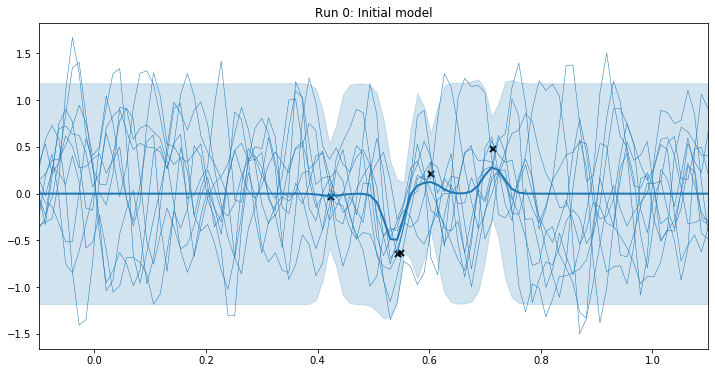

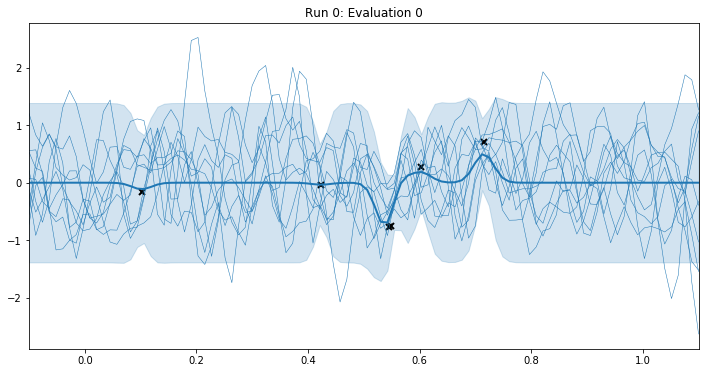

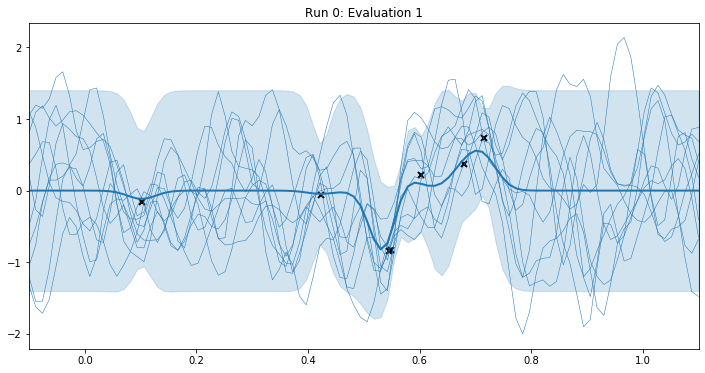

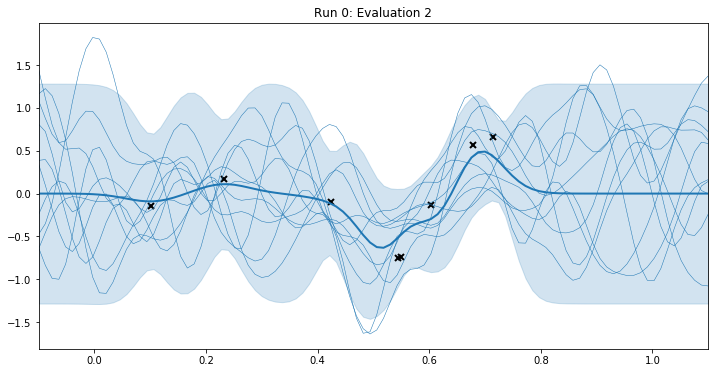

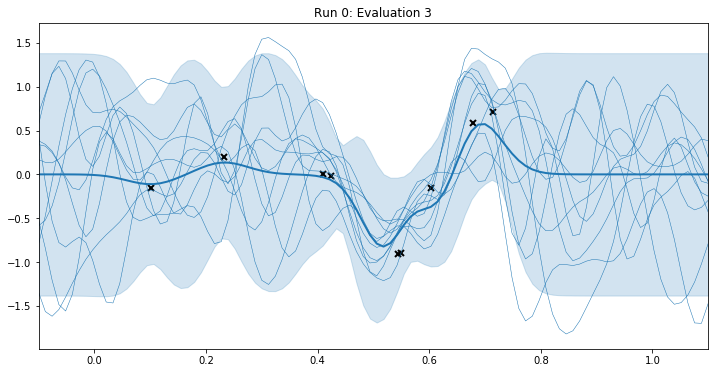

...

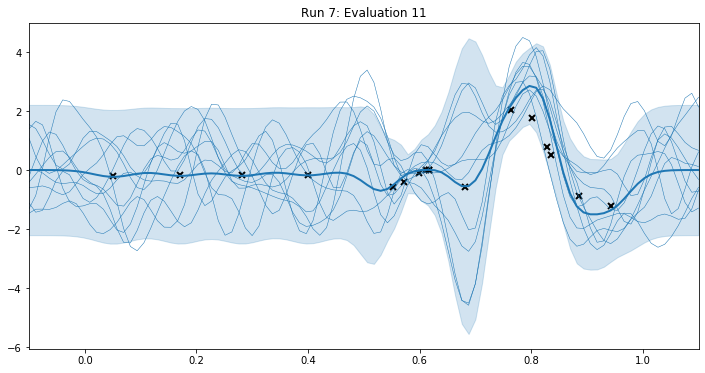

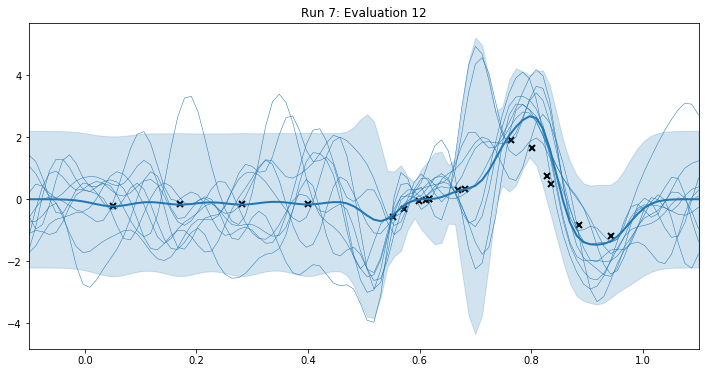

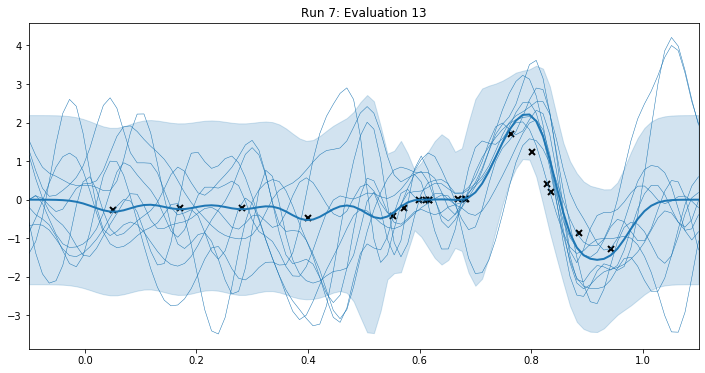

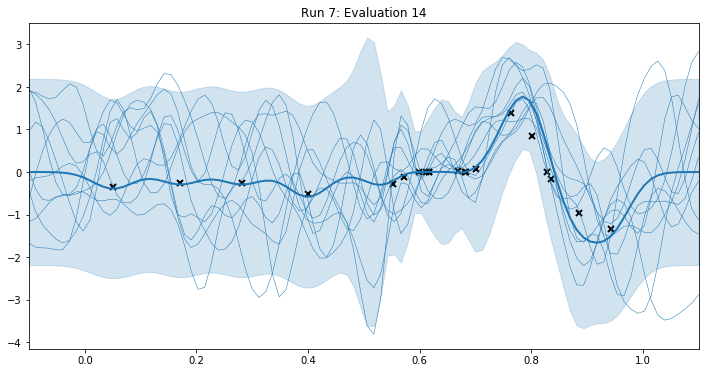

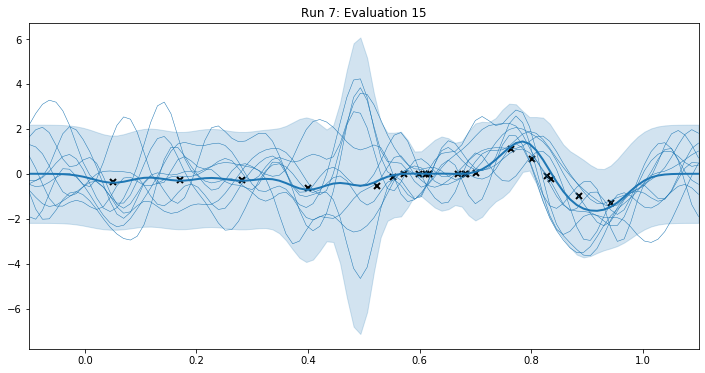

In [18]:
for run in range(num_runs):
    print("Beginning run %s" % (run))
    
    X = init_vals[run]
    y = forrester_get_y(X)
    
    model, inputs, func_evals = train_and_visualize(X, y, "Run {}: Initial model".format(run))

    for evaluation in range(num_evals):
        print("Beginning evaluation %s" % (evaluation)) 

        # Sample possible next queries
        
        samples = PBO.acquisitions.pes.sample_inputs(inputs, num_samples, num_choices)

        # Sample maximizers
        print("Evaluation %s: Sampling maximizers" % (evaluation))
        maximizers = PBO.acquisitions.pes.sample_maximizers_simple(model=model,
                                                                   count=num_maximizers,
                                                                   num_discrete_points=num_discrete_points)
        print(maximizers)

        # Calculate PES value I for each possible next query
        print("Evaluation %s: Calculating I" % (evaluation))
        I_vals = PBO.acquisitions.pes.I_batch(samples, maximizers, model)

        # Select query that maximizes I
        next_idx = np.argmax(I_vals)
        next_query = samples[next_idx]
        print("Evaluation %s: Next query is %s with I value of %s" % (evaluation, next_query, I_vals[next_idx]))

        X = np.concatenate([X, [next_query]])
        # Evaluate objective function
        y = forrester_get_y(X)
        
        print("Evaluation %s: Training model" % (evaluation))
        model, inputs, func_evals = train_and_visualize(X, y, "Run {}: Evaluation {}".format(run, evaluation))

        best_guess_results[run, evaluation, :] = best_guess(model)

    X_results[run] = X
    y_results[run] = y

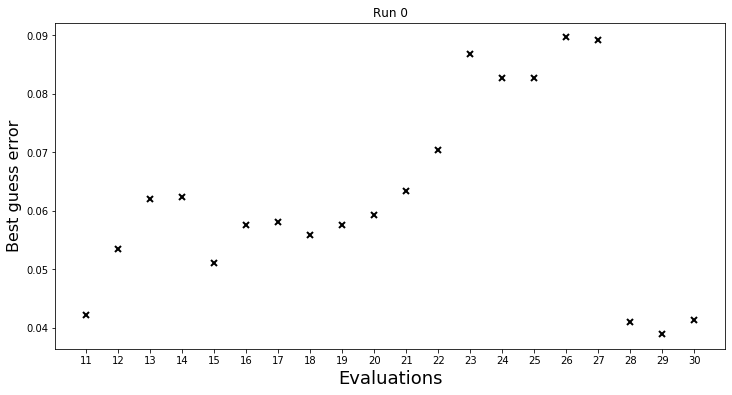

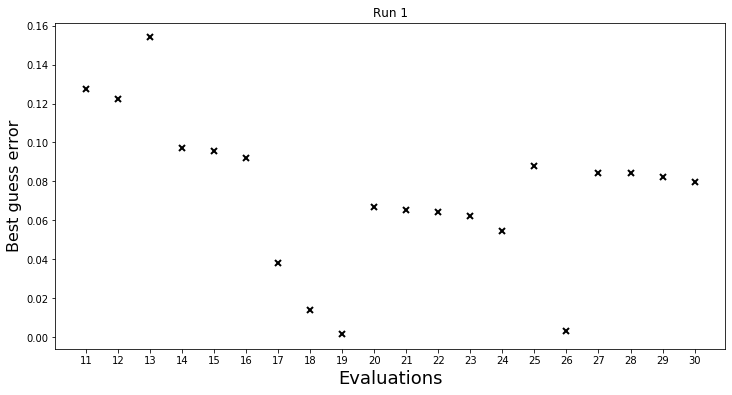

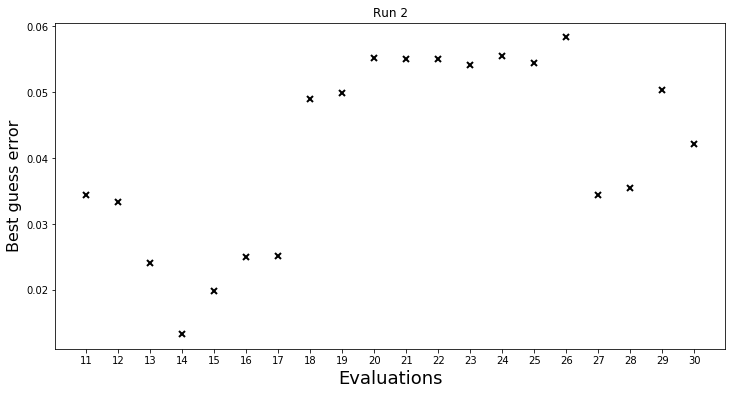

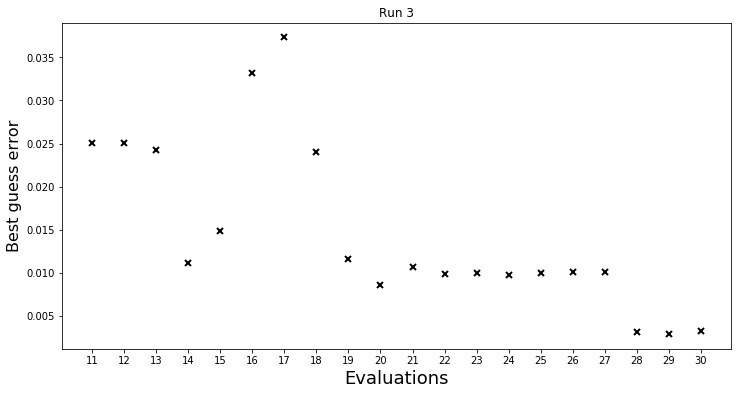

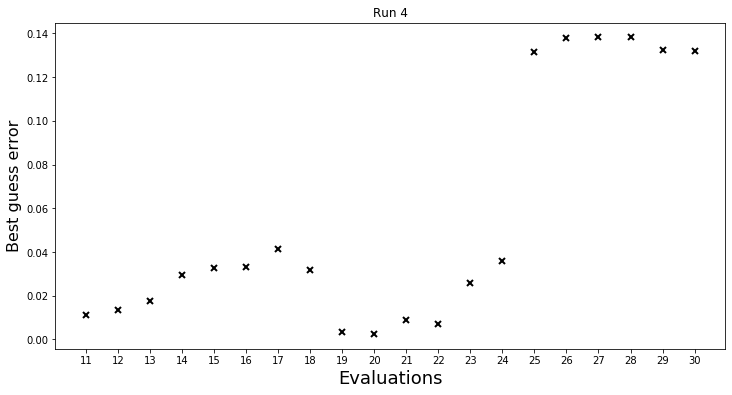

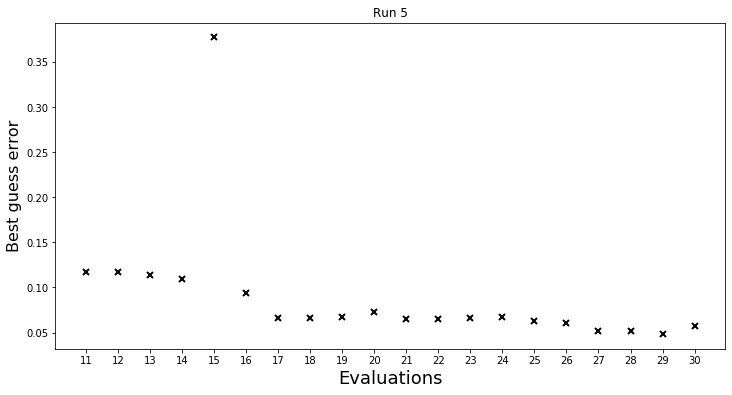

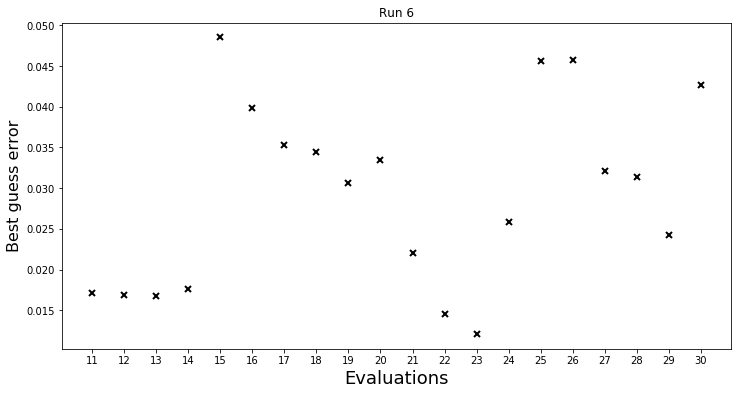

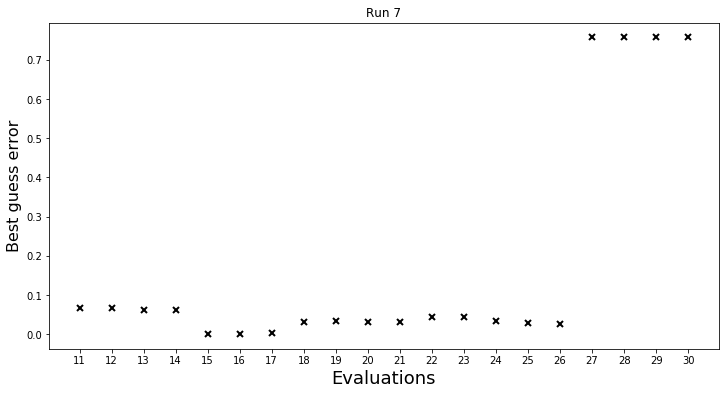

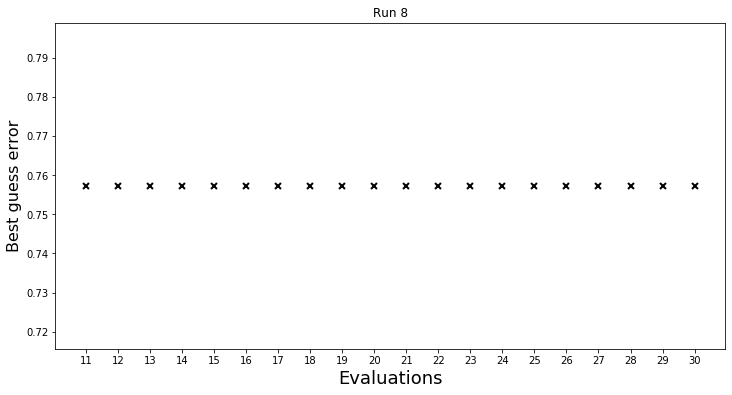

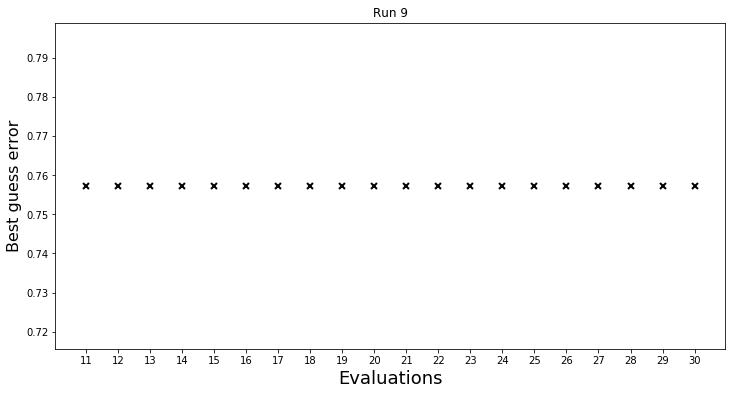

In [19]:
xx = np.linspace(0.0, 1.0, num_discrete_points).reshape(num_discrete_points, 1)
global_min = xx[np.argmin(forrester(xx))][0]

for i in range(best_guess_results.shape[0]):
    diff_from_min = abs(best_guess_results[i] - global_min)
    
    x_axis = list(range(11, 31))
    plt.figure(figsize=(12, 6))
    plt.plot(x_axis, diff_from_min, 'kx', mew=2)
    plt.xticks(x_axis)
    plt.xlabel('Evaluations', fontsize=18)
    plt.ylabel('Best guess error', fontsize=16)
    plt.title("Run %s" % i)
    plt.show()